# This script is organized as the following:
1. Data cleaning
  1. Format 'date' column to proper format
  2. Fill in missing dates
  3. Forward fill the missing sales values
2. Data exploration
  1. Line plot
  2. Box plot
  3. Seasonal decomposition plot
3. Statistical testing
  1. Stationary tests(obs)
  2. Log(obs)
    * Line plot
    * Stationary test
  3. Diff(obs)
    * Stationary test
  4. Diff(Log())
    * Stationary test
  5. Seasonal(obs)
    * Stationary test
  6. Seasonal(log)
    * Stationary test
  7. Seasonal(diff())
    * Stationary test
  8. Seasonal(diff(log))
    * Stationary test
4. Model building
  1. Seasonal(obs)
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
  2. Seasonal(log)
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
  3. Seasonal(diff(obs))
    1. ACF/PACF plots
    2. Model grid search
    3. Residual diagonostic plots
5. Forecasting
  1. Seasonal(obs)
  2. Seasonal(log)
  3. Seasonal(diff(obs))

#### NOTE: If you want to quickly see the overview, just go to the end and read the summary

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
import matplotlib.gridspec as gridspec
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

# Step 1) Data cleaning
### 1.1) Format 'date' column to proper format
### 1.2) Fill in missing dates, i.e. category L only has half of the dates
### 1.3) Fill the missing sales values with 0 - assume 0 sales for that day due to holiday
#### - Note: we are going to forecast 90 days ahead, so our basic unit is day not hours. So we will group the data into daily sales

In [2]:
np.random.seed(42)
data = pd.read_csv('../data/siteB.csv')

In [3]:
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [4]:
data.head()

,Date_Name,subCategory,Purchase_Hour,sales
0,2016-01-21,A,11,5.14
1,2016-06-15,A,11,8.07
2,2016-07-06,A,11,7.89
3,2016-07-27,A,11,5.69
4,2016-08-08,A,11,5.38


In [4]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78587 entries, 0 to 78586
Data columns (total 4 columns):
Date_Name        78587 non-null datetime64[ns]
subCategory      78587 non-null object
Purchase_Hour    78587 non-null int64
sales            78587 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.4+ MB
None


In [5]:
# Make a dataframe for each category, and put it into a list...len(list) = 16
# Essentially becomes a list of dataframe

def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

temp_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print len(splitted_data)
print splitted_data[2][0:5]

15
       Date_Name subCategory  Purchase_Hour  sales
11887 2015-12-17           C              8  65.85
11888 2015-12-15           C              9  94.72
11889 2015-12-15           C             12   1.69
11890 2015-12-18           C             12   7.27
11891 2015-12-15           C             14   3.38


In [6]:
# Looks like some have missing dates, like category L has only half of the dates.

idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    
    # We fill in the missing dates with value 0. Because this may be holiday and the shop made 0 sales.
    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, fill_value=0)
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

print '\n', splitted_data[0].head()

A : (365,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
B : (365,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
C : (364,)
C : (371,) - DatetimeIndex(['2015-09-26',

In [7]:
# Check for both zero values and NA values.

print 'Zeros: ', map(lambda df: df[df==0].shape, splitted_data)
print 'NAs: ', map(lambda df: df.isnull().values.sum(), splitted_data)

Zeros:  [(6,), (6,), (7,), (187,), (7,), (6,), (6,), (6,), (6,), (6,), (29,), (6,), (6,), (6,), (89,)]
NAs:  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


# Step 2) Data exploratory
### - We observe shop has no sales during Xmas season, Dec end~Jan beginning
### - Low sales volume during summer, May~Sep
### - Weekly seasonal effect: weekend usually lower sales volume than weekday
### - Category M has some anomalies in the summer
### - Category L are only sold half of the time in the whole year
### - Maybe it's a shop in a college cafeteria? Low student volume during the weekend, Xmas, & summer.

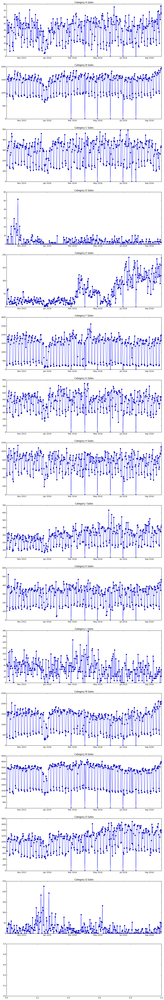

In [8]:
# Time series in connected point plot format for each category.
# We can see the missing dates(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(16,1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(data['subCategory'].unique()):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))

# Boxplots tell us: large value span from 50%~75% percentile.
## * 50% of the observations are below a small dollar value, 
## * while 75% of the observations are below a large dollar value

In [11]:
print len(temp_list)

15


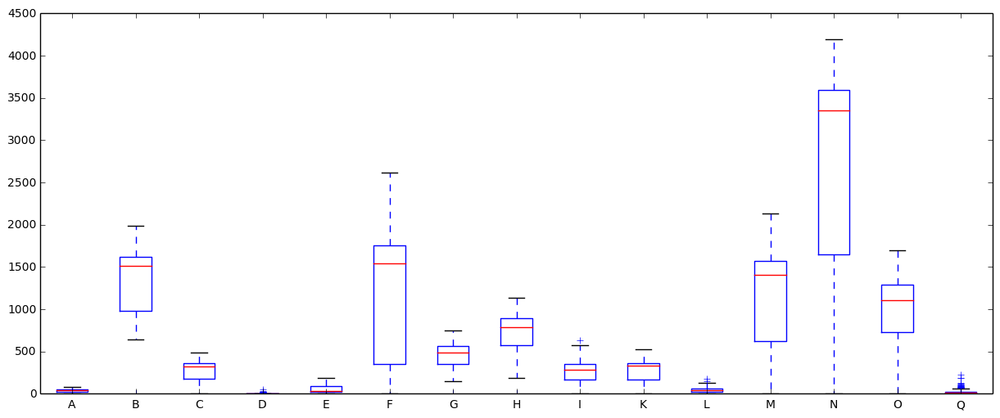

In [12]:
_ = plt.boxplot(splitted_data)
_ = plt.xticks(range(1, 16), temp_list)

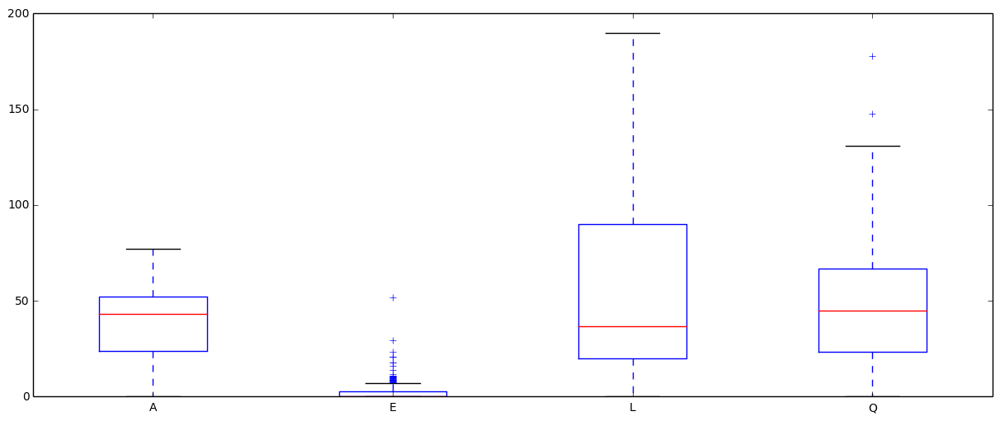

In [13]:
_ = plt.boxplot([splitted_data[0], splitted_data[3], splitted_data[4], splitted_data[10]])
_ = plt.xticks(range(1, 5), ['A', 'E', 'L', 'Q'])

# Histogram: 2 mountains. One is weekday sales, one is weekend sales. 
## * No sales in between the mountains.
## * Zero sales account for a good amount, so how we fill the missing values matter.

IndexError: list index out of range

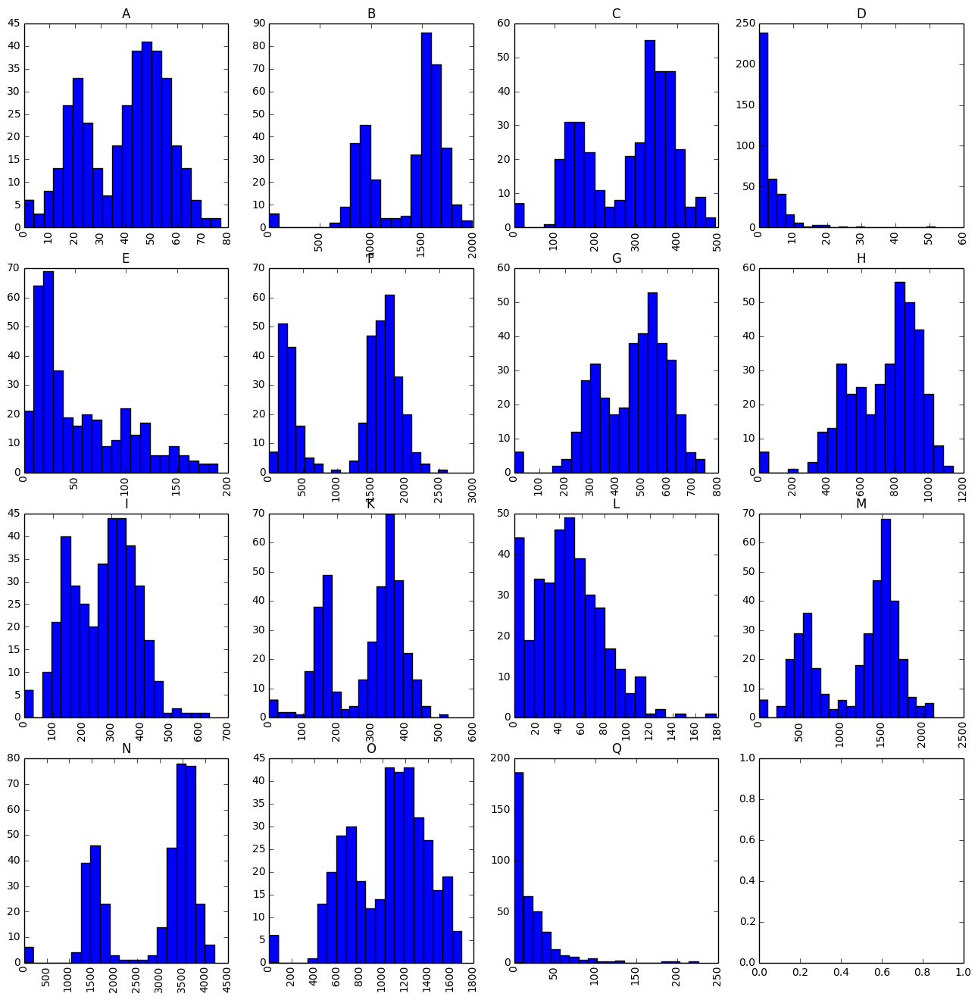

In [15]:
plt.rcParams["figure.figsize"] = (16,16)
gs = gridspec.GridSpec(4, 4)

sub = 0
for row in range(4):
    for col in range(4):
        if sub >= 16:
            break
        ax = plt.subplot(gs[row, col])
        ax = plt.hist(splitted_data[sub], bins=20)
        ax = plt.title(temp_list[sub])
        ax = plt.xticks(rotation='vertical')
        sub = sub + 1
plt.tight_layout()
plt.show()

# Seasonal decomposition plots tell us: 
## * seasonality exists, 
## * not much trend, 
## * residual plot is not white noise.

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/pyplot.py:412: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_num_figures`).
  max_open_warning, RuntimeWarning)


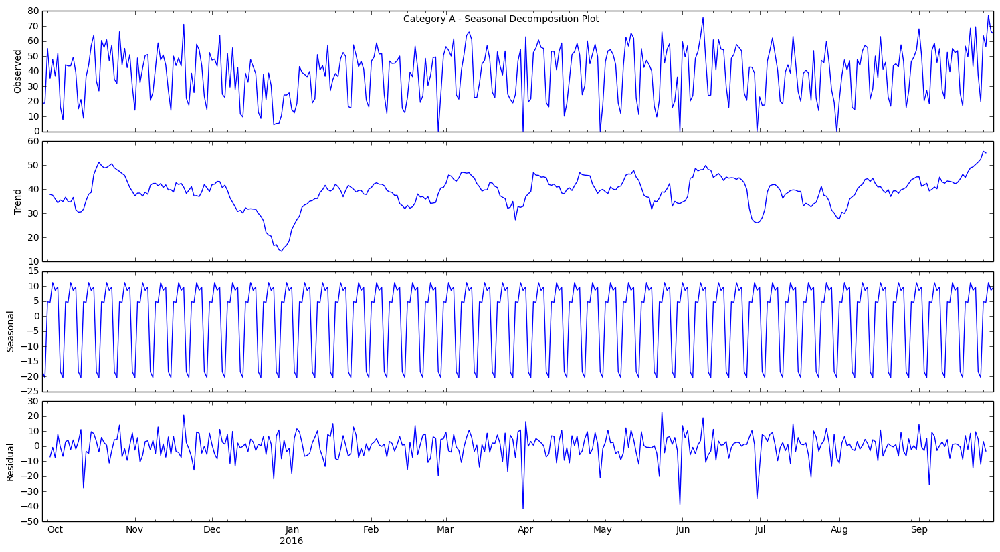

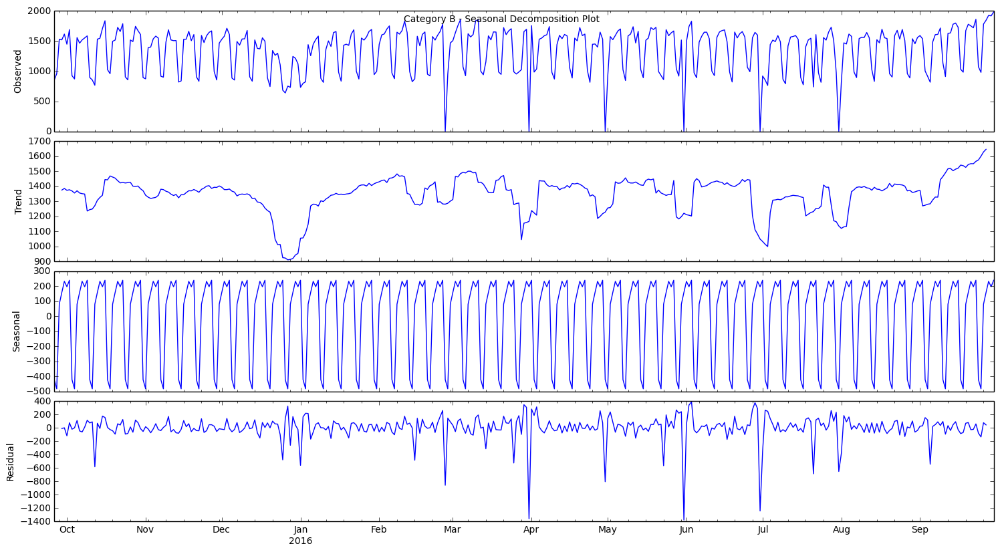

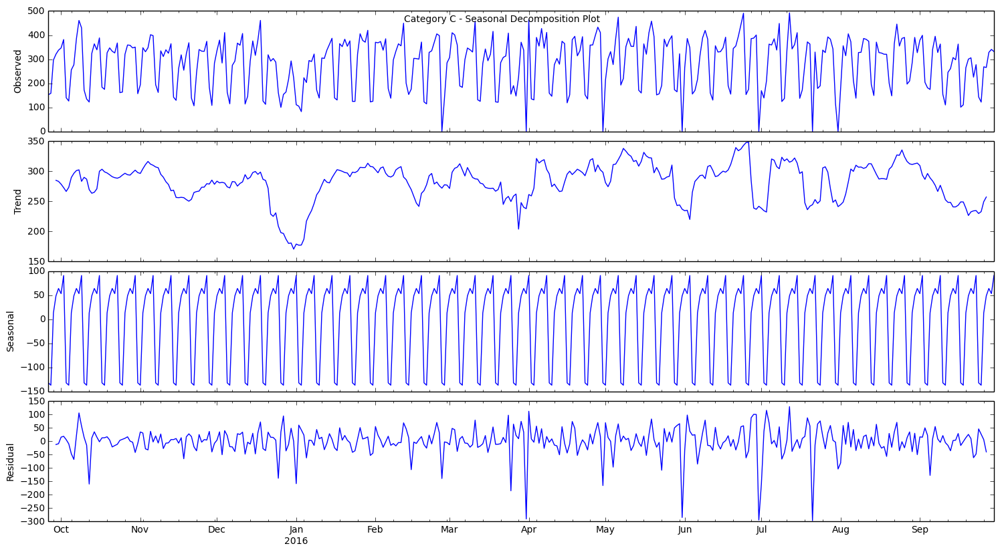

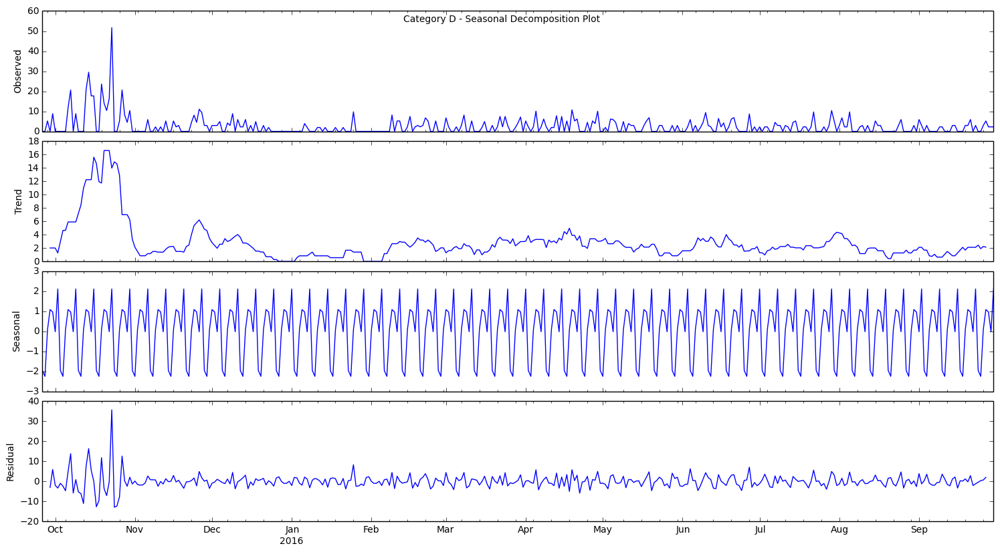

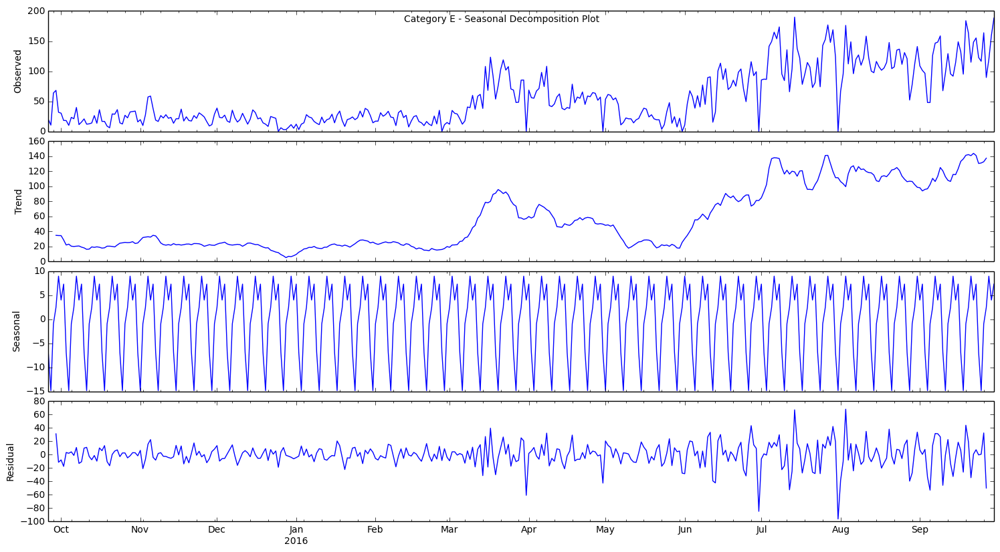

...

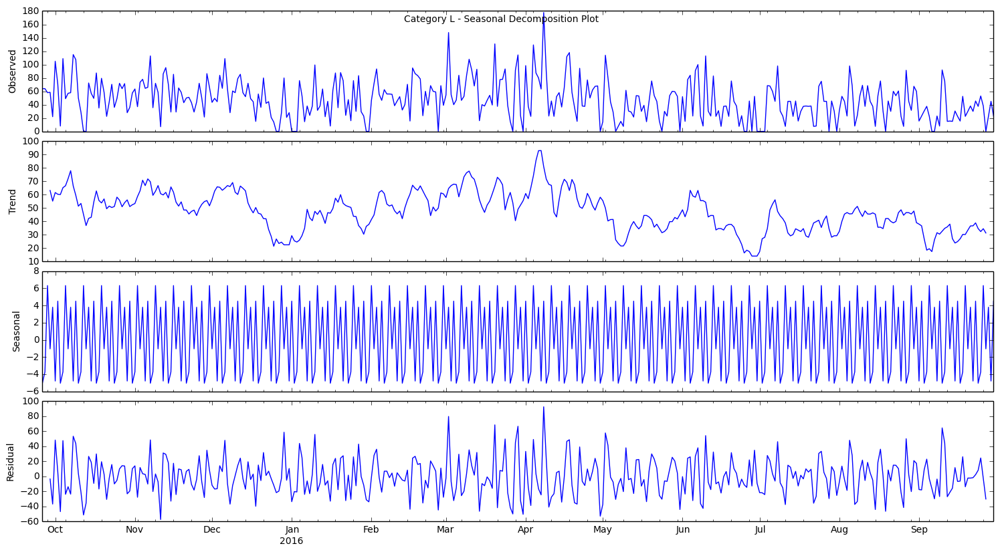

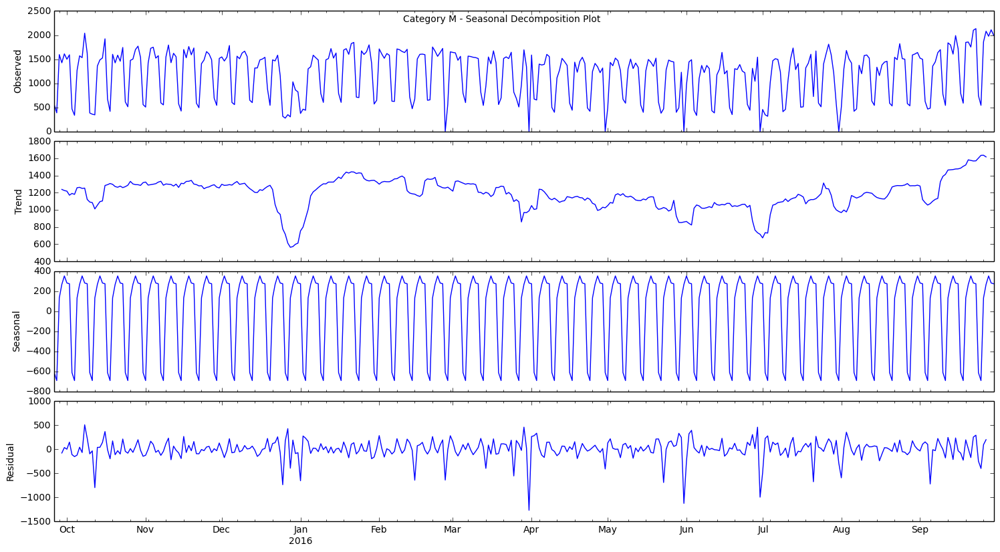

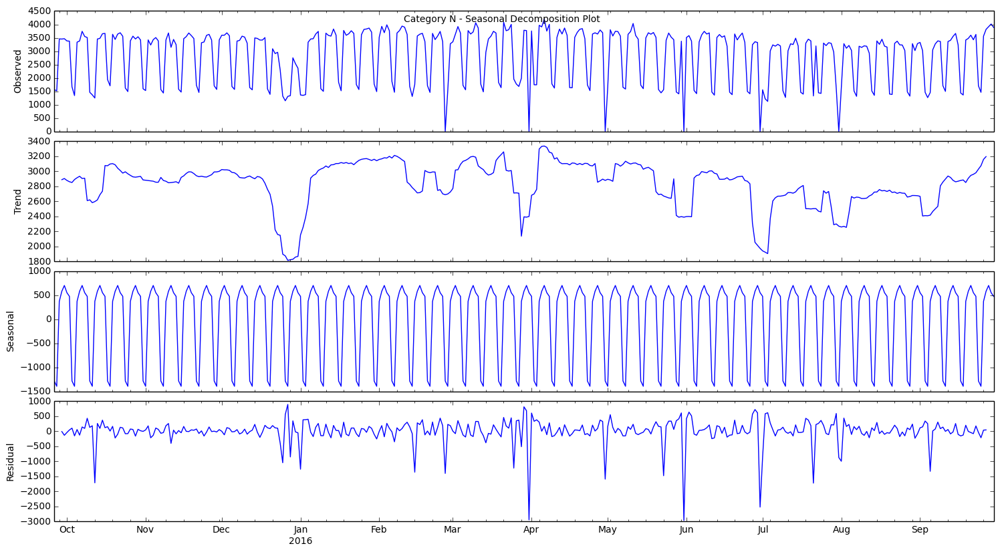

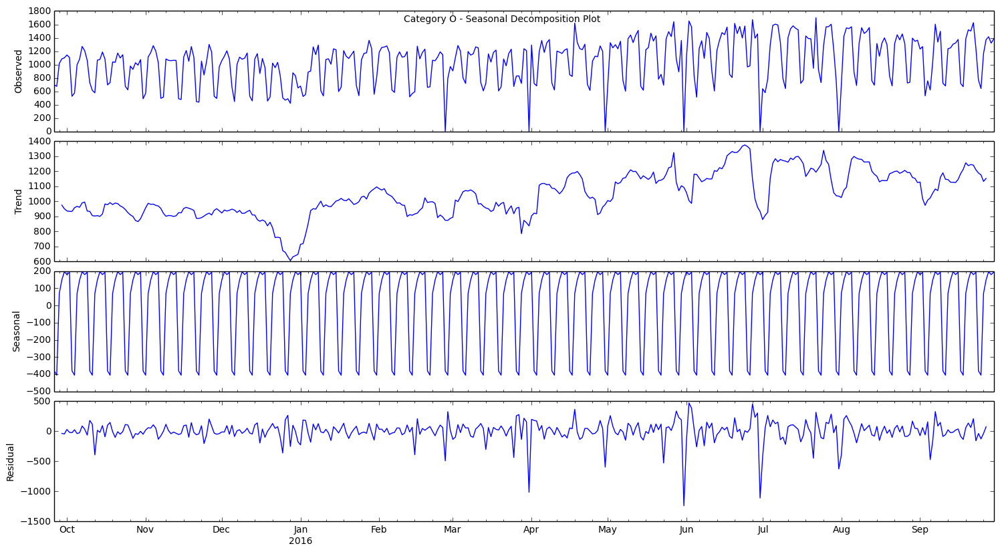

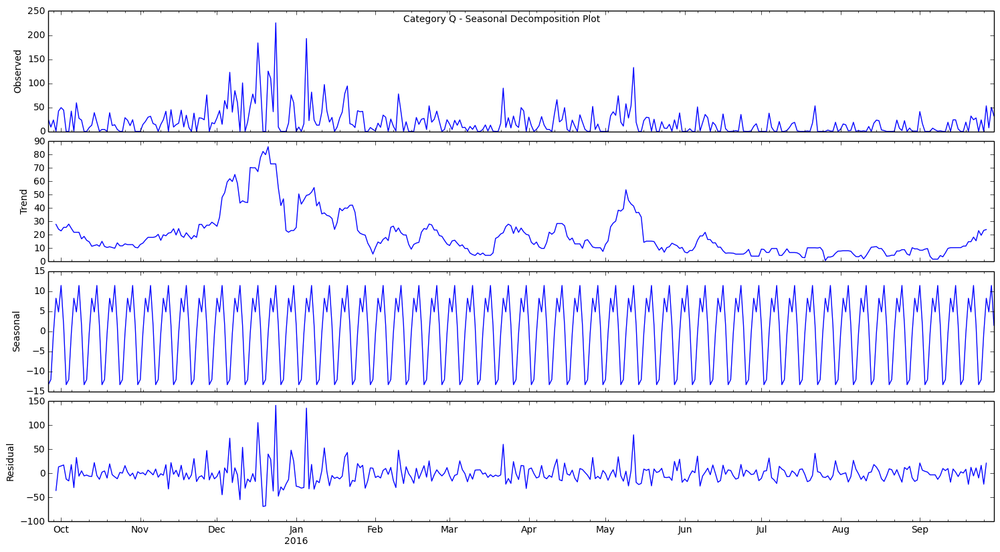

In [16]:
# Seasonal decomposition plots. Let's confirm the weekly seasonality.

def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

_ = map(decomposition, splitted_data, temp_list)

# Step 3) Statistical Testing
* Stationary tests(obs)
* Log(obs)
    * Line plot
    * Stationary test
* Diff(obs)
    * Stationary test
* Diff(Log())
    * Stationary test
* Seasonal(obs)
    * Stationary test
* Seasonal(log)
    * Stationary test
* Seasonal(diff())
    * Stationary test
* Seasonal(diff(log))
    * Stationary test

# Setup Stationarity Test Functions

In [17]:
# We will use Dickey-Fuller Test to check the stationarity of our time series data.
plt.rcParams["figure.figsize"] = (16,6)

def test_stationarity(timeseries, item):
    
    # Determing rolling statistics
    rol_mean = pd.rolling_mean(timeseries, window=12)
    rol_std = pd.rolling_std(timeseries, window=12)

    # Plot rolling statistics:
    original = plt.plot(timeseries, color='blue',label='Original')
    mean_ = plt.plot(rol_mean, color='red', label='Rolling Mean')
    std_ = plt.plot(rol_std, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Category {} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    # Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    adf_test = adfuller(timeseries, autolag='AIC')
    adf_output = pd.Series(adf_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in adf_test[4].items():
        adf_output['Critical Value (%s)'%key] = value
    print adf_output

In [18]:
def test_statistic(timeseries):
    adf_test = adfuller(timeseries, autolag='AIC')
    return adf_test[0]

In [19]:
def test_statistic_five(timeseries):
    adf_test = adfuller(timeseries, autolag='AIC')
    return adf_test[4]['5%']

# 3.0) Stationary Test(obs)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


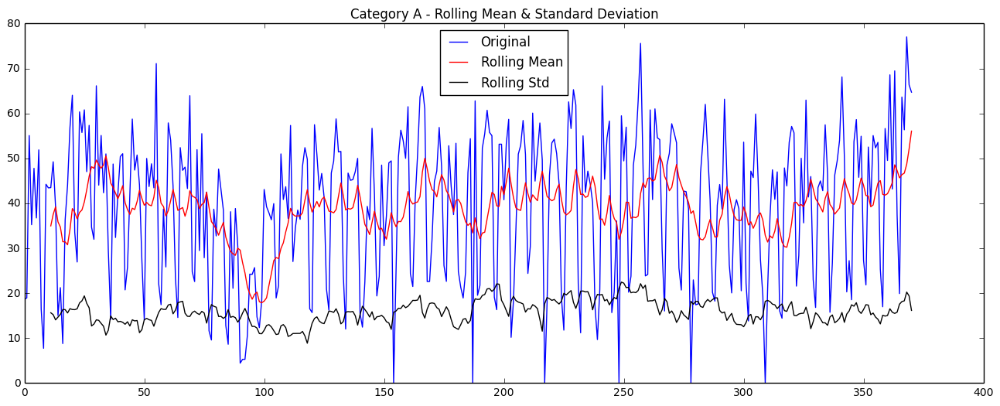

Results of Dickey-Fuller Test:
Test Statistic                  -3.623297
p-value                          0.005331
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


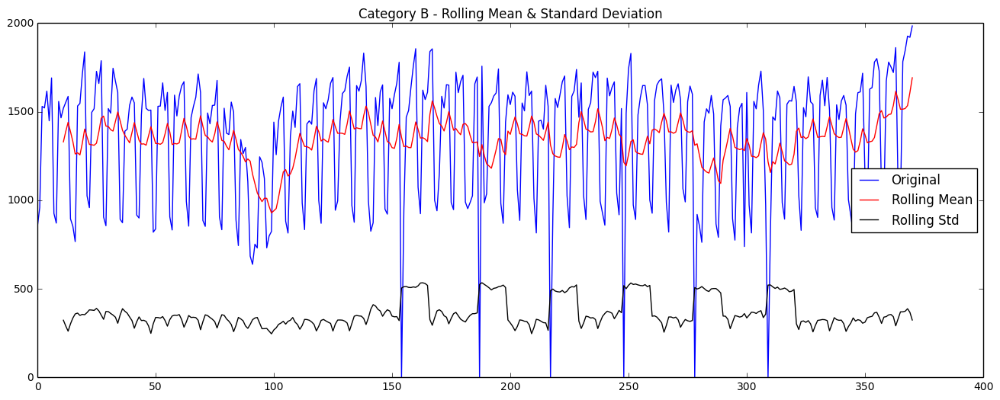

Results of Dickey-Fuller Test:
Test Statistic                  -3.194820
p-value                          0.020286
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


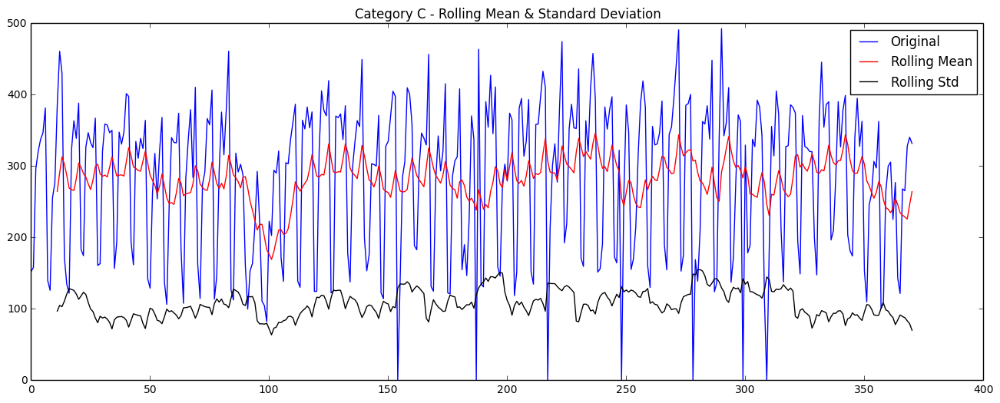

Results of Dickey-Fuller Test:
Test Statistic                  -4.457533
p-value                          0.000234
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


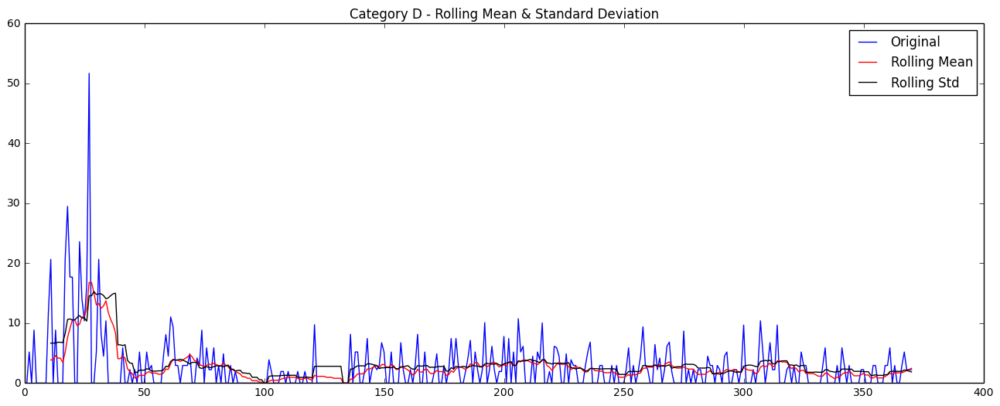

Results of Dickey-Fuller Test:
Test Statistic                  -3.789831
p-value                          0.003013
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


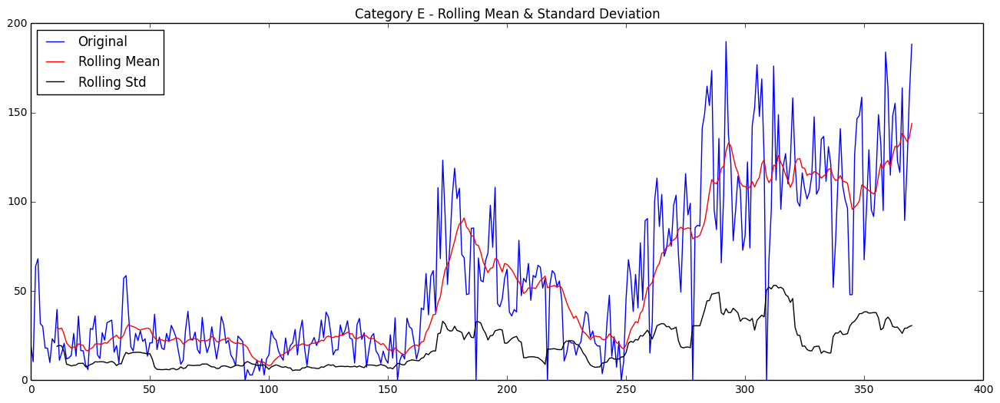

Results of Dickey-Fuller Test:
Test Statistic                  -0.251382
p-value                          0.932113
#Lags Used                      11.000000
Number of Observations Used    359.000000
Critical Value (5%)             -2.869625
Critical Value (1%)             -3.448697
Critical Value (10%)            -2.571077
dtype: float64


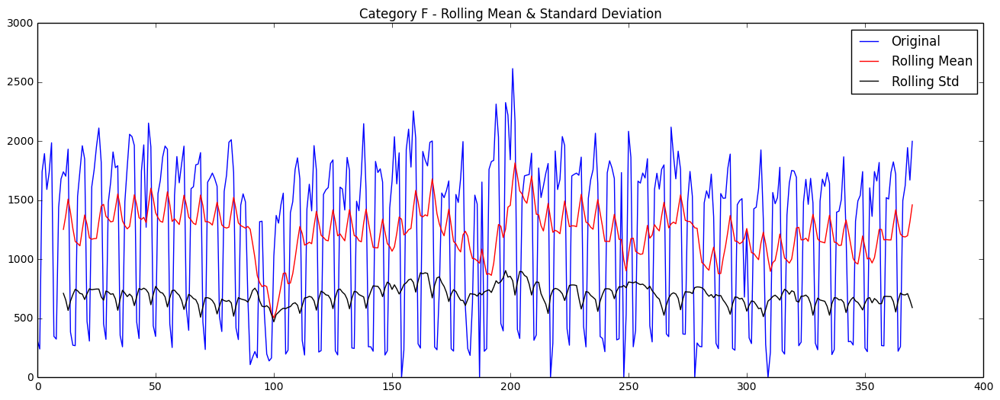

Results of Dickey-Fuller Test:
Test Statistic                  -4.211158
p-value                          0.000631
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


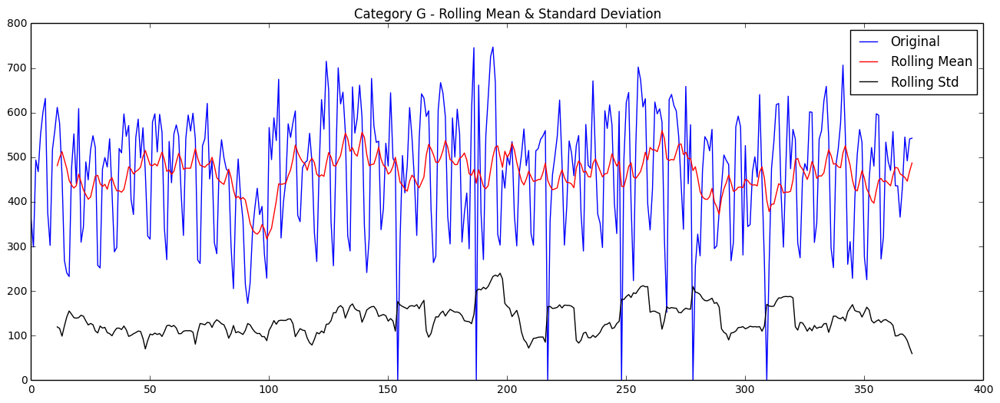

Results of Dickey-Fuller Test:
Test Statistic                  -4.073495
p-value                          0.001071
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


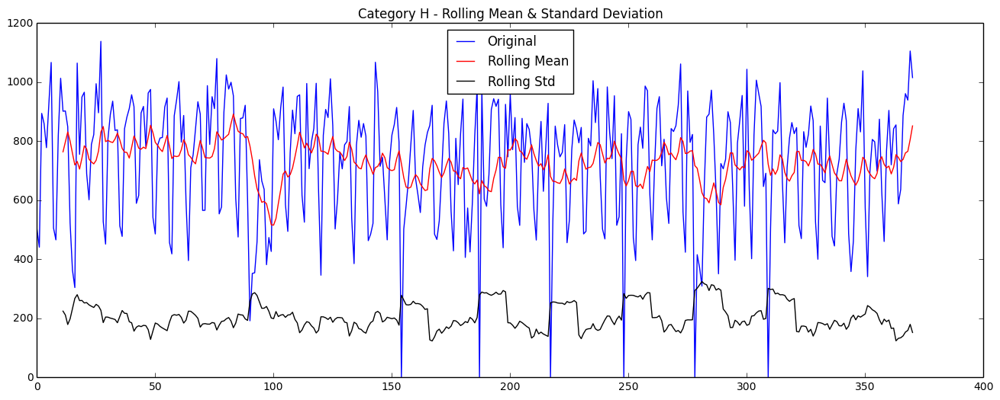

Results of Dickey-Fuller Test:
Test Statistic                  -4.746820
p-value                          0.000069
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


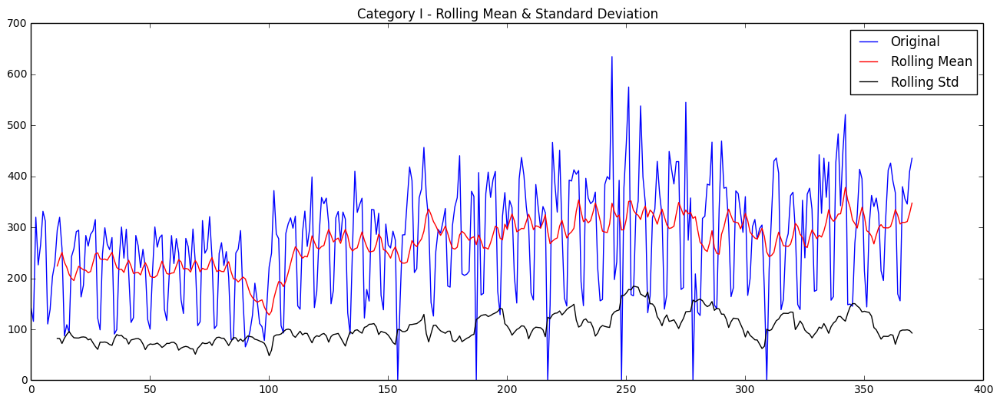

Results of Dickey-Fuller Test:
Test Statistic                  -2.007939
p-value                          0.283103
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


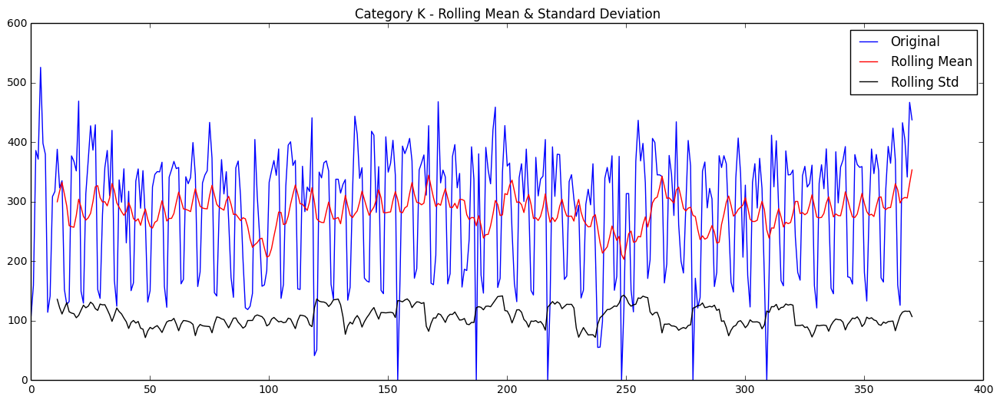

Results of Dickey-Fuller Test:
Test Statistic                  -4.908540
p-value                          0.000034
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


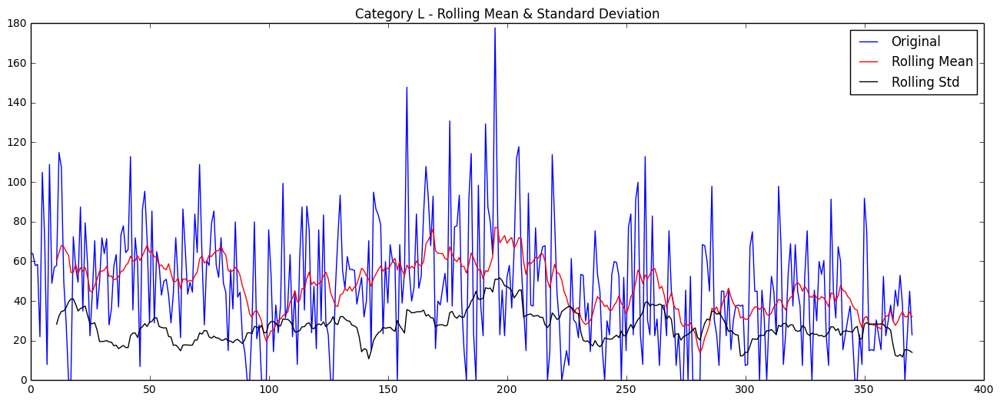

Results of Dickey-Fuller Test:
Test Statistic                  -4.866092
p-value                          0.000041
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


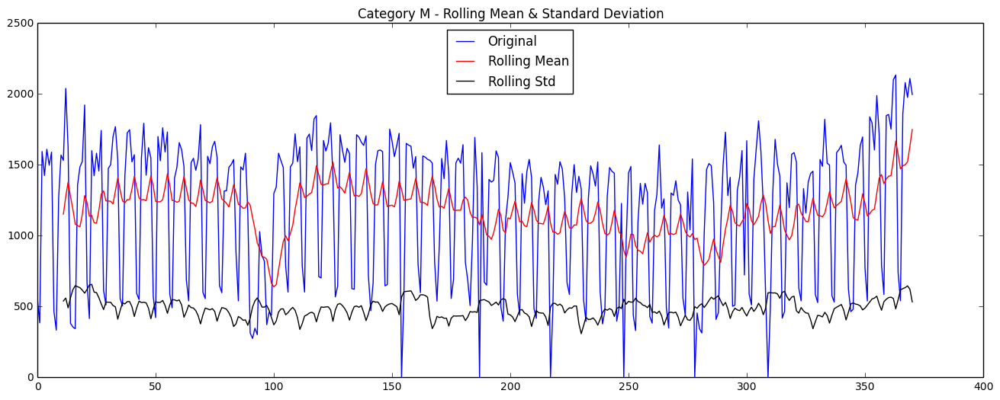

Results of Dickey-Fuller Test:
Test Statistic                  -2.444981
p-value                          0.129441
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


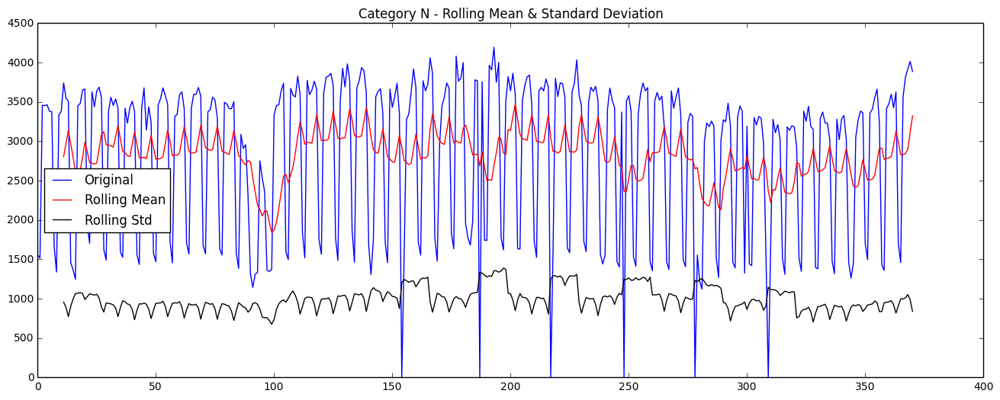

Results of Dickey-Fuller Test:
Test Statistic                  -3.980210
p-value                          0.001518
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


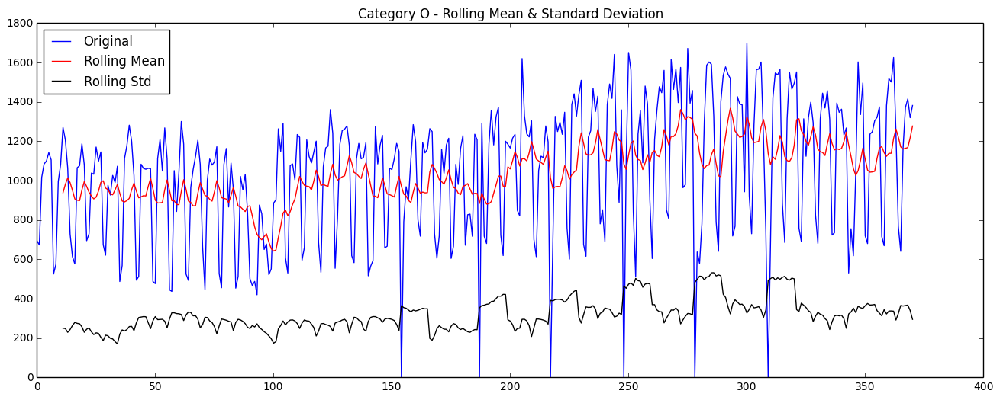

Results of Dickey-Fuller Test:
Test Statistic                  -2.040730
p-value                          0.269005
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


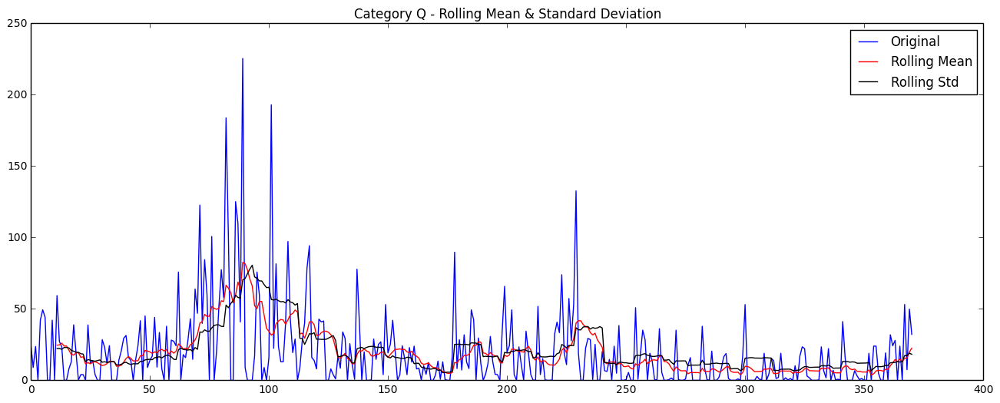

Results of Dickey-Fuller Test:
Test Statistic                  -3.195251
p-value                          0.020261
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


In [20]:
_ = map(test_stationarity, splitted_data, temp_list)

In [21]:
observed_test_stat = map(test_statistic, splitted_data)
observed_test_five = map(test_statistic_five, splitted_data)
count=0
for test, five in zip(observed_test_stat, observed_test_five):
    print temp_list[count], '|', 'Test:', test, '| 5%:', five, '| Difference: ', test-five
    count = count + 1

A | Test: -3.62329712489 | 5%: -2.86971618162 | Difference:  -0.75358094327
B | Test: -3.19482047841 | 5%: -2.86971618162 | Difference:  -0.325104296791
C | Test: -4.45753318442 | 5%: -2.86973937843 | Difference:  -1.58779380599
D | Test: -3.78983145054 | 5%: -2.86960213906 | Difference:  -0.920229311485
E | Test: -0.251382110098 | 5%: -2.86962469233 | Difference:  2.61824258223
F | Test: -4.21115812021 | 5%: -2.8696931157 | Difference:  -1.34146500451
G | Test: -4.07349476121 | 5%: -2.86971618162 | Difference:  -1.20377857959
H | Test: -4.74682019042 | 5%: -2.86971618162 | Difference:  -1.8771040088
I | Test: -2.00793866589 | 5%: -2.86967017958 | Difference:  0.861731513683
K | Test: -4.90853987374 | 5%: -2.86976270725 | Difference:  -2.03877716649
L | Test: -4.86609240389 | 5%: -2.86951317051 | Difference:  -1.99657923338
M | Test: -2.44498058202 | 5%: -2.8696931157 | Difference:  0.424712533681
N | Test: -3.98021022588 | 5%: -2.86973937843 | Difference:  -1.11047084745
O | Test: -2.

### We can see some categories have pretty good test statistics already.
### So some categories are not stationary...let's make them stationary!
#### 1) Inversed(obs)
#### 2) Seasonal(obs)
#### 3) Seasonal(Inversed())

In [22]:
# We will use this function repeatedly to make plots for -> Transformed Data vs. Original Data

def plot_data(original, trans_2, item, title, label_1, label_2):
#     original.plot(label='{}'.format(label_1))
    trans_2.plot(label='{}'.format(label_2))
    plt.legend(loc='best')
    plt.title('Category {} - {}'.format(item, title))
    plt.show(block=False)

# 3.1) Inverse sine it

In [23]:
def log_data(timeseries, item):
    return np.arcsinh(timeseries)

splitted_data_log = map(log_data, splitted_data, temp_list)
print splitted_data[0].head(), '\n', splitted_data_log[0].head()

2015-09-26    18.70
2015-09-27    18.95
2015-09-28    55.09
2015-09-29    35.25
2015-09-30    47.80
Freq: D, Name: sales, dtype: float64 
2015-09-26    3.622385
2015-09-27    3.635647
2015-09-28    4.702198
2015-09-29    4.255814
2015-09-30    4.560282
Freq: D, Name: sales, dtype: float64


In [24]:
# Check for both zero values and NA values.

for i, category in enumerate(temp_list):
    print category, 'zero:', splitted_data_log[i][splitted_data_log[i]==0].shape, \
    'NA:', splitted_data_log[i].isnull().values.sum()

A zero: (6,) NA: 0
B zero: (6,) NA: 0
C zero: (7,) NA: 0
D zero: (187,) NA: 0
E zero: (7,) NA: 0
F zero: (6,) NA: 0
G zero: (6,) NA: 0
H zero: (6,) NA: 0
I zero: (6,) NA: 0
K zero: (6,) NA: 0
L zero: (29,) NA: 0
M zero: (6,) NA: 0
N zero: (6,) NA: 0
O zero: (6,) NA: 0
Q zero: (89,) NA: 0


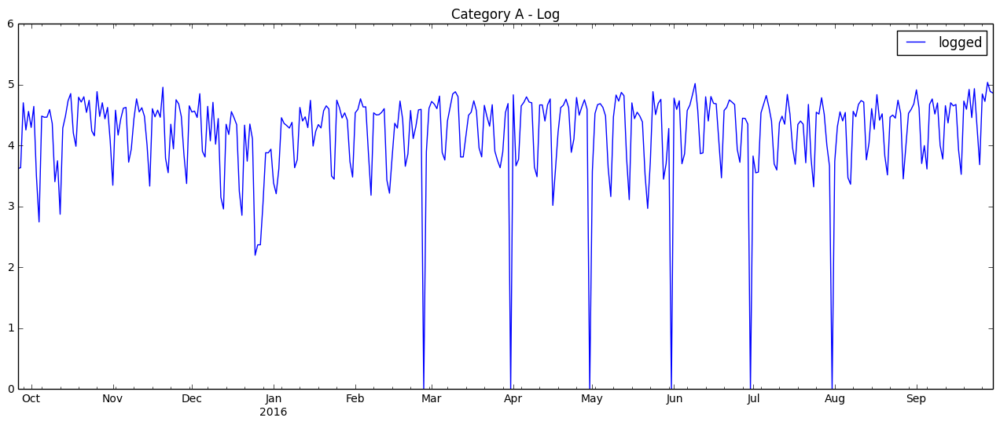

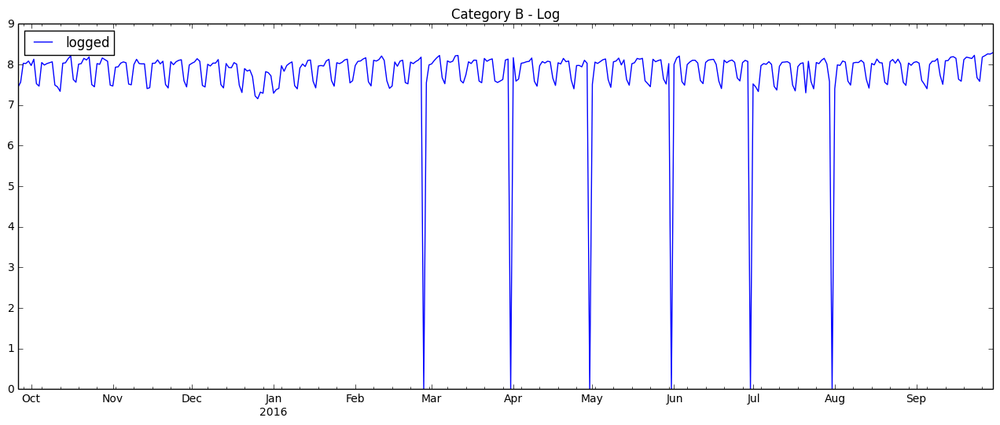

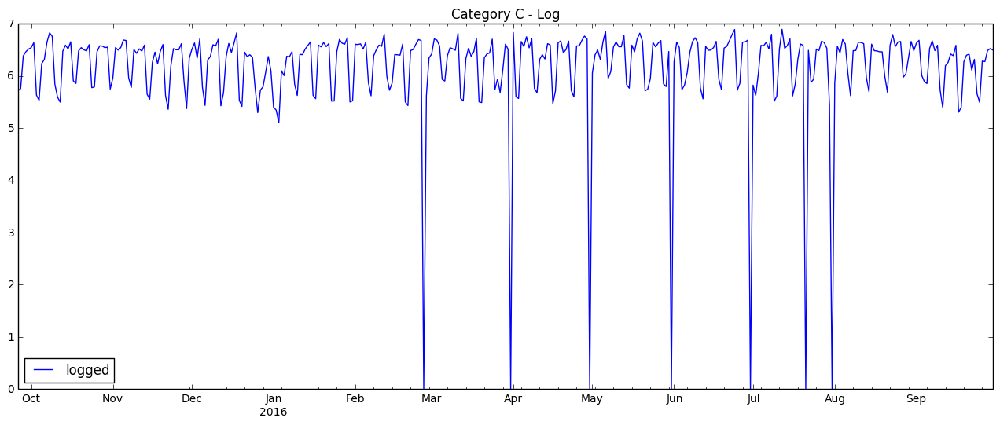

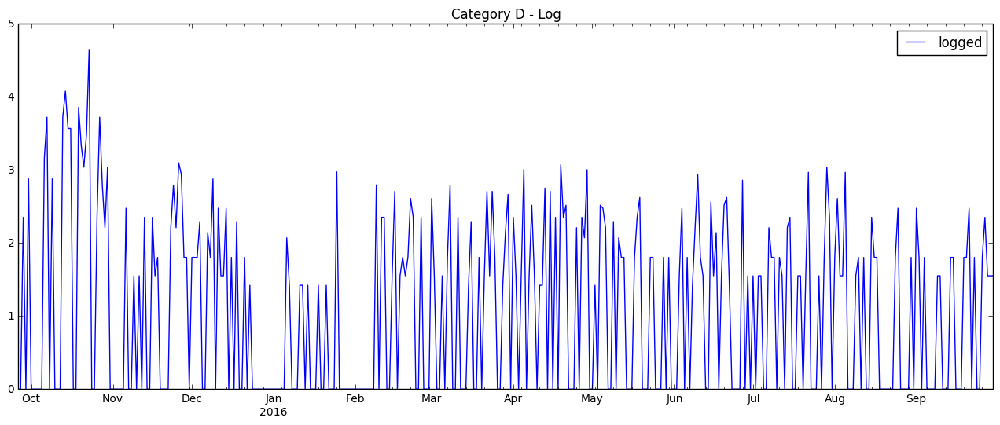

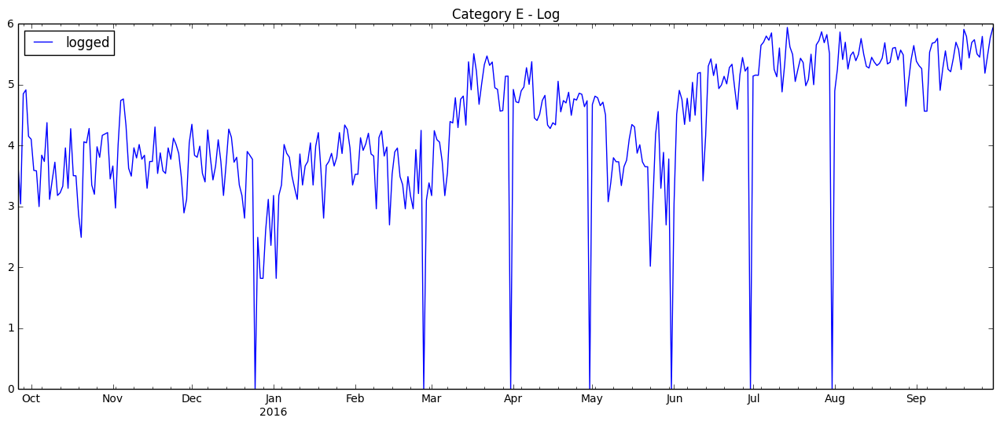

...

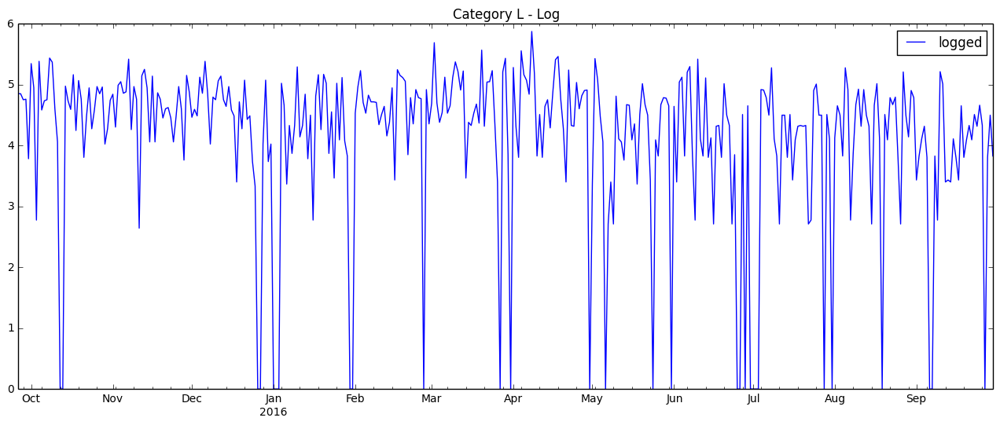

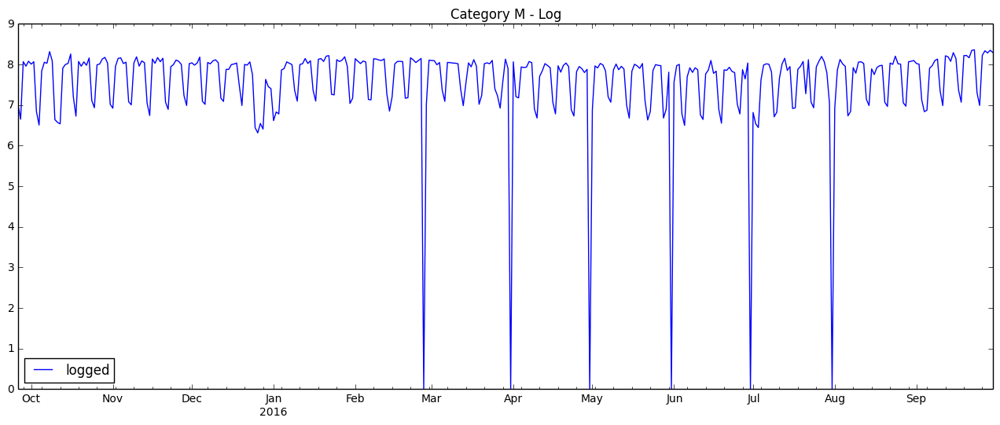

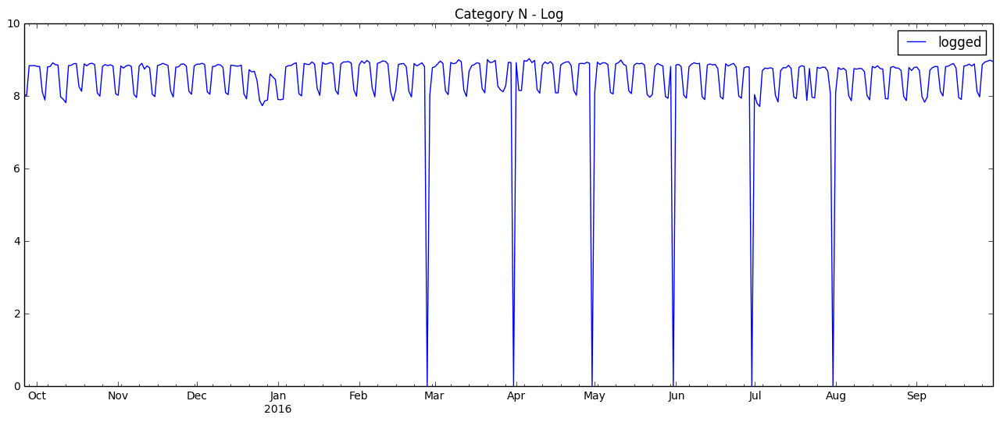

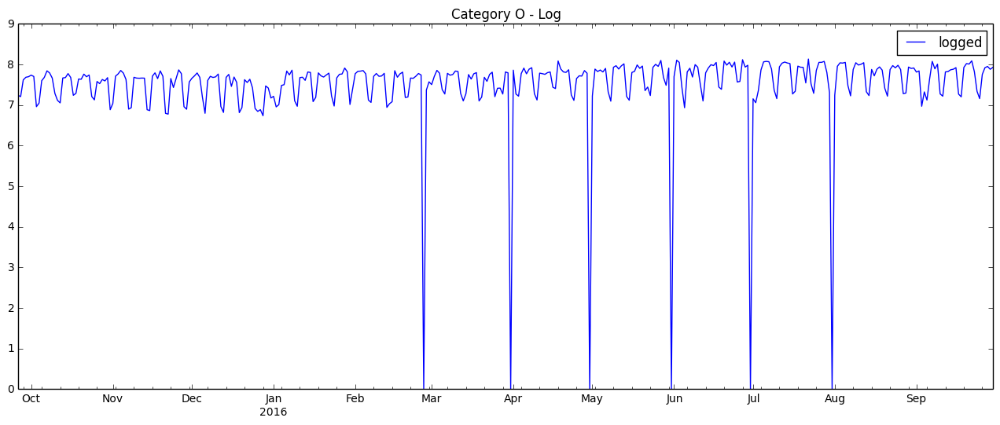

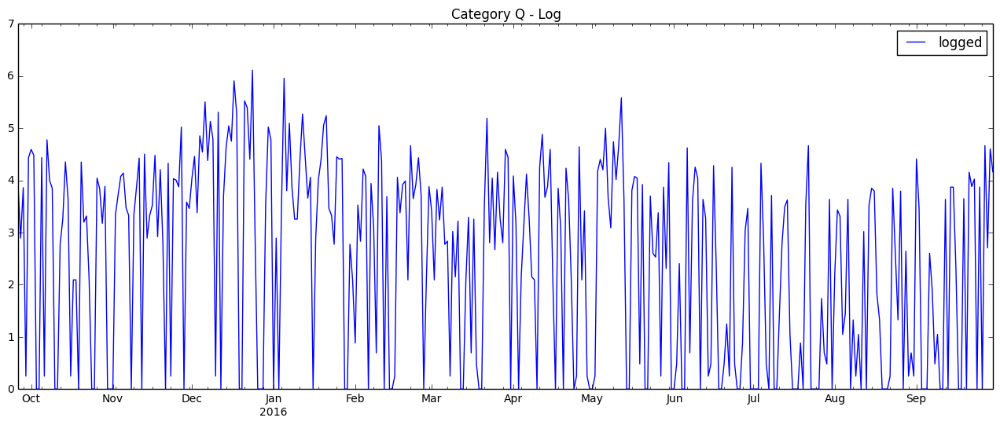

In [25]:
# Let's see the inverse sine plot.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, \
        ['Log']*len(temp_list), ['original']*len(temp_list), ['logged']*len(temp_list))

# Looks like we've made the variance quite even.

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


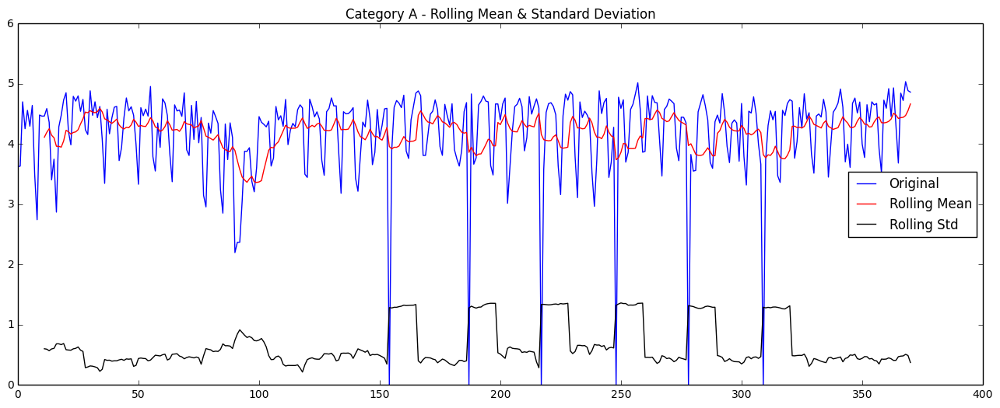

Results of Dickey-Fuller Test:
Test Statistic                  -4.064254
p-value                          0.001109
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


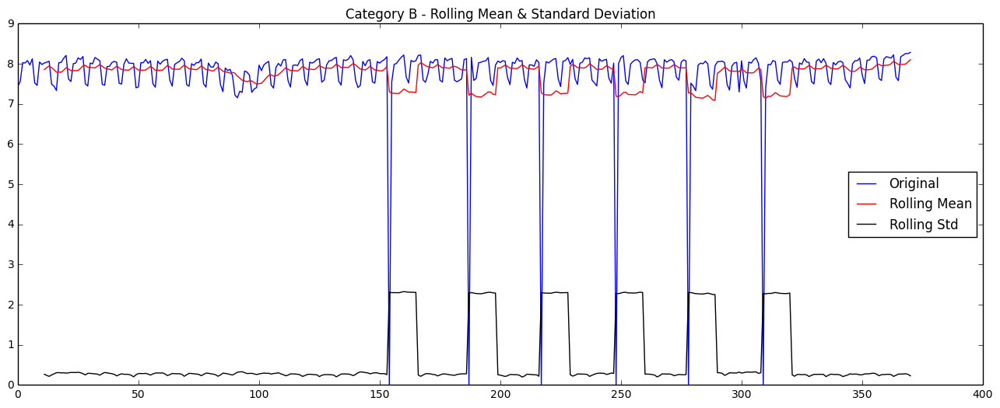

Results of Dickey-Fuller Test:
Test Statistic                -1.881054e+01
p-value                        2.022456e-30
#Lags Used                     0.000000e+00
Number of Observations Used    3.700000e+02
Critical Value (5%)           -2.869383e+00
Critical Value (1%)           -3.448148e+00
Critical Value (10%)          -2.570948e+00
dtype: float64


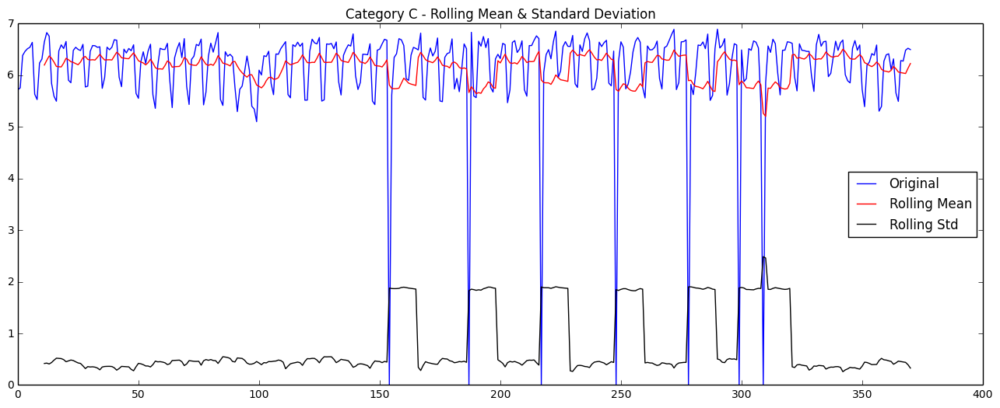

Results of Dickey-Fuller Test:
Test Statistic                -7.353101e+00
p-value                        9.940520e-11
#Lags Used                     6.000000e+00
Number of Observations Used    3.640000e+02
Critical Value (5%)           -2.869513e+00
Critical Value (1%)           -3.448443e+00
Critical Value (10%)          -2.571018e+00
dtype: float64


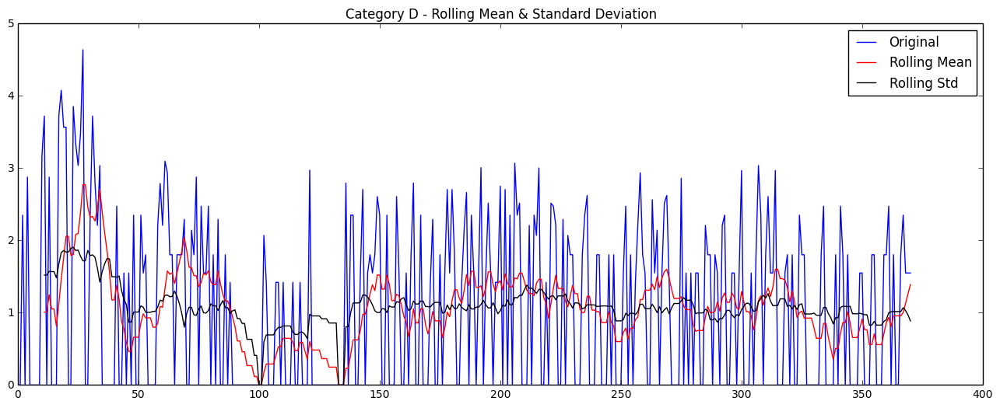

Results of Dickey-Fuller Test:
Test Statistic                  -3.783585
p-value                          0.003080
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


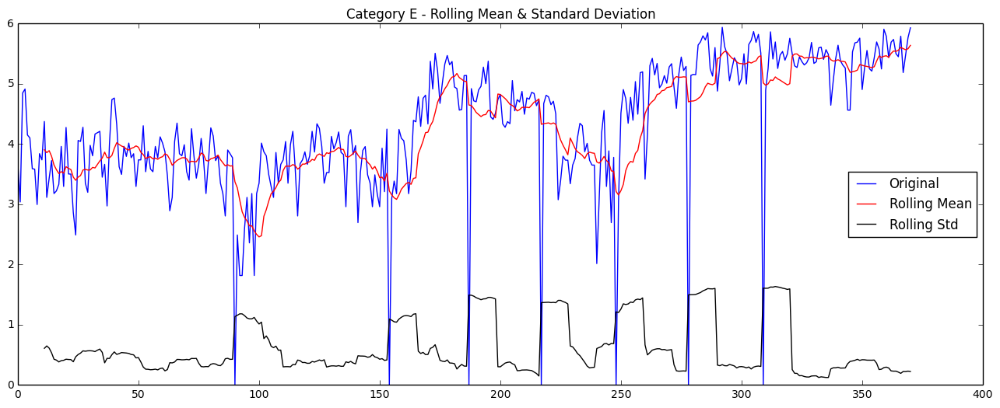

Results of Dickey-Fuller Test:
Test Statistic                  -2.009639
p-value                          0.282363
#Lags Used                       7.000000
Number of Observations Used    363.000000
Critical Value (5%)             -2.869535
Critical Value (1%)             -3.448494
Critical Value (10%)            -2.571029
dtype: float64


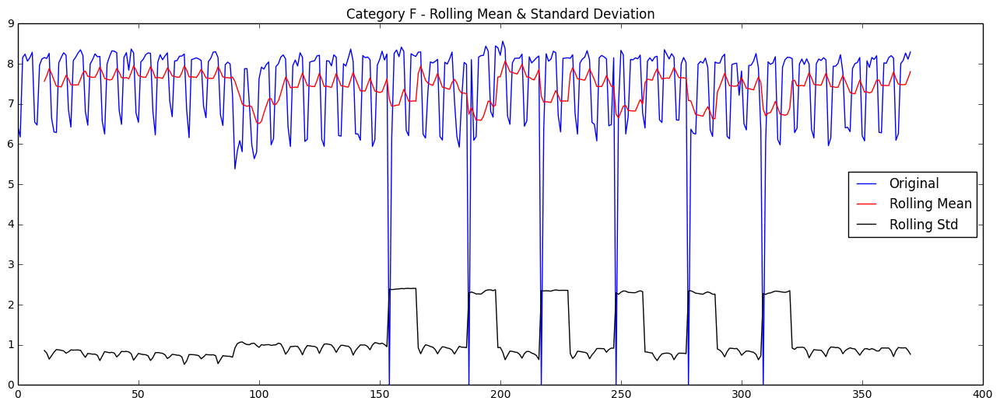

Results of Dickey-Fuller Test:
Test Statistic                  -4.802305
p-value                          0.000054
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


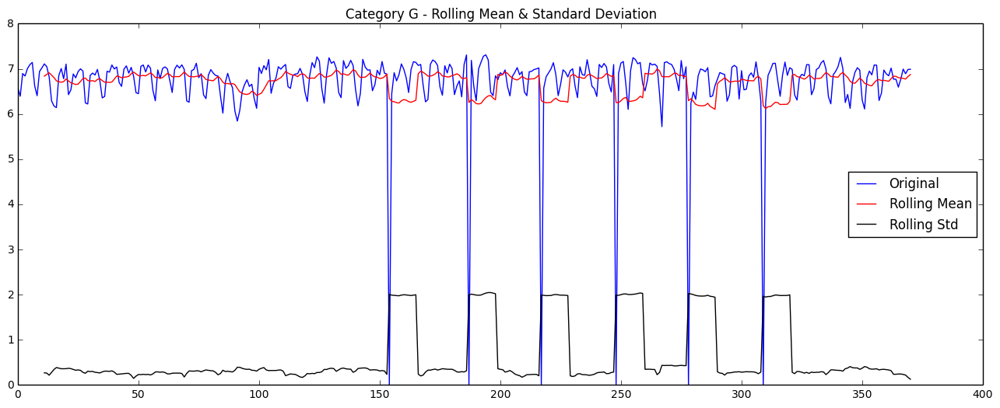

Results of Dickey-Fuller Test:
Test Statistic                -1.851162e+01
p-value                        2.114189e-30
#Lags Used                     0.000000e+00
Number of Observations Used    3.700000e+02
Critical Value (5%)           -2.869383e+00
Critical Value (1%)           -3.448148e+00
Critical Value (10%)          -2.570948e+00
dtype: float64


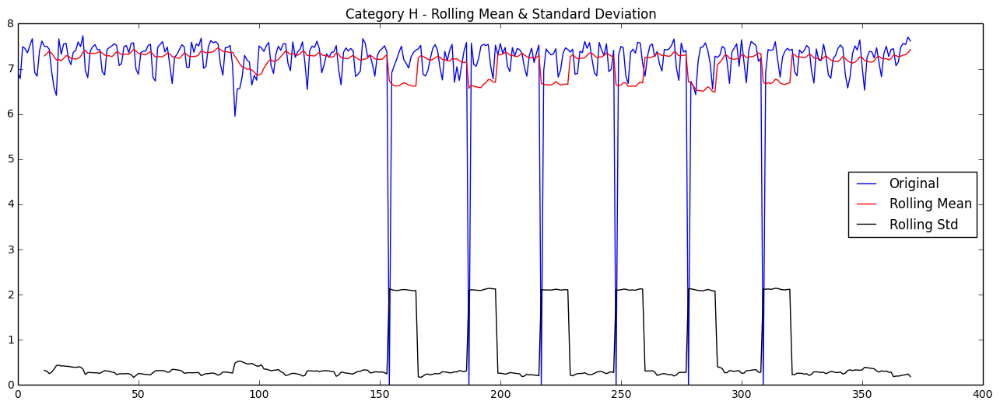

Results of Dickey-Fuller Test:
Test Statistic                -1.875883e+01
p-value                        2.026614e-30
#Lags Used                     0.000000e+00
Number of Observations Used    3.700000e+02
Critical Value (5%)           -2.869383e+00
Critical Value (1%)           -3.448148e+00
Critical Value (10%)          -2.570948e+00
dtype: float64


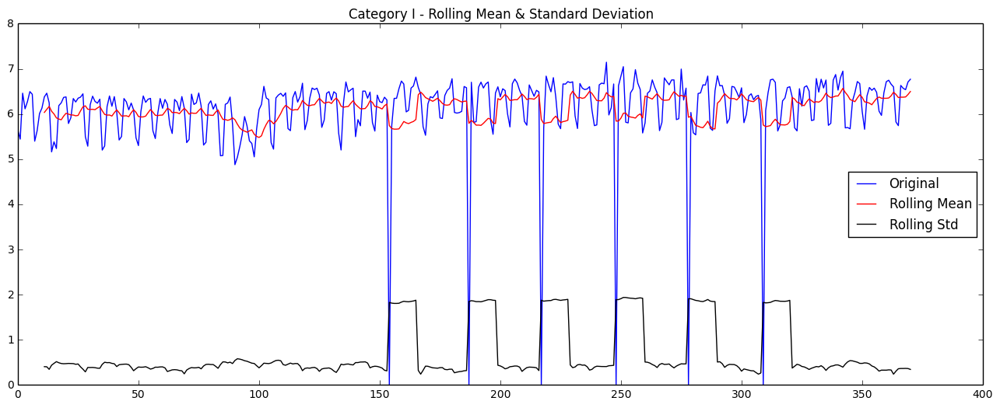

Results of Dickey-Fuller Test:
Test Statistic                -6.714795e+00
p-value                        3.604706e-09
#Lags Used                     6.000000e+00
Number of Observations Used    3.640000e+02
Critical Value (5%)           -2.869513e+00
Critical Value (1%)           -3.448443e+00
Critical Value (10%)          -2.571018e+00
dtype: float64


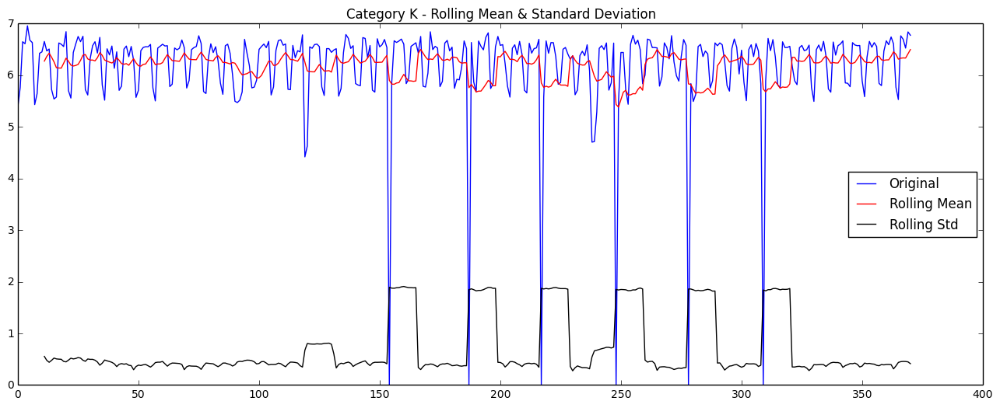

Results of Dickey-Fuller Test:
Test Statistic                -7.027234e+00
p-value                        6.318328e-10
#Lags Used                     6.000000e+00
Number of Observations Used    3.640000e+02
Critical Value (5%)           -2.869513e+00
Critical Value (1%)           -3.448443e+00
Critical Value (10%)          -2.571018e+00
dtype: float64


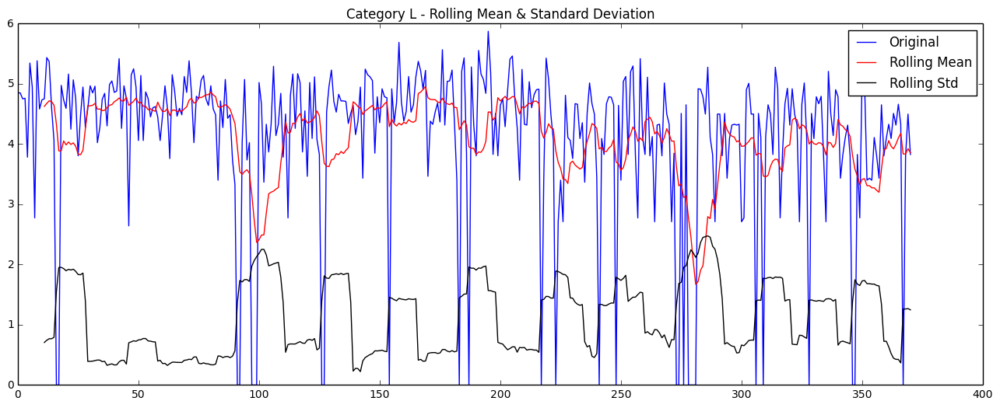

Results of Dickey-Fuller Test:
Test Statistic                  -5.143955
p-value                          0.000011
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


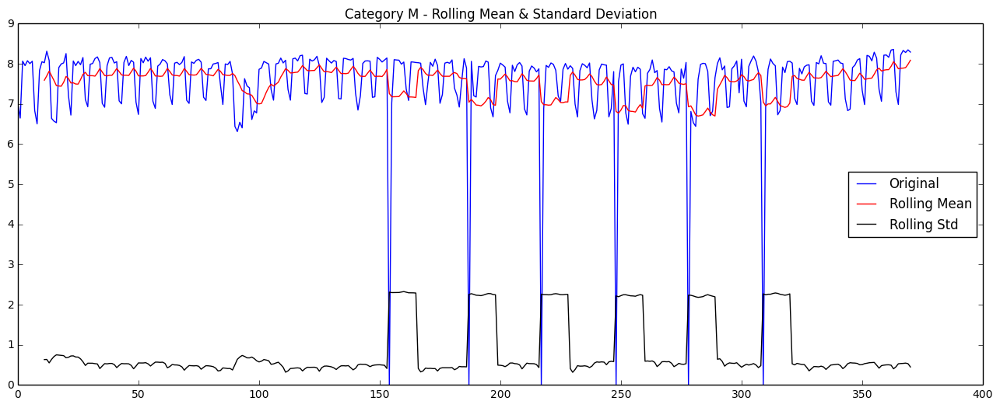

Results of Dickey-Fuller Test:
Test Statistic                -6.281605e+00
p-value                        3.784556e-08
#Lags Used                     6.000000e+00
Number of Observations Used    3.640000e+02
Critical Value (5%)           -2.869513e+00
Critical Value (1%)           -3.448443e+00
Critical Value (10%)          -2.571018e+00
dtype: float64


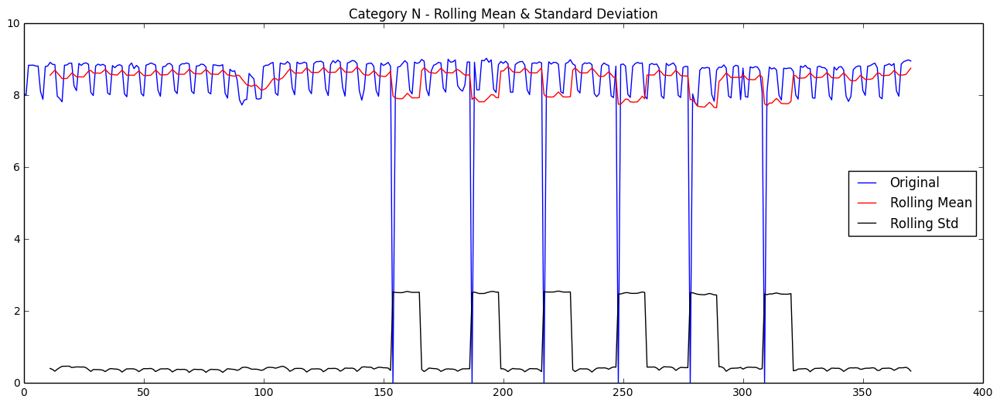

Results of Dickey-Fuller Test:
Test Statistic                -1.839835e+01
p-value                        2.194590e-30
#Lags Used                     0.000000e+00
Number of Observations Used    3.700000e+02
Critical Value (5%)           -2.869383e+00
Critical Value (1%)           -3.448148e+00
Critical Value (10%)          -2.570948e+00
dtype: float64


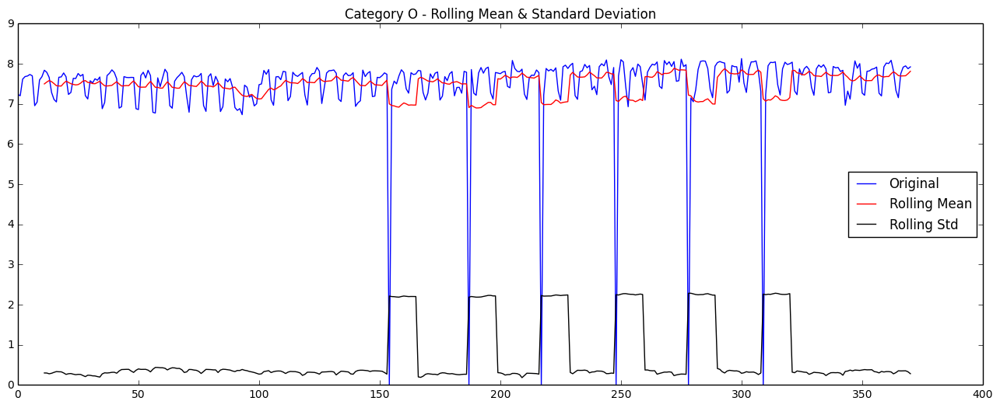

Results of Dickey-Fuller Test:
Test Statistic                -1.846584e+01
p-value                        2.143411e-30
#Lags Used                     0.000000e+00
Number of Observations Used    3.700000e+02
Critical Value (5%)           -2.869383e+00
Critical Value (1%)           -3.448148e+00
Critical Value (10%)          -2.570948e+00
dtype: float64


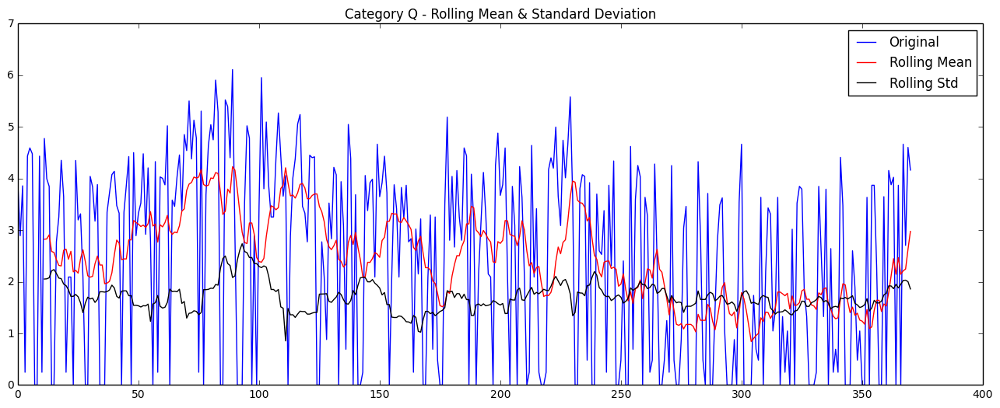

Results of Dickey-Fuller Test:
Test Statistic                  -4.350685
p-value                          0.000363
#Lags Used                       6.000000
Number of Observations Used    364.000000
Critical Value (5%)             -2.869513
Critical Value (1%)             -3.448443
Critical Value (10%)            -2.571018
dtype: float64


In [26]:
_ = map(test_stationarity, splitted_data_log, temp_list)

In [27]:
# See if inverse sine improved test statistics, or made it worse.
def stat_diff(transformed_series, items):
    observed_stat = map(test_statistic, splitted_data)
    logged_stat = map(test_statistic, transformed_series)
    stat_diff = map(lambda x, y: x - y, observed_stat, logged_stat)
    for i, cat in enumerate(items):
        print cat, ':', stat_diff[i]
    print 'Mean test stats improvement (higher is better): ', np.mean(stat_diff)

stat_diff(splitted_data_log, temp_list)

A : 0.440956963853
B : 15.6157225869
C : 2.8955675304
D : -0.00624673775449
E : 1.75825660942
F : 0.591146771245
G : 14.4381250616
H : 14.0120147234
I : 4.70685678607
K : 2.11869462581
L : 0.277862561217
M : 3.8366245485
N : 14.4181354384
O : 16.4251115171
Q : 1.15543413612
Mean test stats improvement (higher is better):  6.17895087482


In [83]:
# Inverse sine definitely improved the test statistics, and made things more stationary.

# 3.2) Seasonal(obs)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


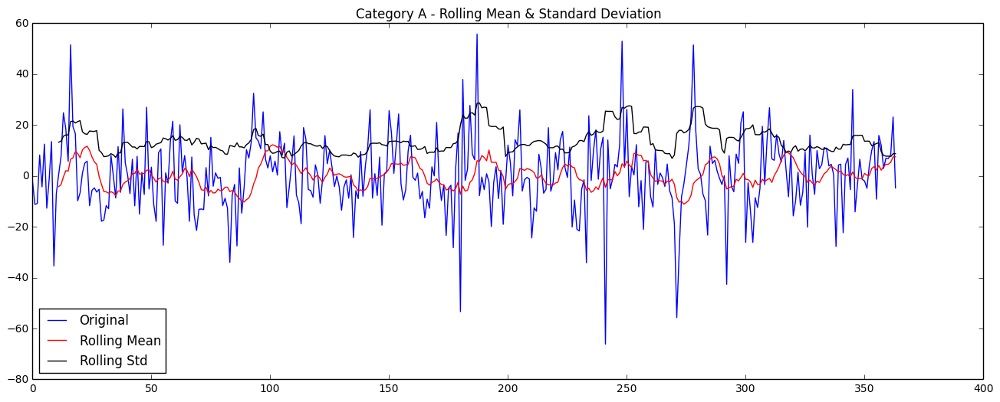

Results of Dickey-Fuller Test:
Test Statistic                  -4.552812
p-value                          0.000158
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


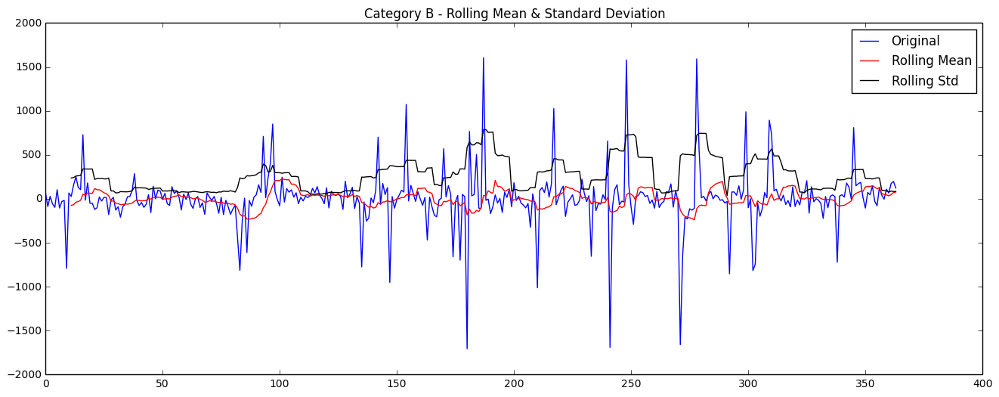

Results of Dickey-Fuller Test:
Test Statistic                -6.128262e+00
p-value                        8.524393e-08
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


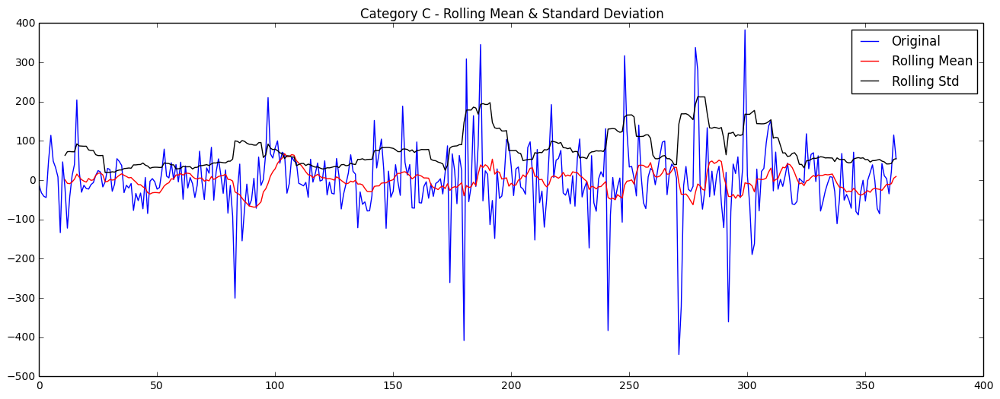

Results of Dickey-Fuller Test:
Test Statistic                -6.484806e+00
p-value                        1.268683e-08
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


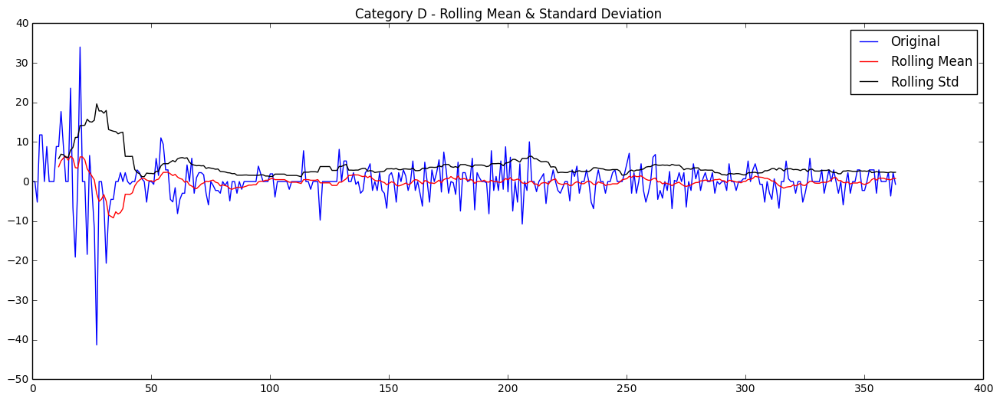

Results of Dickey-Fuller Test:
Test Statistic                  -5.503492
p-value                          0.000002
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


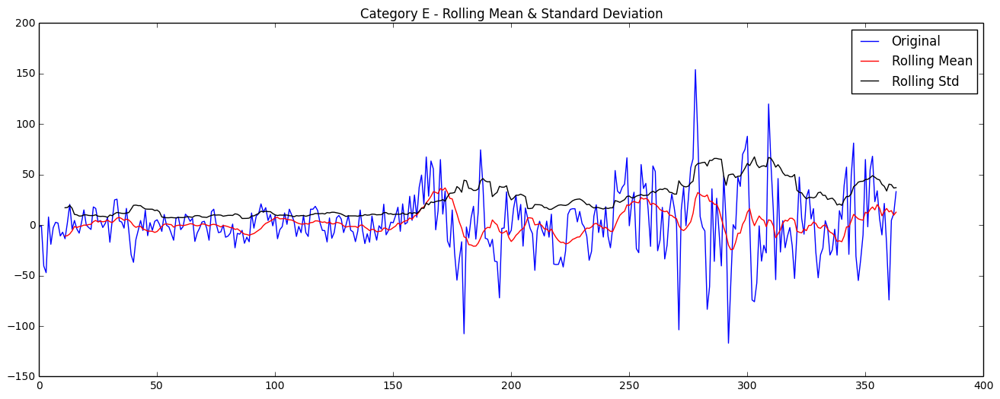

Results of Dickey-Fuller Test:
Test Statistic                  -3.808871
p-value                          0.002818
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


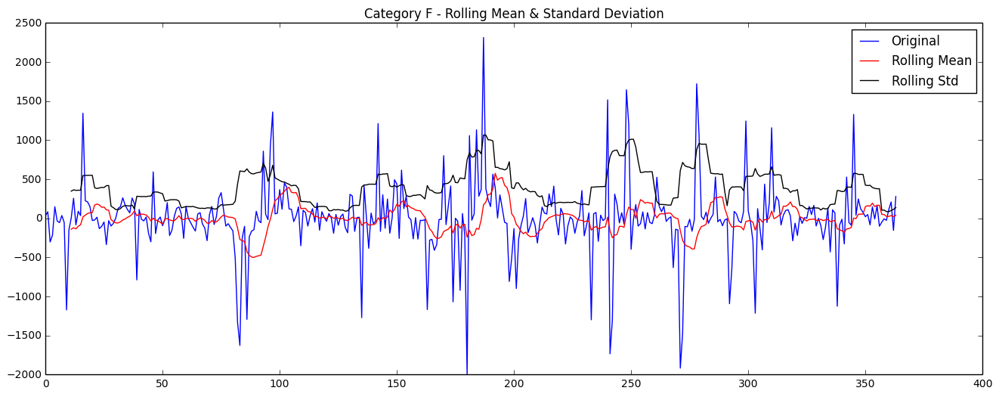

Results of Dickey-Fuller Test:
Test Statistic                  -5.306377
p-value                          0.000005
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


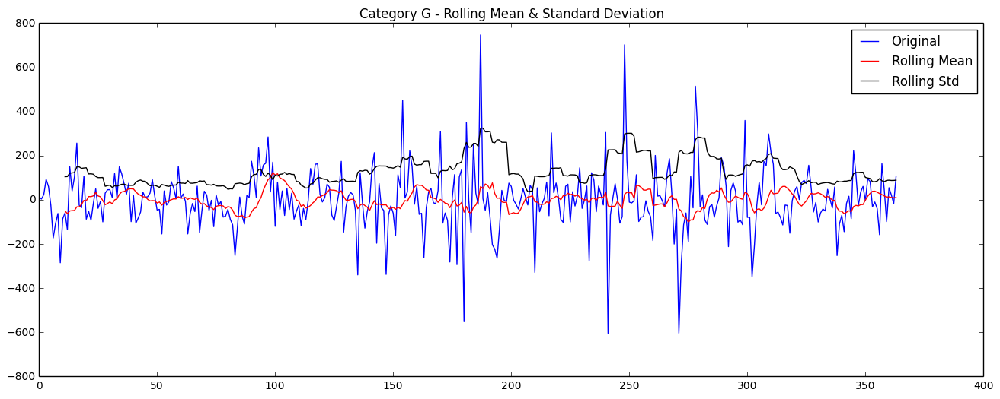

Results of Dickey-Fuller Test:
Test Statistic                -5.747385e+00
p-value                        6.076922e-07
#Lags Used                     1.500000e+01
Number of Observations Used    3.480000e+02
Critical Value (5%)           -2.869881e+00
Critical Value (1%)           -3.449282e+00
Critical Value (10%)          -2.571214e+00
dtype: float64


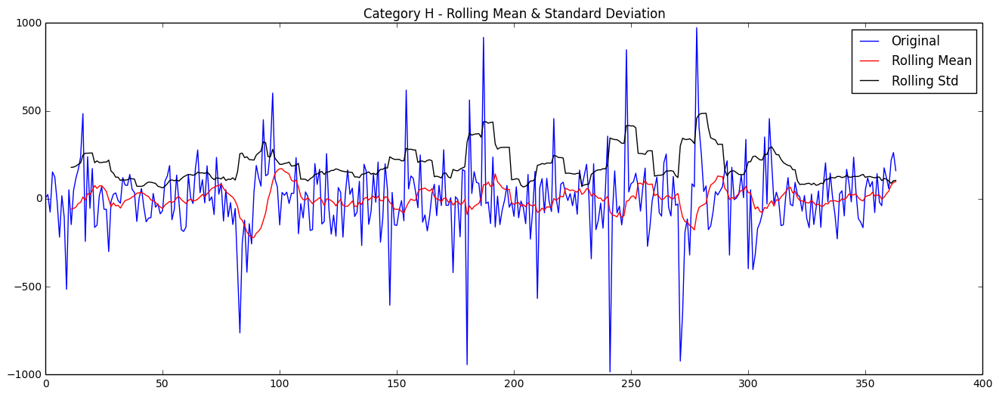

Results of Dickey-Fuller Test:
Test Statistic                -5.850242e+00
p-value                        3.603532e-07
#Lags Used                     1.700000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


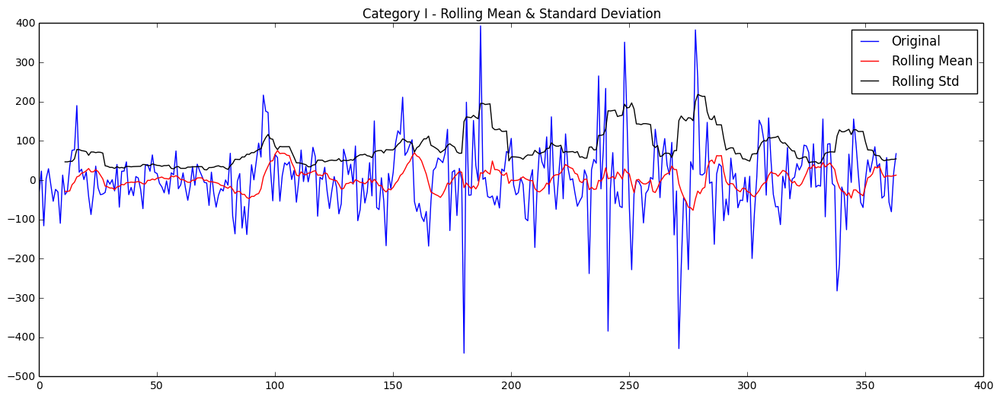

Results of Dickey-Fuller Test:
Test Statistic                -8.309316e+00
p-value                        3.826991e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


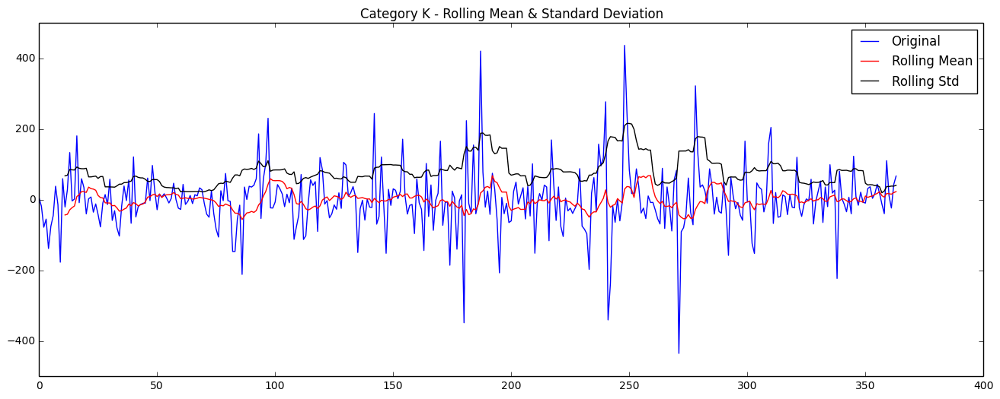

Results of Dickey-Fuller Test:
Test Statistic                -7.804582e+00
p-value                        7.339401e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


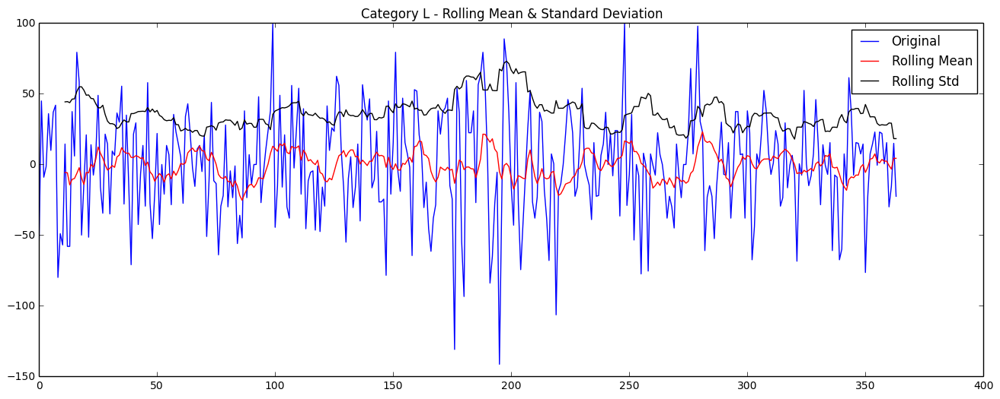

Results of Dickey-Fuller Test:
Test Statistic                -6.210707e+00
p-value                        5.516691e-08
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


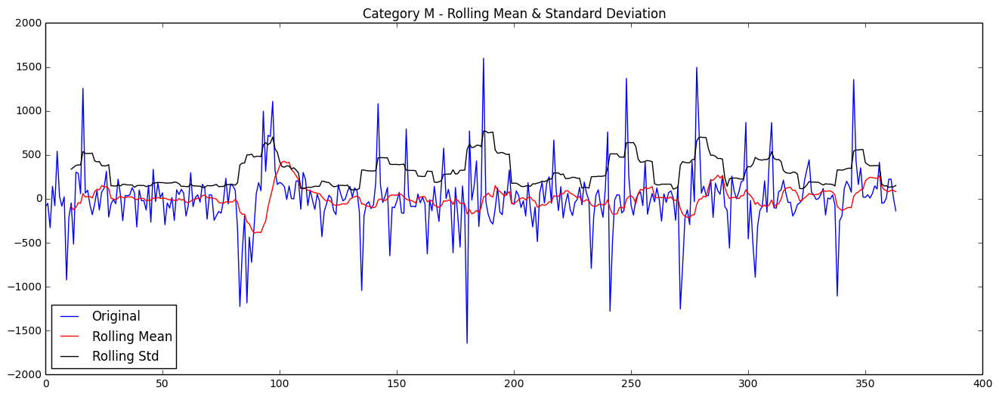

Results of Dickey-Fuller Test:
Test Statistic                  -4.504106
p-value                          0.000193
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


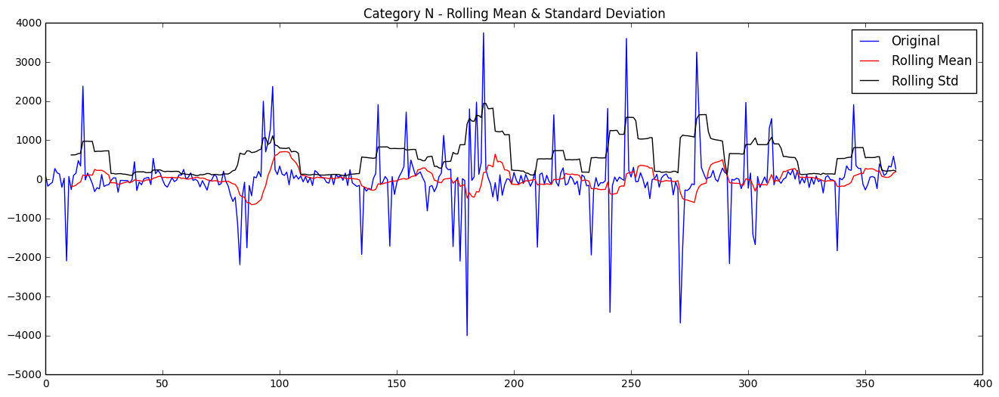

Results of Dickey-Fuller Test:
Test Statistic                -6.306190e+00
p-value                        3.319101e-08
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


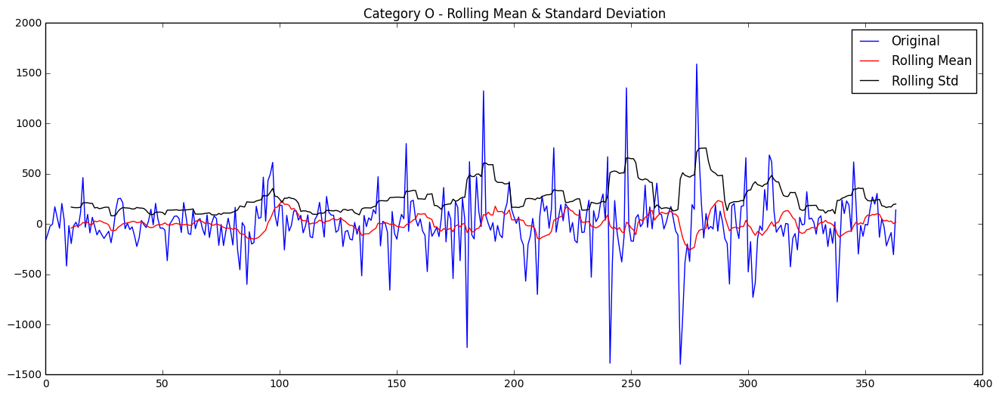

Results of Dickey-Fuller Test:
Test Statistic                -5.926516e+00
p-value                        2.436457e-07
#Lags Used                     1.700000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


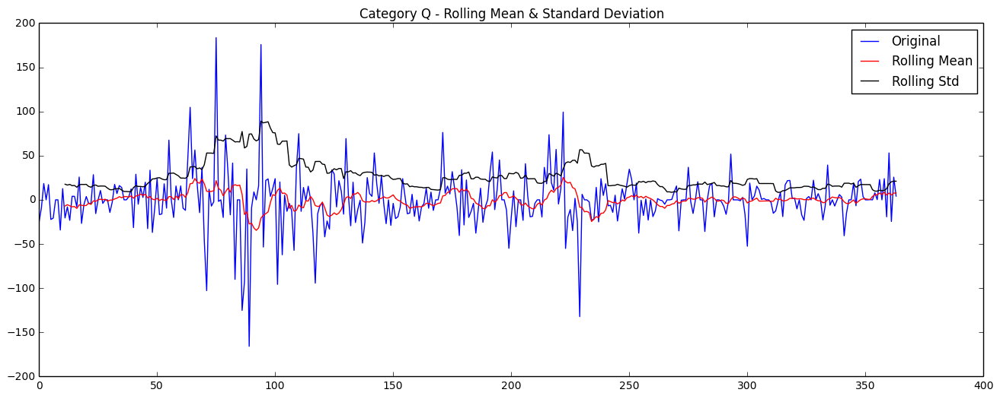

Results of Dickey-Fuller Test:
Test Statistic                  -5.136400
p-value                          0.000012
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64
A : 0.929514542982
B : 2.93344195567
C : 2.02727271273
D : 1.71366071127
E : 3.55748861942
F : 1.09521920019
G : 1.67389014244
H : 1.10342147269
I : 6.30137706631
K : 2.89604178489
L : 1.34461492235
M : 2.05912492717
N : 2.32597977315
O : 3.88578592906
Q : 1.94114885774
Mean test stats improvement (higher is better):  2.38586550787


In [28]:
splitted_data_season = map(lambda x: x - x.shift(7), splitted_data)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season)
_ = map(test_stationarity, splitted_data_season, temp_list)
stat_diff(splitted_data_season, temp_list)

# 3.3) Now seasonal(Inversed())

/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


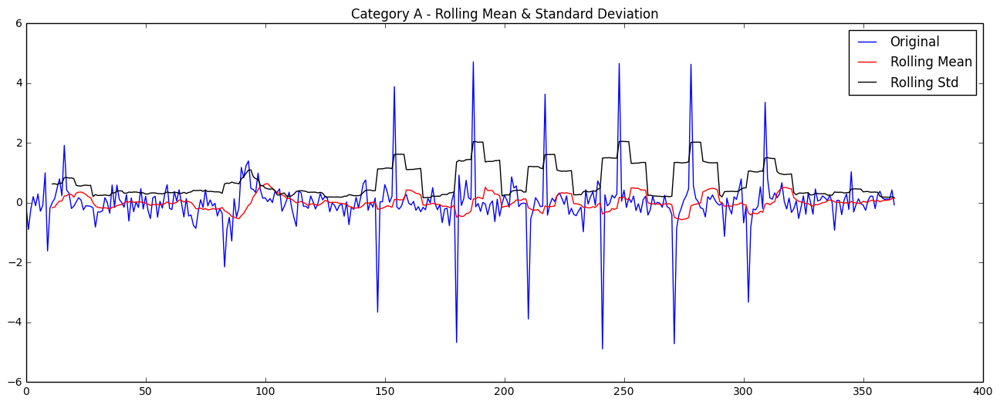

Results of Dickey-Fuller Test:
Test Statistic                -7.934650e+00
p-value                        3.439359e-12
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


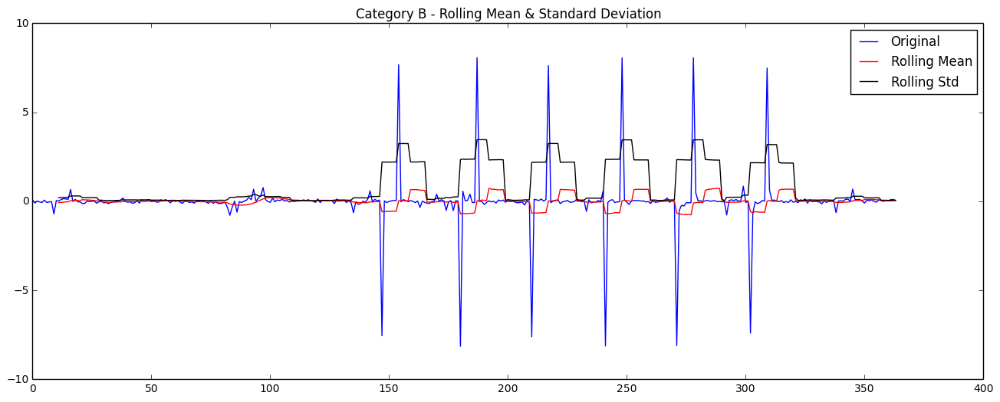

Results of Dickey-Fuller Test:
Test Statistic                -8.486665e+00
p-value                        1.347545e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


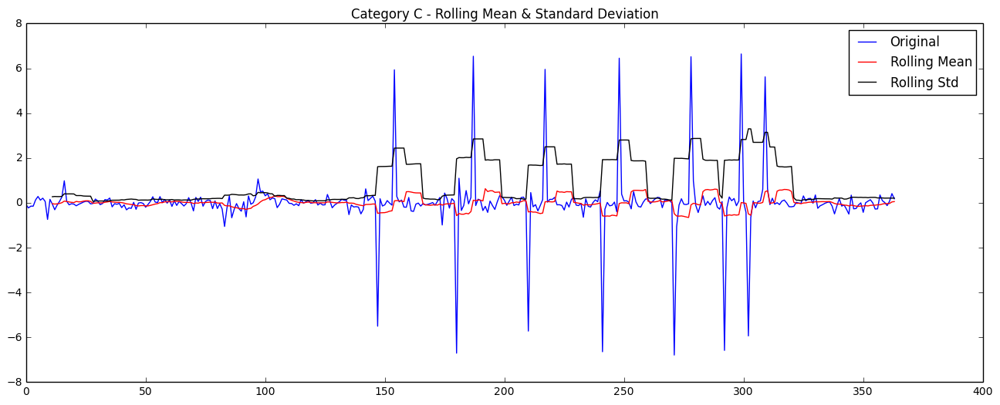

Results of Dickey-Fuller Test:
Test Statistic                -9.074336e+00
p-value                        4.218870e-15
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


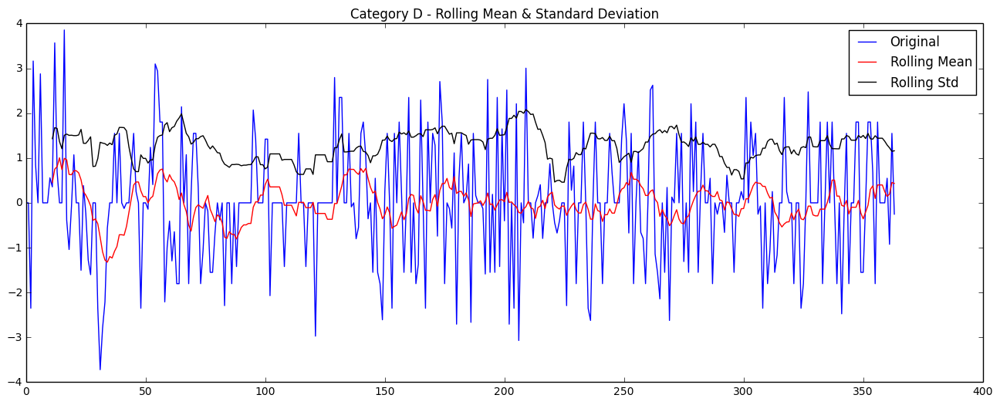

Results of Dickey-Fuller Test:
Test Statistic                -6.515643e+00
p-value                        1.073070e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


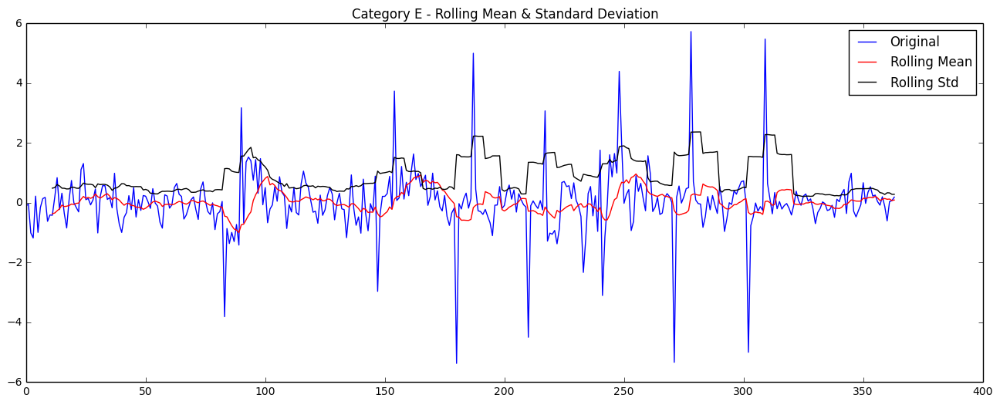

Results of Dickey-Fuller Test:
Test Statistic                -5.780678e+00
p-value                        5.134639e-07
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


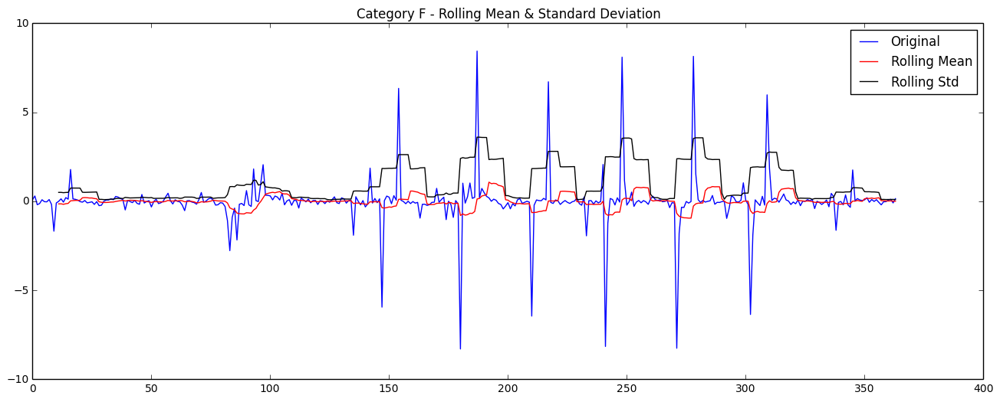

Results of Dickey-Fuller Test:
Test Statistic                -8.397937e+00
p-value                        2.272180e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


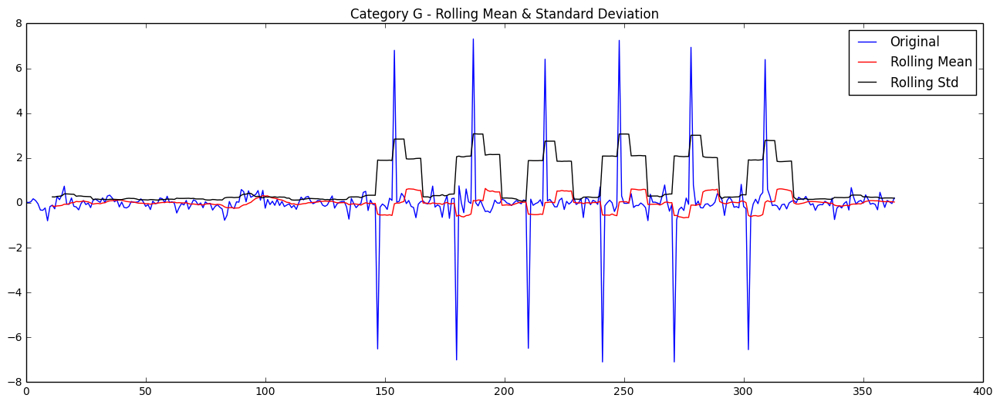

Results of Dickey-Fuller Test:
Test Statistic                -8.668638e+00
p-value                        4.610519e-14
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


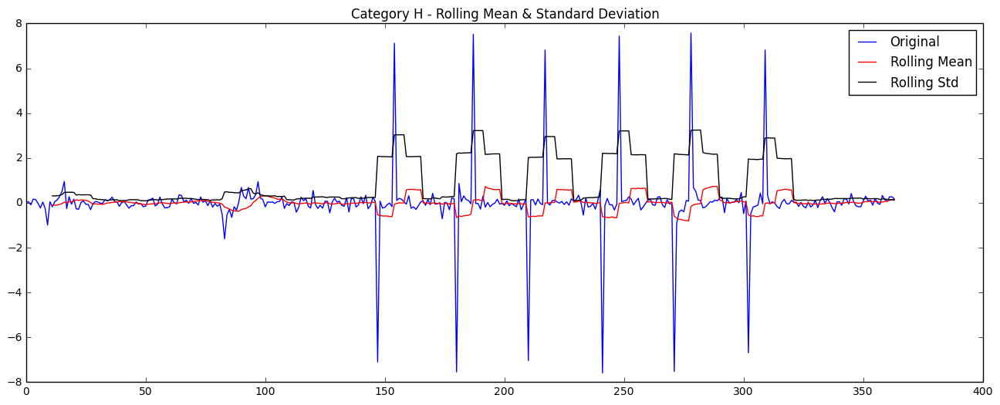

Results of Dickey-Fuller Test:
Test Statistic                -8.431955e+00
p-value                        1.859830e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


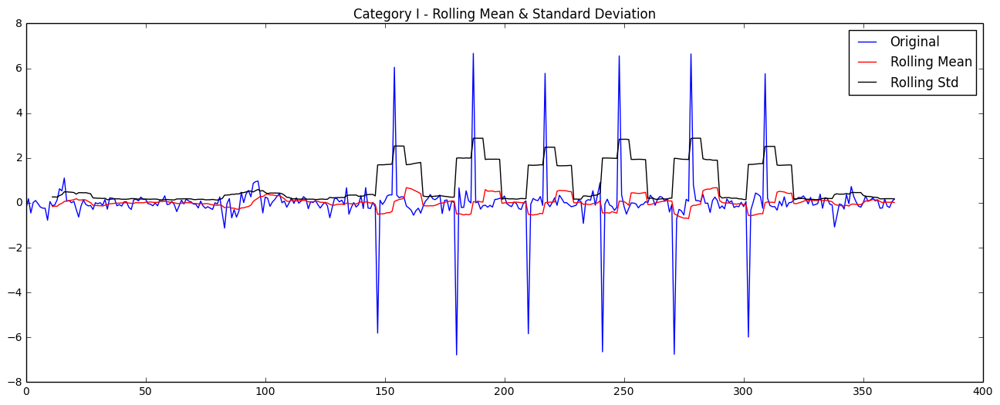

Results of Dickey-Fuller Test:
Test Statistic                -8.567981e+00
p-value                        8.345546e-14
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


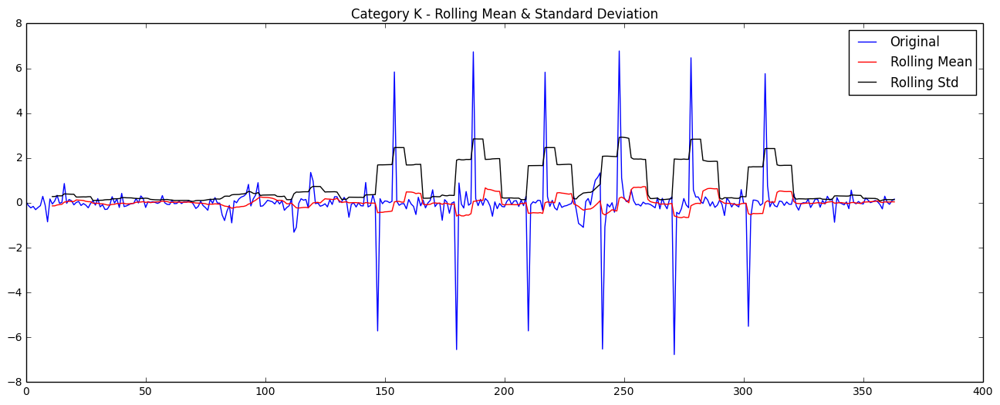

Results of Dickey-Fuller Test:
Test Statistic                -8.533375e+00
p-value                        1.023351e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


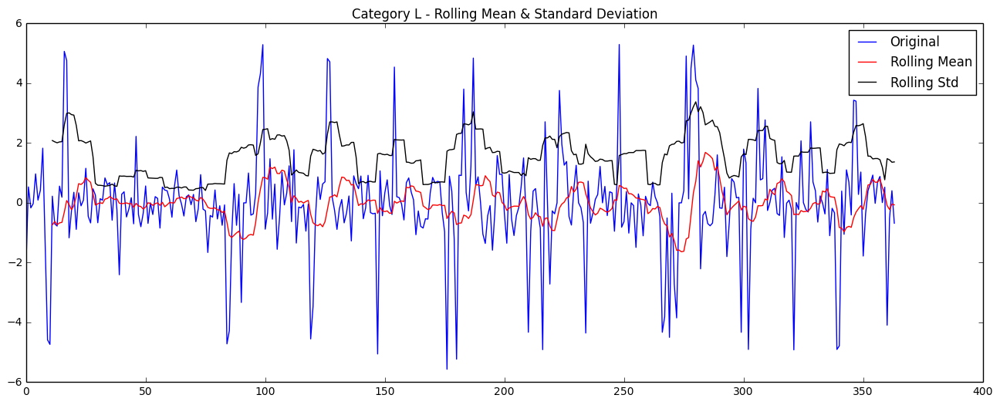

Results of Dickey-Fuller Test:
Test Statistic                -6.669041e+00
p-value                        4.637896e-09
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


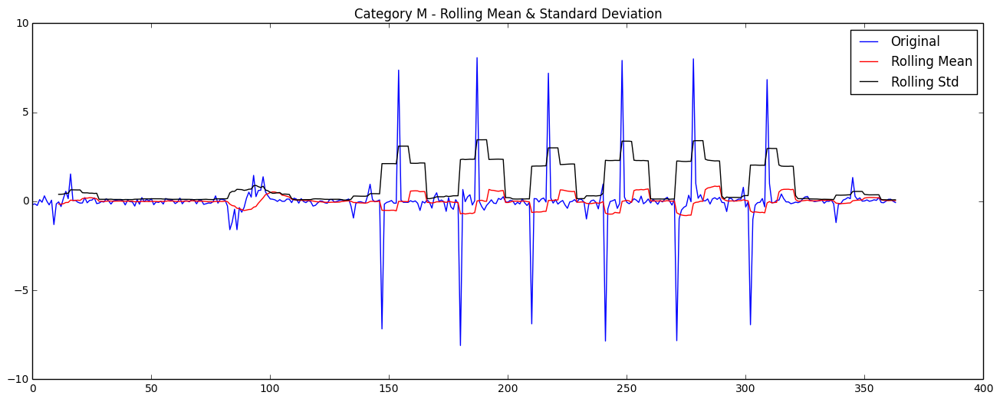

Results of Dickey-Fuller Test:
Test Statistic                -8.484268e+00
p-value                        1.366705e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


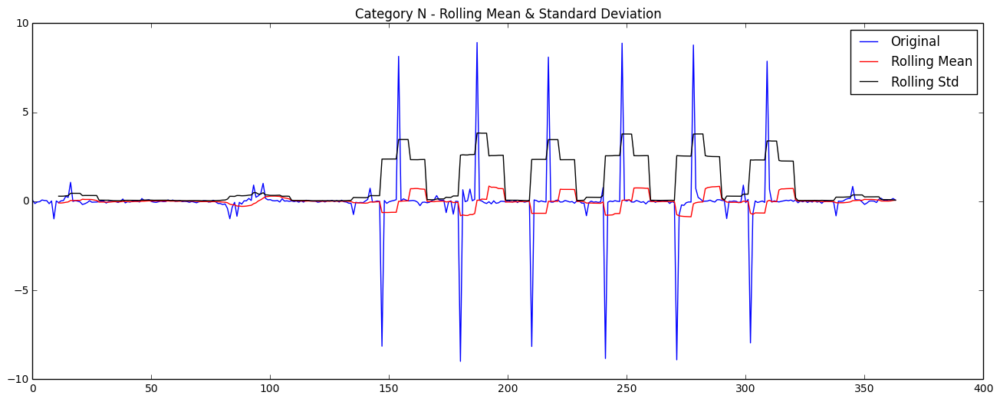

Results of Dickey-Fuller Test:
Test Statistic                -8.434657e+00
p-value                        1.830474e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


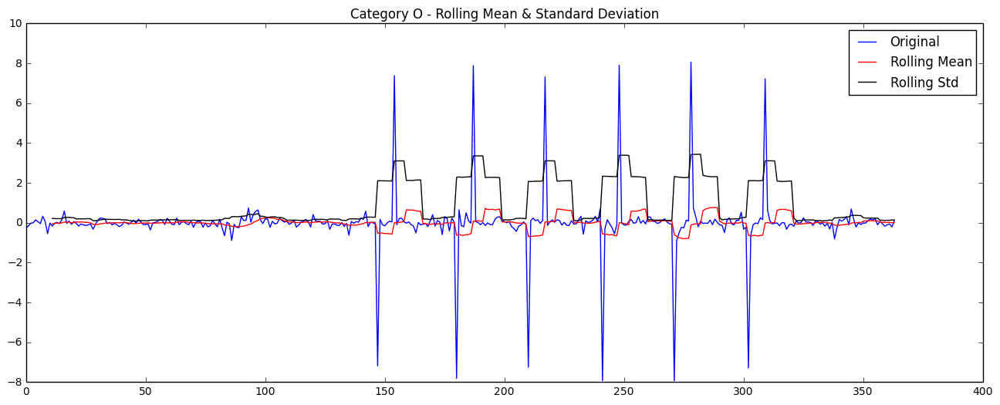

Results of Dickey-Fuller Test:
Test Statistic                -8.632425e+00
p-value                        5.707884e-14
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64


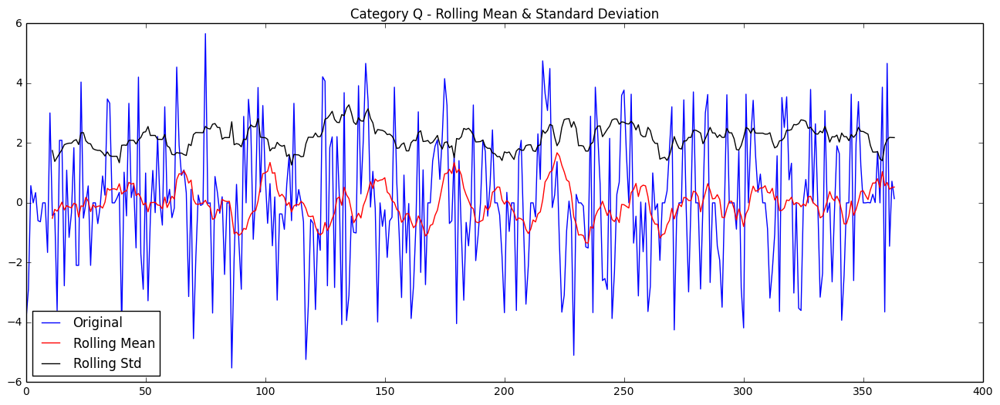

Results of Dickey-Fuller Test:
Test Statistic                -8.458662e+00
p-value                        1.589183e-13
#Lags Used                     1.300000e+01
Number of Observations Used    3.500000e+02
Critical Value (5%)           -2.869833e+00
Critical Value (1%)           -3.449173e+00
Critical Value (10%)          -2.571188e+00
dtype: float64
A : 4.31135297141
B : 5.29184434105
C : 4.61680296015
D : 2.72581196381
E : 5.52929582208
F : 4.18677894181
G : 4.59514369596
H : 3.6851345241
I : 6.56004267296
K : 3.62483560667
L : 1.80294903303
M : 6.03928744427
N : 4.45444668332
O : 6.59169505968
Q : 5.26341098319
Mean test stats improvement (higher is better):  4.6185888469


In [29]:
# Differencing to deal with seasonality...
# Log seasonal

splitted_data_season_log = map(lambda x: x - x.shift(7), splitted_data_log)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_season_log)
_ = map(test_stationarity, splitted_data_season_log, temp_list)
stat_diff(splitted_data_season_log, temp_list)

##### Inversed(obs): 6.17895087482
##### Seasonal(obs): 2.38586550787
##### Seasonal(Inversed()): 4.6185888469

### All the test statistics look really good.
### Next step is to visualize the ACF/PACF plots to determine we will use MA, AR, or ARIMA model.

# Step 4) ACF/PACF Plots for
## - Seasonal(obs)
## - Seasonal(Inversed())

In [30]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/collections.py:548: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


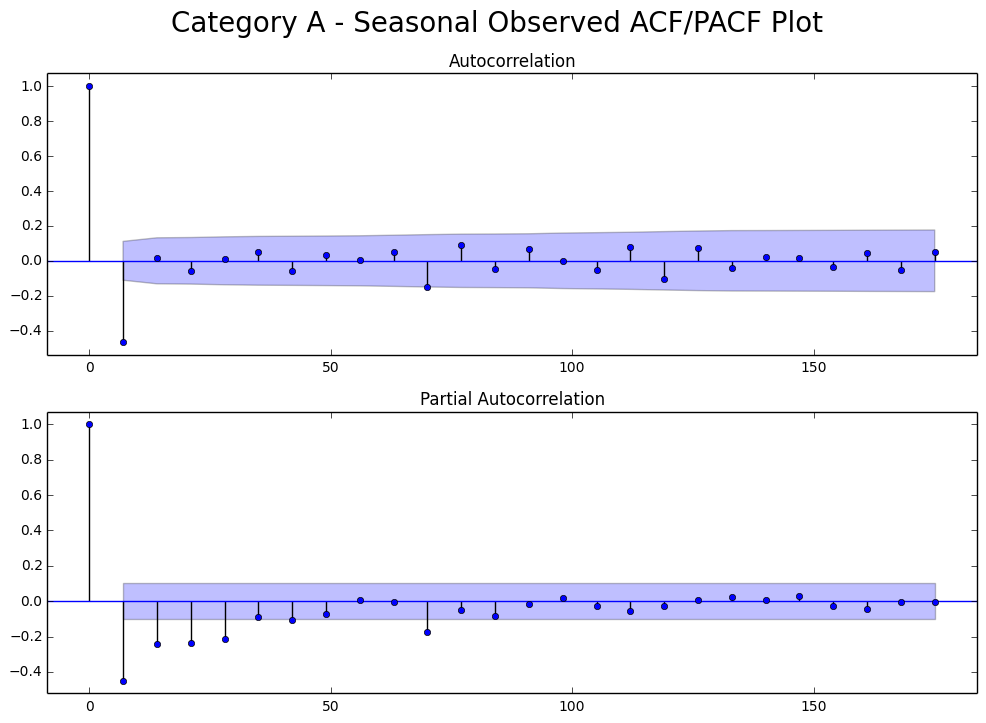

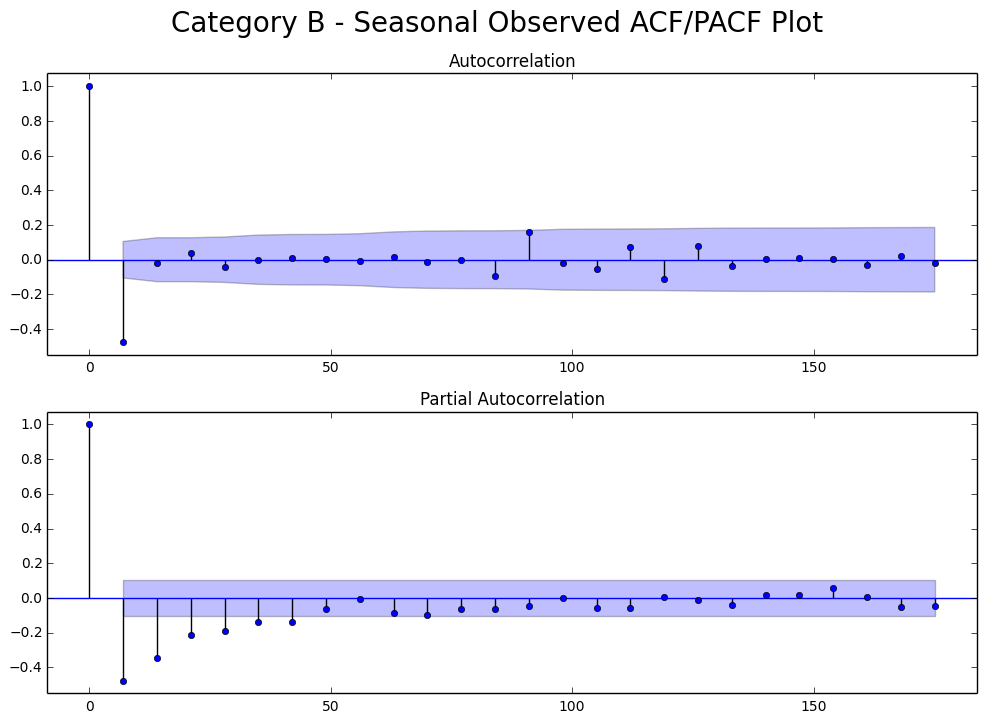

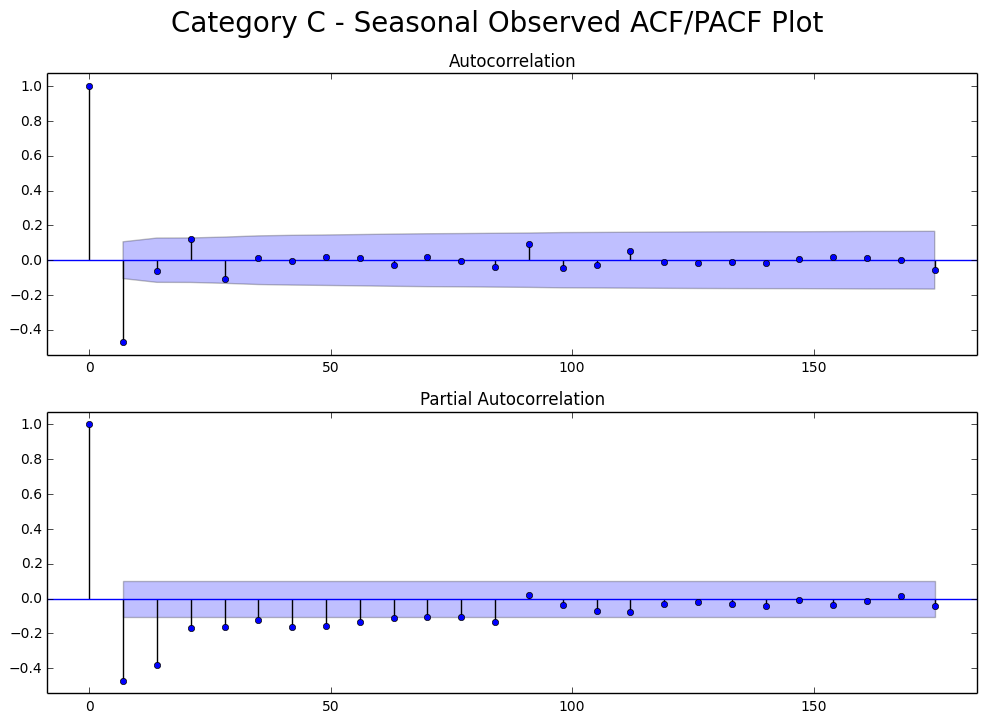

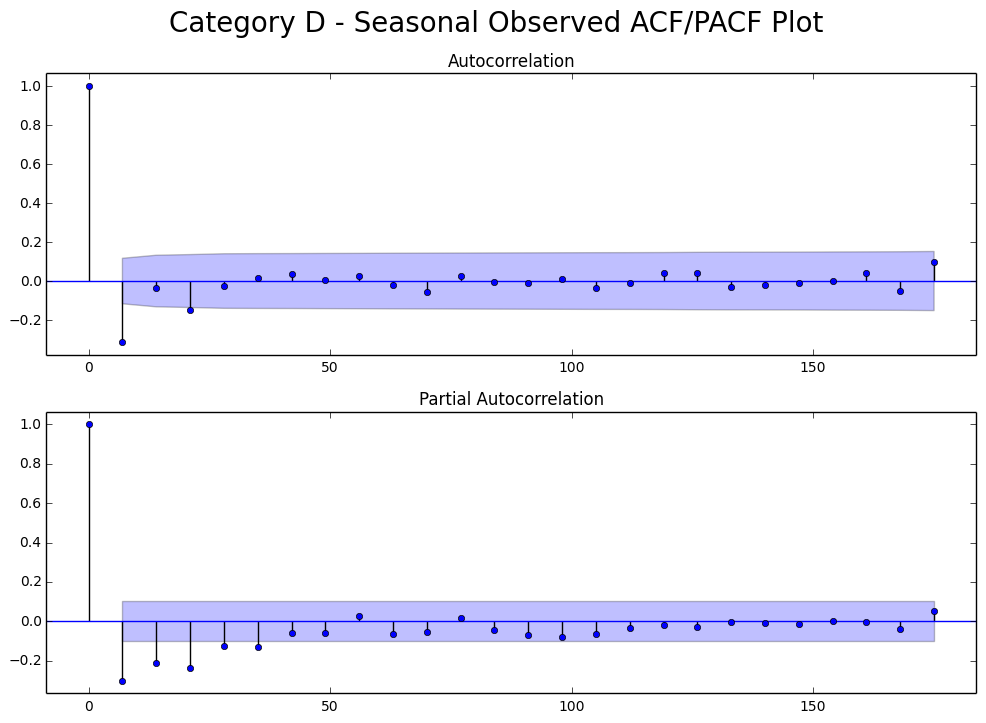

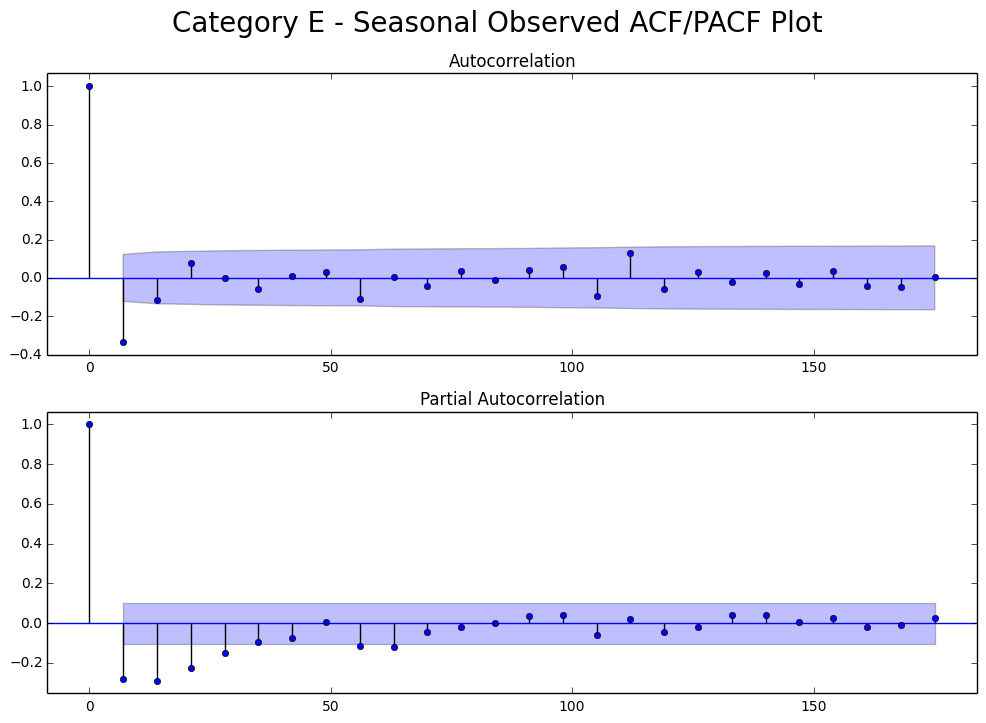

...

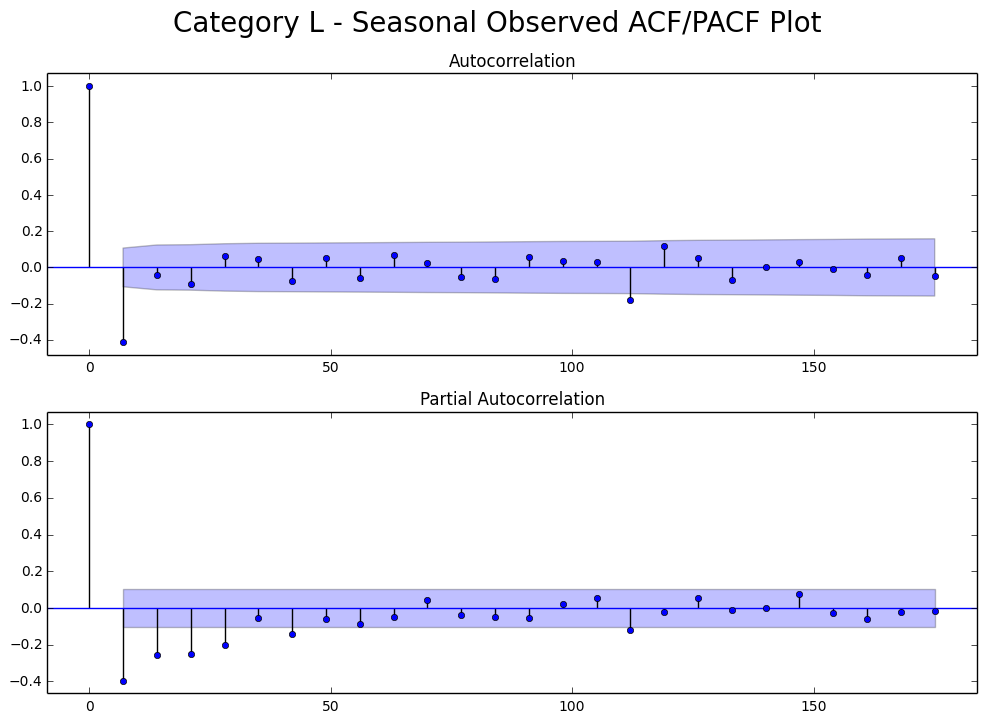

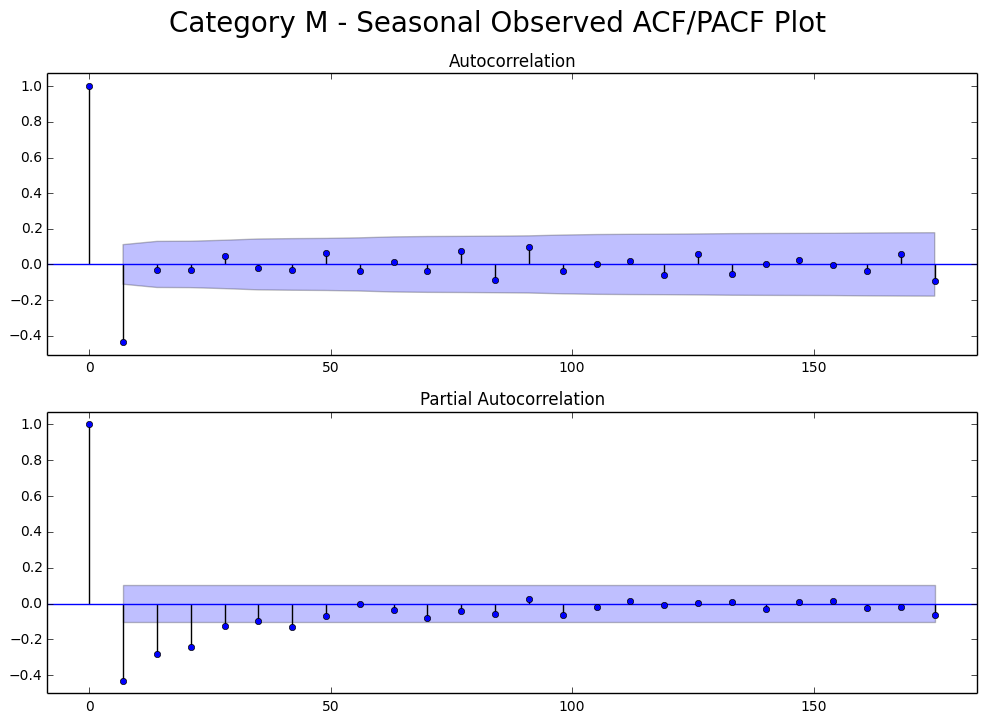

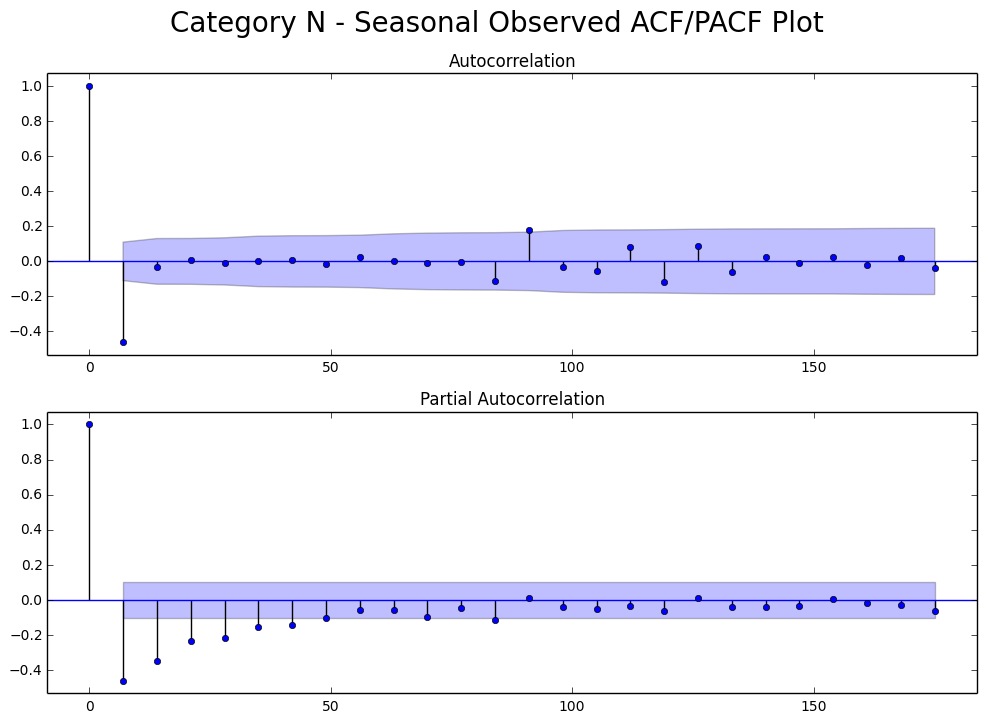

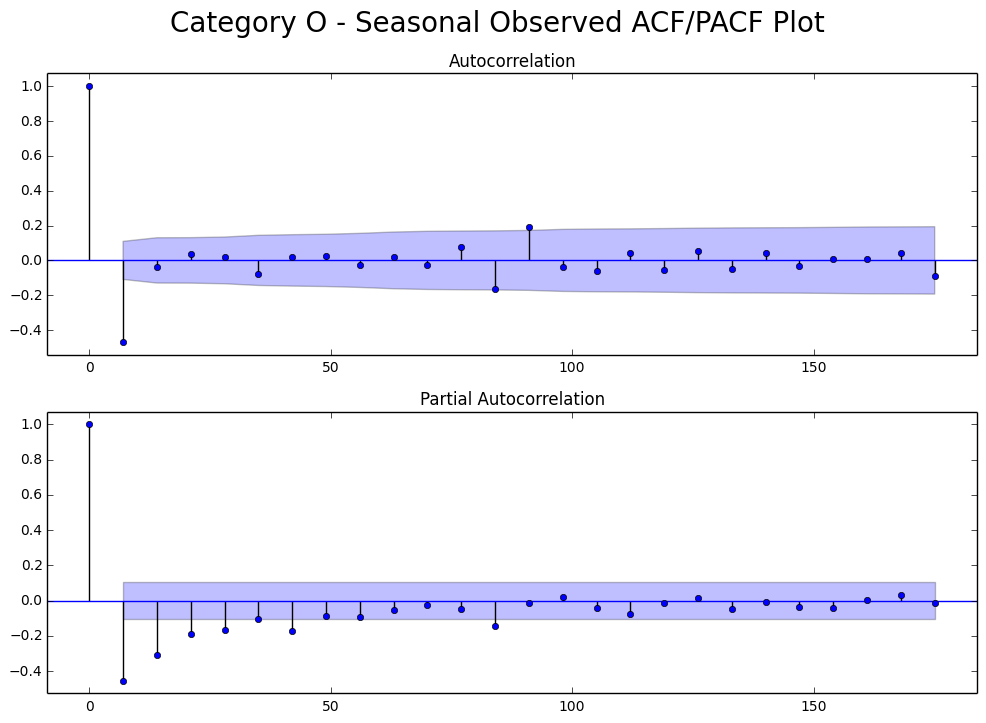

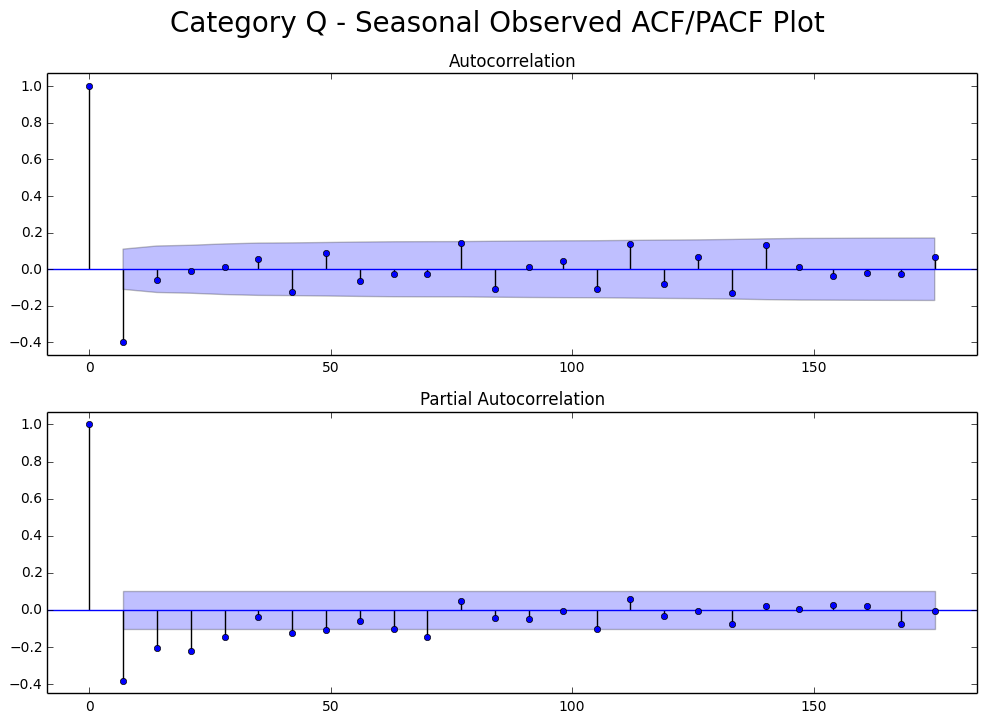

In [31]:
# Seasonal observed data ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season, ['Seasonal Observed']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

## We observe the following:
### - Mostly both tails off.

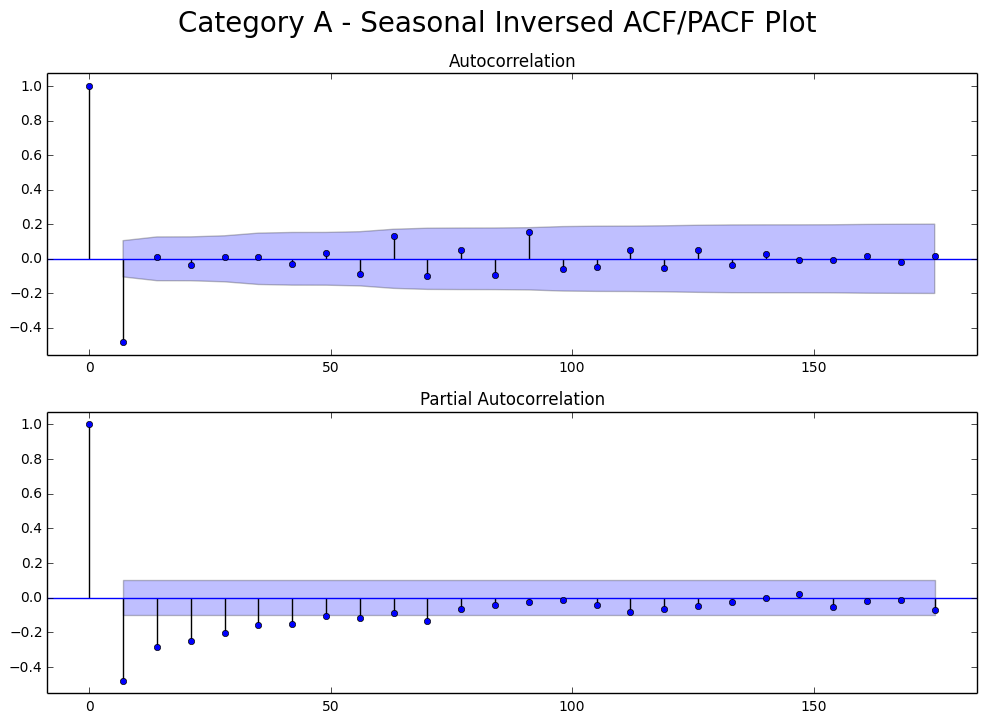

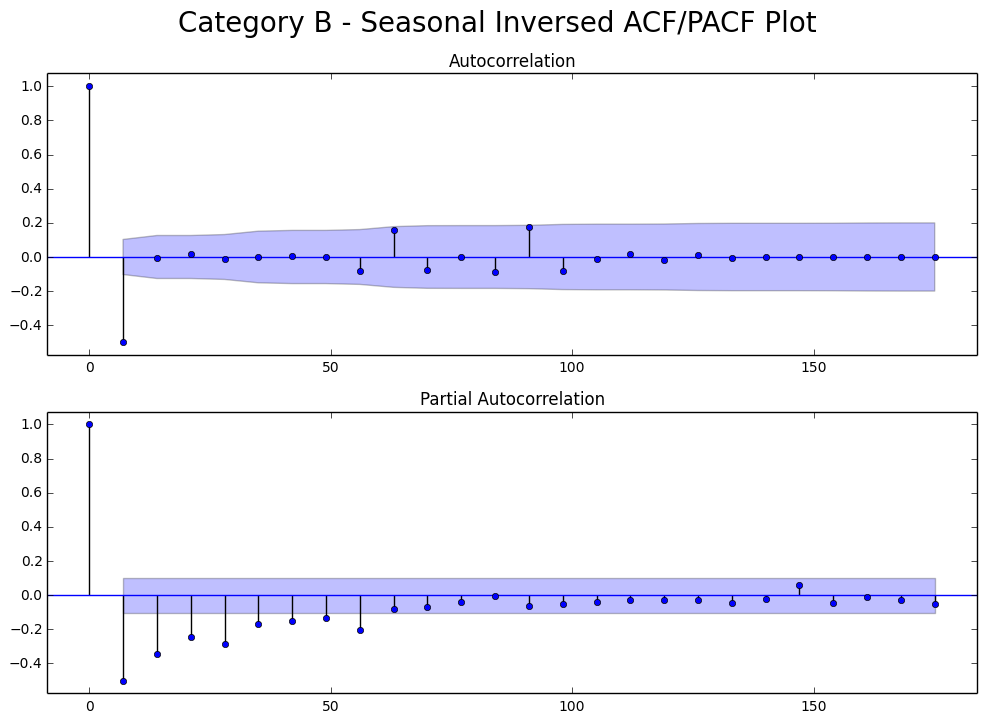

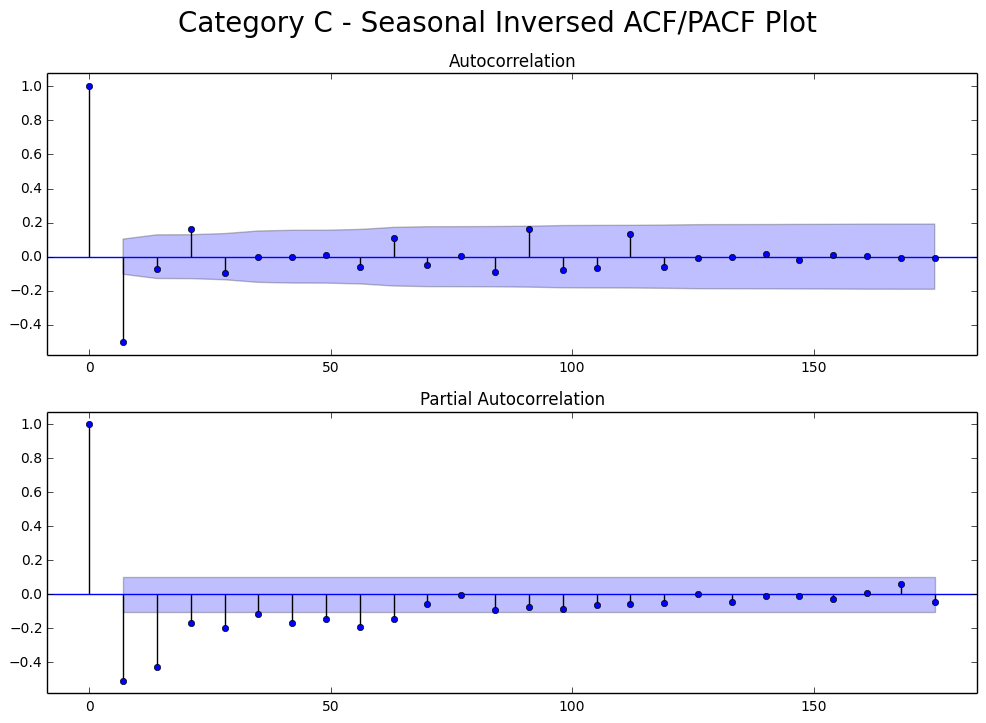

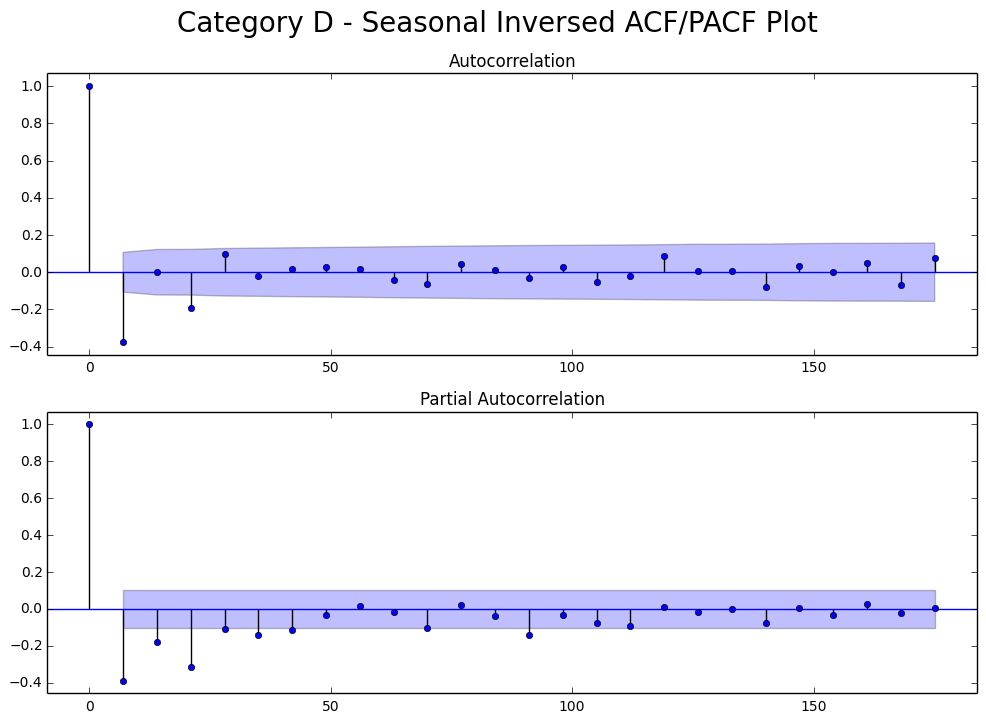

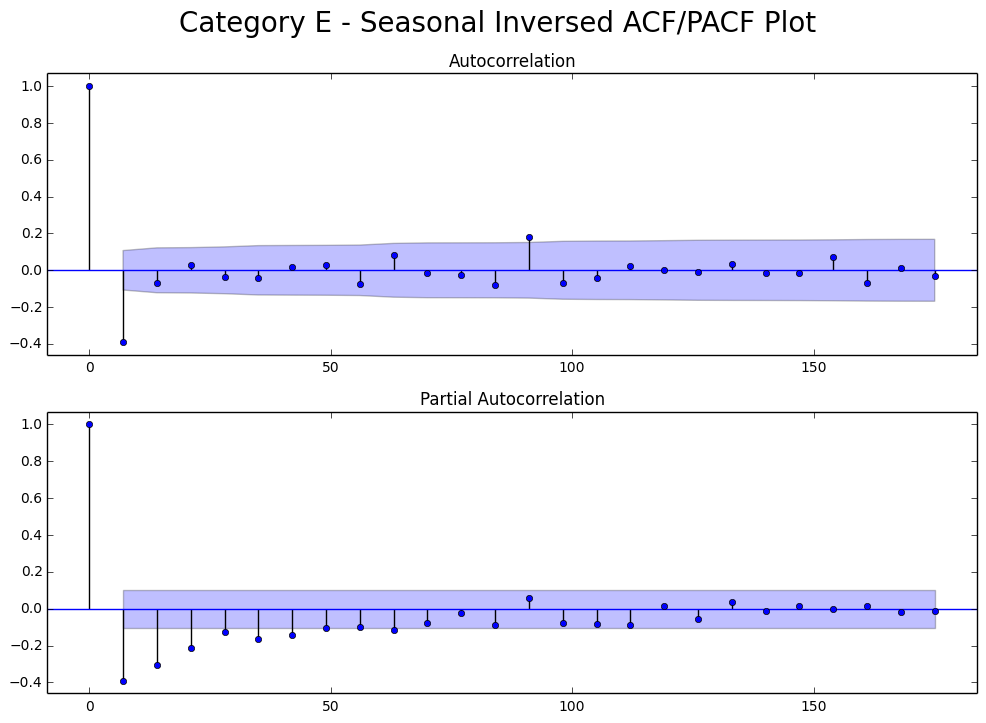

...

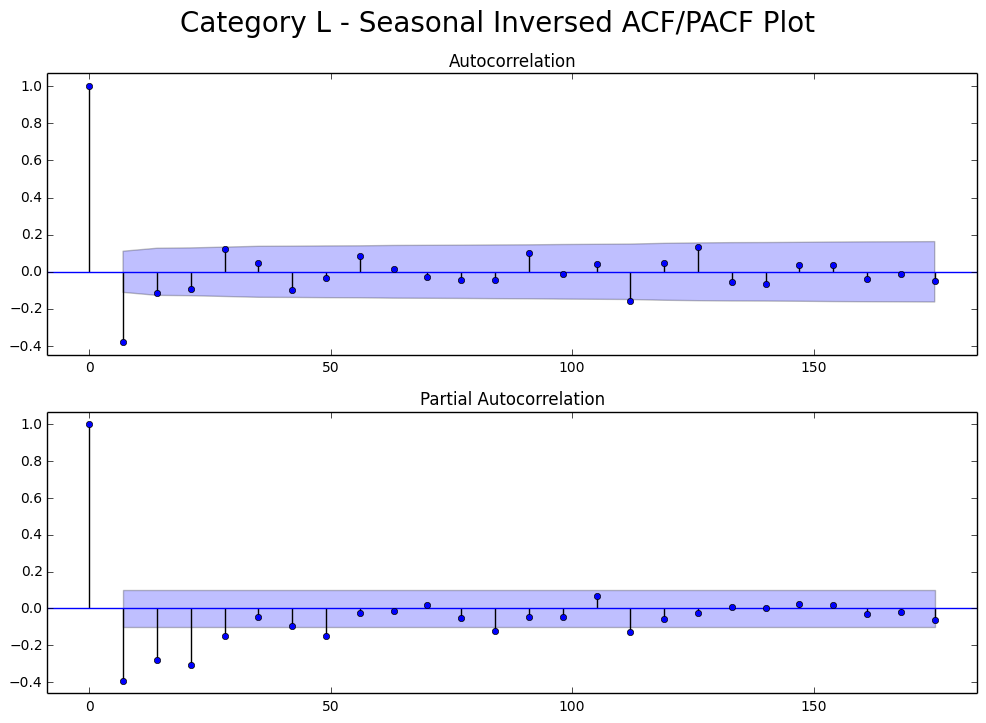

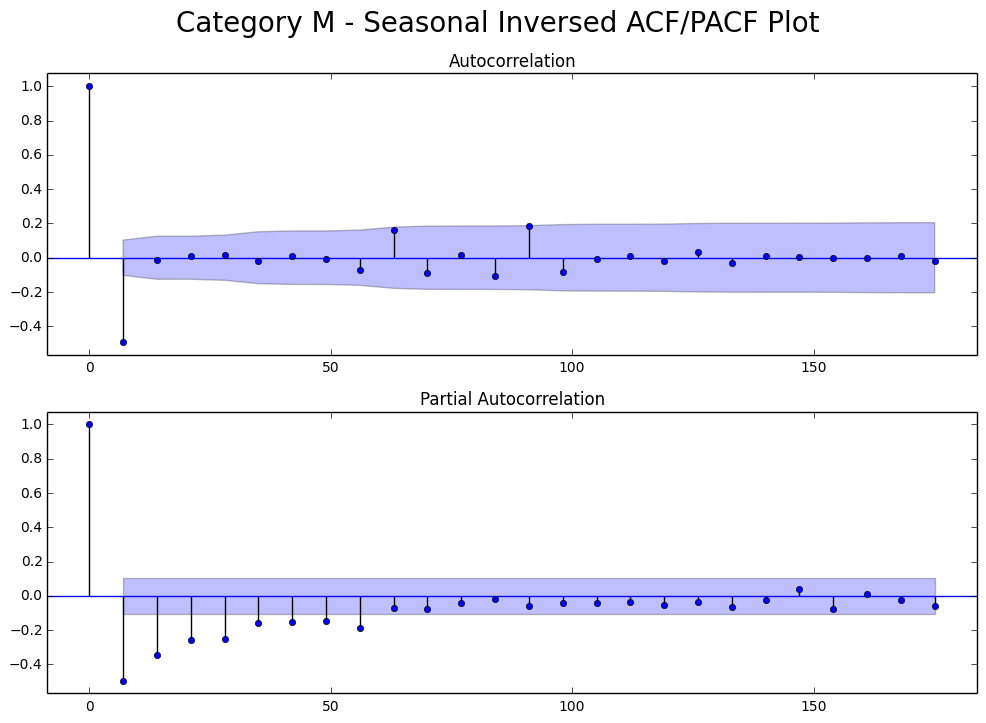

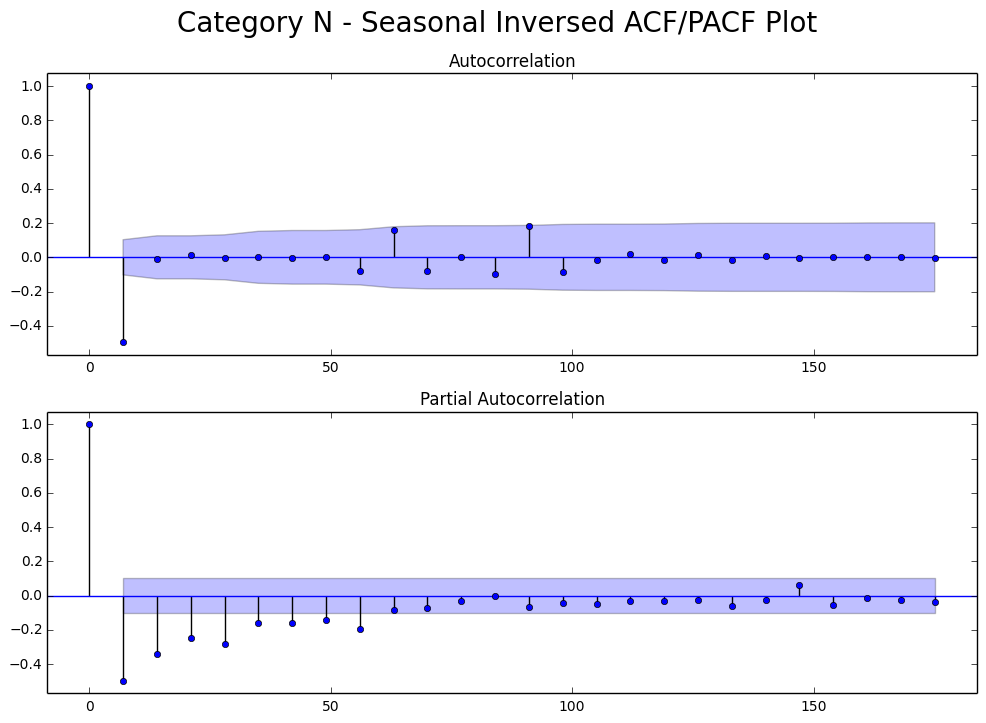

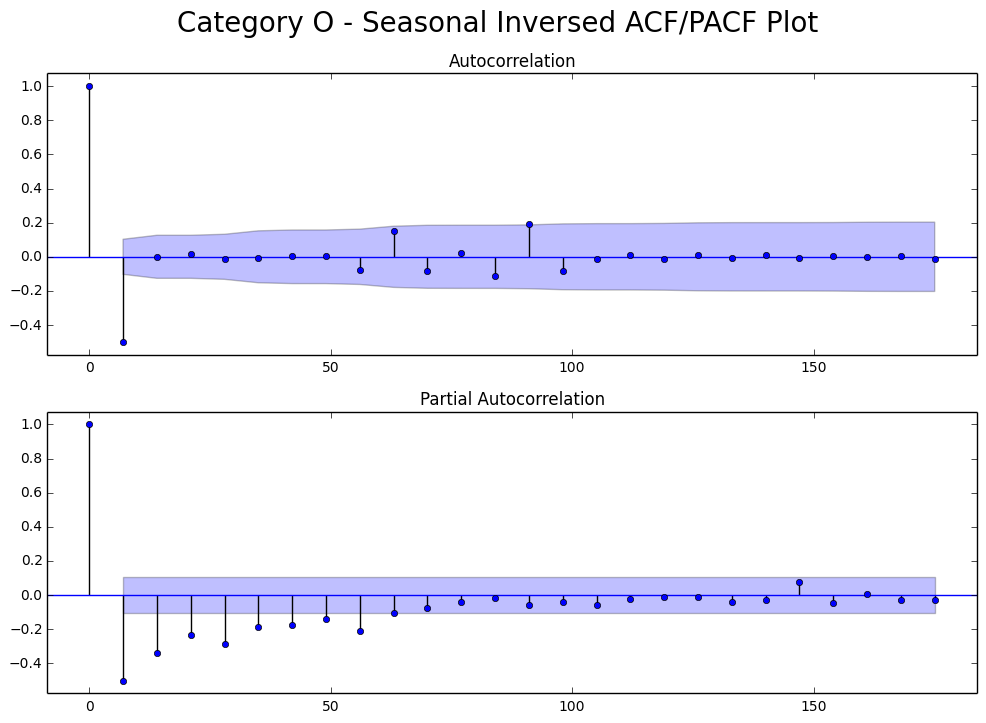

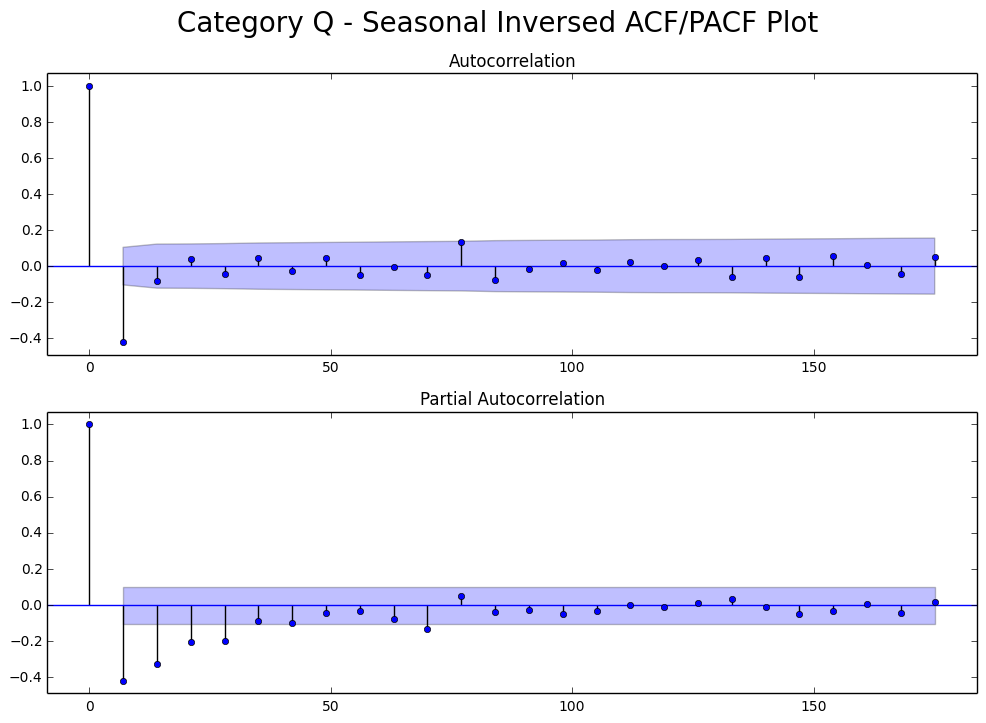

In [32]:
# Finally, let's see the Season Diff Inversed transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_season_log, ['Seasonal Inversed']*len(temp_list), temp_list, [range(0, 182, 7)]*len(temp_list))

# Step 5) Model Building
### - At this point we are sure we need MA and SMA models.
### - The AR and SAR models are uncertain.
### - We will use grid search to find out the AR & SAR order.

In [33]:
# We will use this function to help us search the best p & q values, and seasonal P & Q values.
# Four for loops is a lot, but we will be using it mostly for 1 or 2 values in each p, q, P & Q values.
# Because we already have a good idea these values won't be more than 2.

def evaluate_models(dataset, p_values, q_values, P_values, Q_values, trend):
    best_score, best_cfg, best_season = float("inf"), None, None
    for p in p_values:
        for q in q_values:
            for P in P_values:
                for Q in Q_values:
                    order = (p, trend, q)
                    season_order = (P, 1, Q, 7)
                    try:
                        mod = sm.tsa.statespace.SARIMAX(dataset, trend='n', order=order, \
                                                           seasonal_order=season_order)
                        result = mod.fit()
                        aic = result.aic
                        if aic < best_score:
                            best_score, best_cfg, best_season = aic, order, season_order
#                         print('SARIMA%s %s AIC=%.3f' % (order, season_order, aic))
                    except Exception as e:
                        print e
                        continue

#     print('Best SARIMA%s %s AIC=%.3f' % (best_cfg, best_season, best_score))
    return [best_cfg, best_season]

In [34]:
def model_building_zero(timeseries, item, p=range(0, 3), q=range(0, 3), P=range(0, 3), Q=range(0, 3), trend=0):
    orders = evaluate_models(timeseries, p, q, P, Q, trend)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results = mod.fit()
    
    print 'Category {}: '.format(item), results.summary()
    return results

In [35]:
def model_building_one(timeseries, item, p=range(0, 3), q=range(0, 3), P=range(0, 3), Q=range(0, 3), trend=1):
    orders = evaluate_models(timeseries, p, q, P, Q, trend)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results = mod.fit()
    
    print 'Category {}: '.format(item), results.summary()
    return results

In [36]:
results_obs = map(model_building_zero, splitted_data, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -1371.648
Date:                           Wed, 01 Mar 2017   AIC                           2753.295
Time:                                   22:38:09   BIC                           2772.876
Sample:                               09-26-2015   HQIC                          2761.072
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8166      0.074     10.989      0.000       0.671       0.962
ma.L1         -0.6320      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -2505.446
Date:                           Wed, 01 Mar 2017   AIC                           5020.891
Time:                                   22:39:12   BIC                           5040.472
Sample:                               09-26-2015   HQIC                          5028.668
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9999      0.249      4.011      0.000       0.511       1.488
ma.L1         -0.7961      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category C:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(0, 1, 1, 7)   Log Likelihood               -2032.921
Date:                           Wed, 01 Mar 2017   AIC                           4071.841
Time:                                   22:40:23   BIC                           4083.590
Sample:                               09-26-2015   HQIC                          4076.507
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2214      0.040      5.523      0.000       0.143       0.300
ma.S.L7       -0.9971      0.3

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -1030.182
Date:                           Wed, 01 Mar 2017   AIC                           2074.363
Time:                                   22:41:21   BIC                           2101.777
Sample:                               09-26-2015   HQIC                          2085.251
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0509      0.074     -0.687      0.492      -0.196       0.094
ar.L2          0.8687      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -1646.955
Date:                           Wed, 01 Mar 2017   AIC                           3307.910
Time:                                   22:42:19   BIC                           3335.324
Sample:                               09-26-2015   HQIC                          3318.798
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9879      0.009    105.501      0.000       0.970       1.006
ma.L1         -0.5361      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 2)x(0, 1, 2, 7)   Log Likelihood               -2625.406
Date:                           Wed, 01 Mar 2017   AIC                           5264.813
Time:                                   22:43:33   BIC                           5292.226
Sample:                               09-26-2015   HQIC                          5275.700
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4220      0.258      1.633      0.102      -0.084       0.928
ar.L2          0.4084      0.1

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 0)x(0, 1, 1, 7)   Log Likelihood               -2188.898
Date:                           Wed, 01 Mar 2017   AIC                           4385.796
Time:                                   22:44:31   BIC                           4401.460
Sample:                               09-26-2015   HQIC                          4392.017
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1638      0.041      4.003      0.000       0.084       0.244
ar.L2          0.0880      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/tsa/statespace/tools.py:405: RuntimeWarning: invalid value encountered in sqrt
  x = r / ((1 - r**2)**0.5)


Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 0)x(0, 1, 1, 7)   Log Likelihood               -2340.793
Date:                           Wed, 01 Mar 2017   AIC                           4689.587
Time:                                   22:45:13   BIC                           4705.252
Sample:                               09-26-2015   HQIC                          4695.808
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1369      0.041      3.378      0.001       0.057       0.216
ar.L2          0.0781      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -2058.892
Date:                           Wed, 01 Mar 2017   AIC                           4127.784
Time:                                   22:46:22   BIC                           4147.365
Sample:                               09-26-2015   HQIC                          4135.561
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9861      0.016     62.050      0.000       0.955       1.017
ma.L1         -0.8832      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -1743.056
Date:                           Wed, 01 Mar 2017   AIC                           3500.113
Time:                                   22:48:19   BIC                           3527.526
Sample:                               09-26-2015   HQIC                          3511.000
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4766      0.179      2.663      0.008       0.126       0.827
ar.L2          0.5179      0.1

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -2543.494
Date:                           Wed, 01 Mar 2017   AIC                           5096.988
Time:                                   22:49:30   BIC                           5116.569
Sample:                               09-26-2015   HQIC                          5104.765
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9999      0.320      3.120      0.002       0.372       1.628
ma.L1         -0.6765      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category N:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -2796.566
Date:                           Wed, 01 Mar 2017   AIC                           5603.132
Time:                                   22:50:33   BIC                           5622.713
Sample:                               09-26-2015   HQIC                          5610.908
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9071      0.068     13.417      0.000       0.775       1.040
ma.L1         -0.6969      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood               -2466.707
Date:                           Wed, 01 Mar 2017   AIC                           4943.413
Time:                                   22:51:39   BIC                           4962.994
Sample:                               09-26-2015   HQIC                          4951.190
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9998      0.005    185.294      0.000       0.989       1.010
ma.L1         -0.8011      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -1694.310
Date:                           Wed, 01 Mar 2017   AIC                           3400.621
Time:                                   22:52:35   BIC                           3424.118
Sample:                               09-26-2015   HQIC                          3409.953
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9739      0.023     42.057      0.000       0.929       1.019
ma.L1         -0.9057      0.0

In [37]:
results_log = map(model_building_zero, splitted_data_log, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -347.530
Date:                           Wed, 01 Mar 2017   AIC                            703.059
Time:                                   23:08:14   BIC                            718.724
Sample:                               09-26-2015   HQIC                           709.281
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7501      0.208      3.607      0.000       0.343       1.158
ma.L1         -0.6327      0.2

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category B:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -528.407
Date:                 Wed, 01 Mar 2017   AIC                           1060.814
Time:                         23:09:50   BIC                           1068.647
Sample:                     09-26-2015   HQIC                          1063.925
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9997      4.421     -0.226      0.821      -9.665       7.666
sigma2         0.9896      4.340      0.228      0.820      -7.518       9.497
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Category C:                              Statespace Model Results                           
Dep. Variable:                   s

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 2)x(1, 1, 1, 7)   Log Likelihood                -537.756
Date:                           Wed, 01 Mar 2017   AIC                           1089.513
Time:                                   23:12:06   BIC                           1116.926
Sample:                               09-26-2015   HQIC                          1100.400
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1315      0.195     -0.675      0.500      -0.513       0.250
ar.L2          0.6811      0.1

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -435.567
Date:                           Wed, 01 Mar 2017   AIC                            879.134
Time:                                   23:13:25   BIC                            894.799
Sample:                               09-26-2015   HQIC                           885.356
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9879      0.022     45.276      0.000       0.945       1.031
ma.L1         -0.8027      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(0, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -526.864
Date:                           Wed, 01 Mar 2017   AIC                           1059.728
Time:                                   23:14:34   BIC                           1071.477
Sample:                               09-26-2015   HQIC                          1064.394
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.1231      0.066      1.873      0.061      -0.006       0.252
ma.S.L7       -0.9994      2.4

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category G:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -479.989
Date:                 Wed, 01 Mar 2017   AIC                            963.978
Time:                         23:15:57   BIC                            971.810
Sample:                     09-26-2015   HQIC                           967.088
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9993      2.485     -0.402      0.688      -5.870       3.871
sigma2         0.7586      1.857      0.409      0.683      -2.880       4.398
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category H:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -502.904
Date:                 Wed, 01 Mar 2017   AIC                           1009.808
Time:                         23:16:58   BIC                           1017.640
Sample:                     09-26-2015   HQIC                          1012.919
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9996      3.349     -0.298      0.765      -7.564       5.565
sigma2         0.8598      2.849      0.302      0.763      -4.723       6.443
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category I:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -456.677
Date:                 Wed, 01 Mar 2017   AIC                            917.353
Time:                         23:18:16   BIC                            925.186
Sample:                     09-26-2015   HQIC                           920.464
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9911      0.216     -4.581      0.000      -1.415      -0.567
sigma2         0.6725      0.134      5.001      0.000       0.409       0.936
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category K:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -453.515
Date:                 Wed, 01 Mar 2017   AIC                            911.030
Time:                         23:19:41   BIC                            918.862
Sample:                     09-26-2015   HQIC                           914.141
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9996      4.417     -0.226      0.821      -9.657       7.658
sigma2         0.6557      2.870      0.229      0.819      -4.969       6.280
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autore

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category M:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -524.475
Date:                 Wed, 01 Mar 2017   AIC                           1052.951
Time:                         23:21:33   BIC                           1060.783
Sample:                     09-26-2015   HQIC                          1056.062
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9993      1.709     -0.585      0.559      -4.350       2.351
sigma2         0.9691      1.626      0.596      0.551      -2.217       4.155
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category N:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -558.689
Date:                 Wed, 01 Mar 2017   AIC                           1121.378
Time:                         23:22:42   BIC                           1129.210
Sample:                     09-26-2015   HQIC                          1124.489
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9997      4.393     -0.228      0.820      -9.609       7.610
sigma2         1.1686      5.092      0.229      0.818      -8.812      11.149
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category O:                              Statespace Model Results                           
Dep. Variable:                   sales   No. Observations:                  371
Model:             SARIMAX(0, 1, 1, 7)   Log Likelihood                -519.304
Date:                 Wed, 01 Mar 2017   AIC                           1042.609
Time:                         23:24:16   BIC                           1050.441
Sample:                     09-26-2015   HQIC                          1045.720
                          - 09-30-2016                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.S.L7       -0.9993      2.765     -0.361      0.718      -6.419       4.420
sigma2         0.9415      2.574      0.366      0.714      -4.103       5.986
Ljung-Box (Q):                 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/P

Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -701.951
Date:                           Wed, 01 Mar 2017   AIC                           1413.902
Time:                                   23:25:02   BIC                           1433.483
Sample:                               09-26-2015   HQIC                          1421.679
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9920      0.019     52.357      0.000       0.955       1.029
ma.L1         -0.9051      0.0

In [38]:
def save_model(model, name='observed', category='default'):
    model.save('../site_B_models/{}_cat_{}.pickle'.format(name, category))

In [39]:
_ = map(save_model, results_obs, ['present_observed']*len(temp_list), temp_list)
_ = map(save_model, results_log, ['present_inversed']*len(temp_list), temp_list)

## Results
### Category E: (1, 1, 1)x(0, 1, 1, 7)
### Category M: (0, 1, 1)x(1, 1, 1, 7)
### All other categories: (1, 1, 1)x(1, 1, 1, 7)

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/collections.py:608: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != 'face':


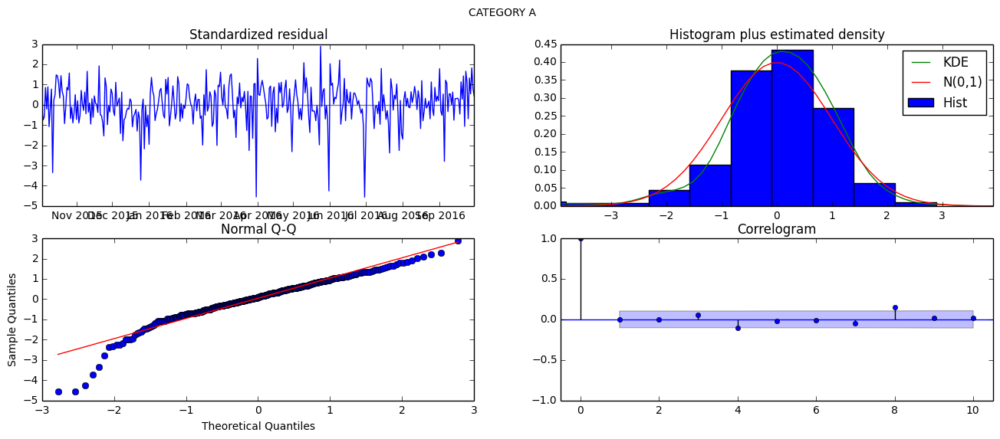

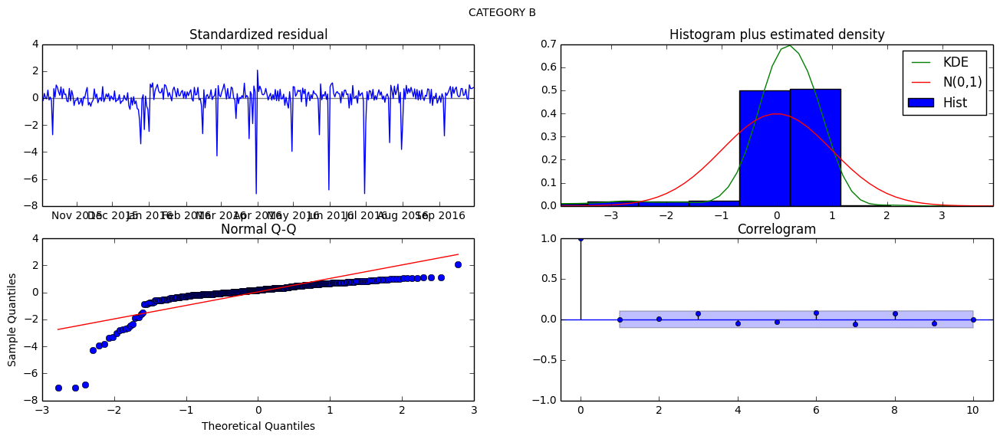

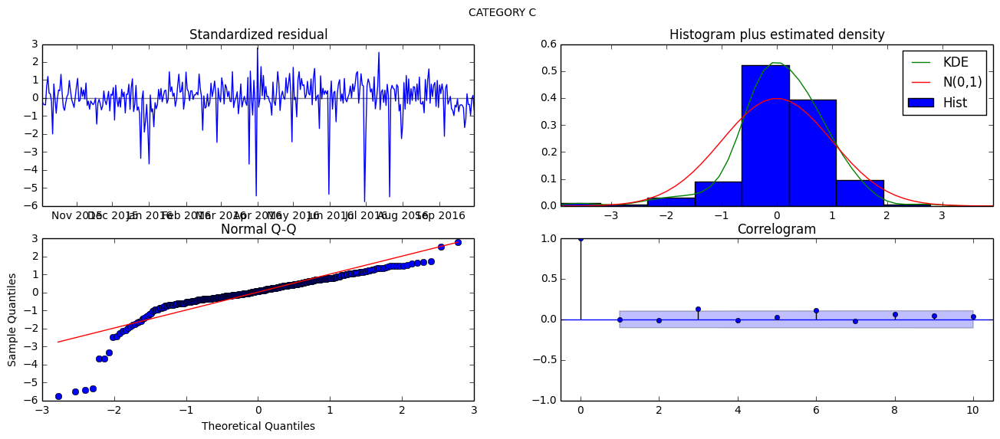

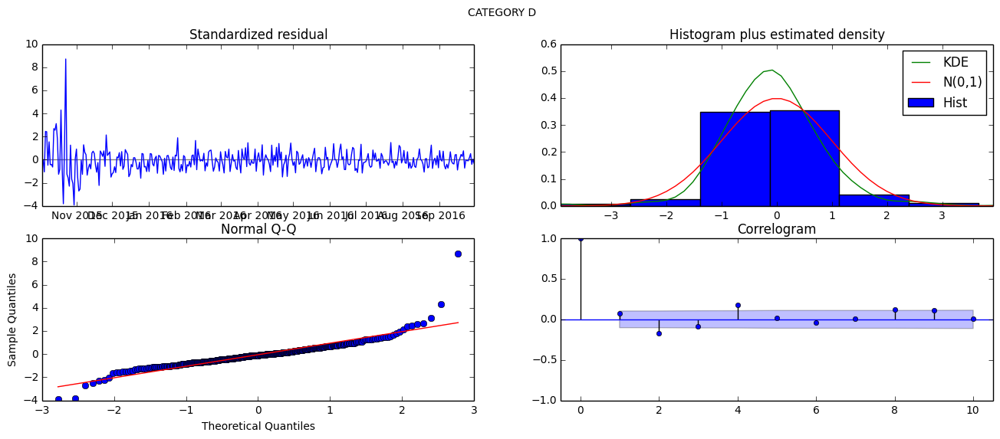

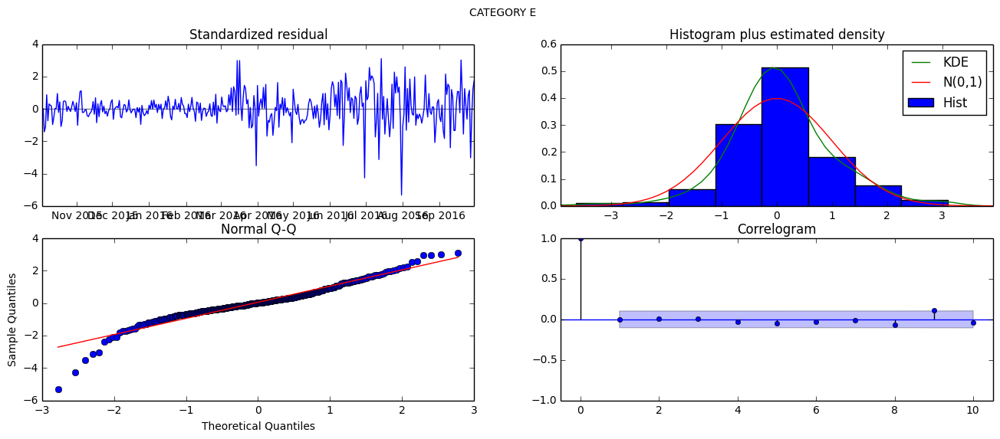

...

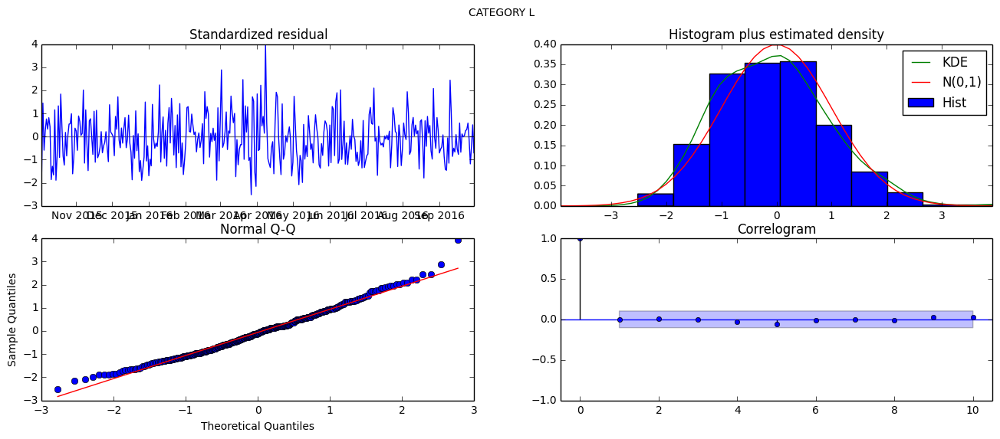

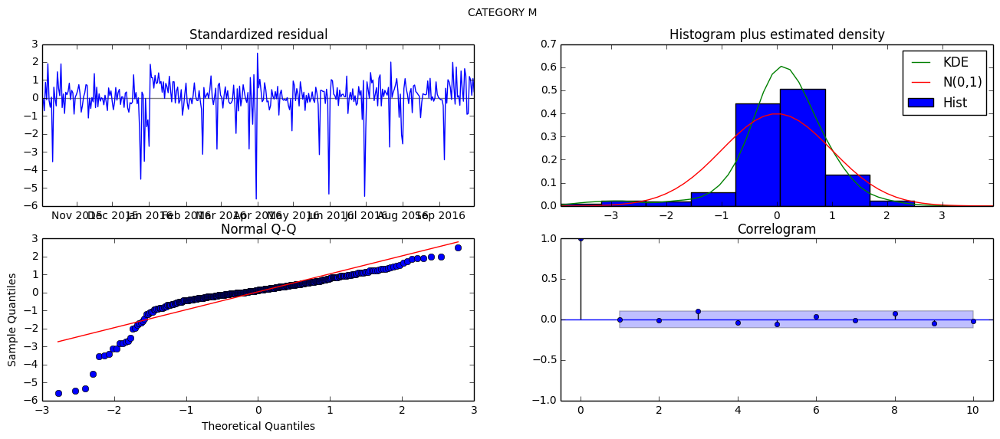

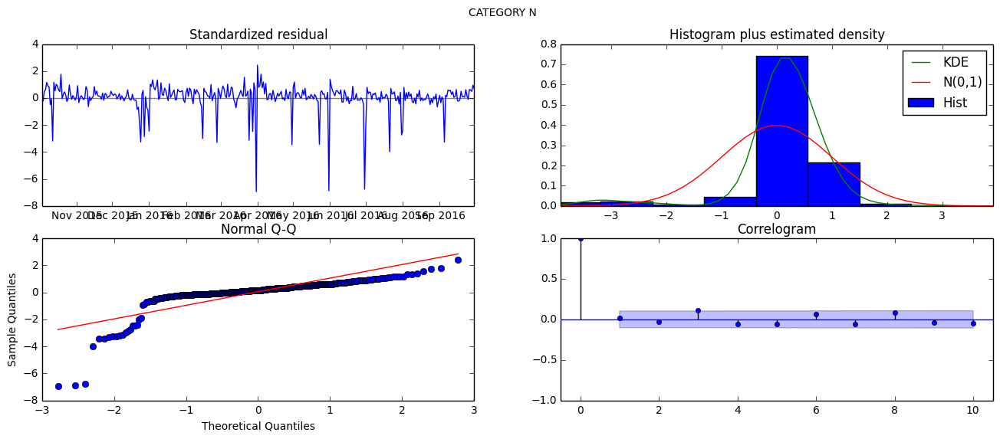

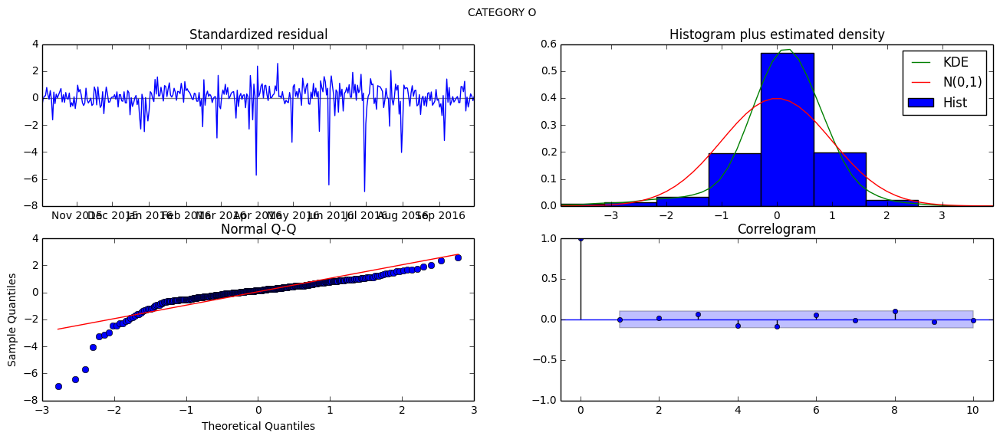

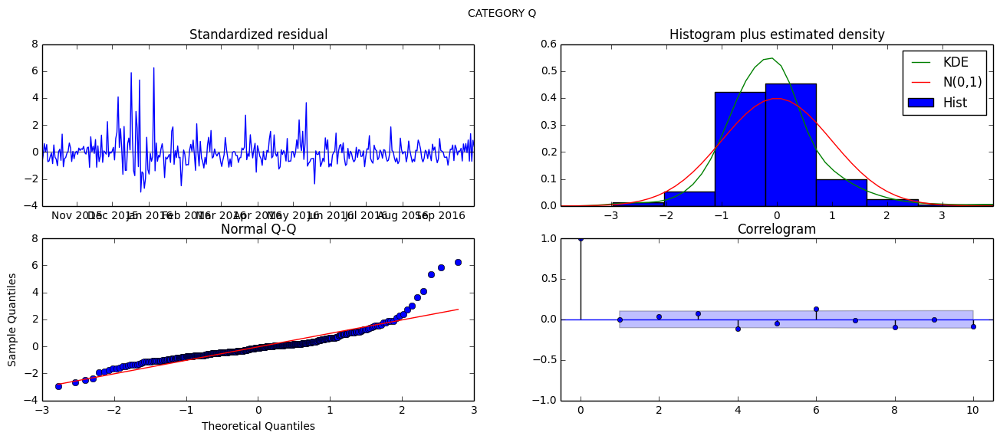

In [40]:
def diagnostic_plot(timeseries, item):
    timeseries.plot_diagnostics()
    plt.suptitle('CATEGORY {}'.format(item))

_ = map(diagnostic_plot, results_obs, temp_list)

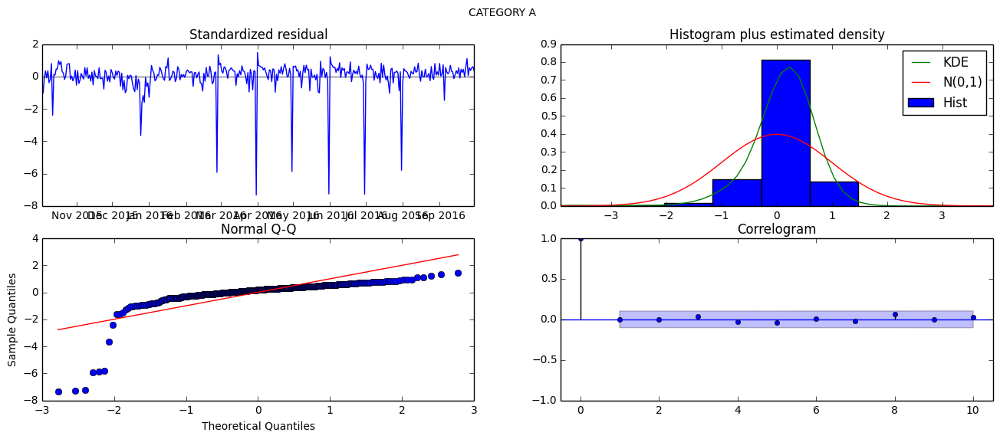

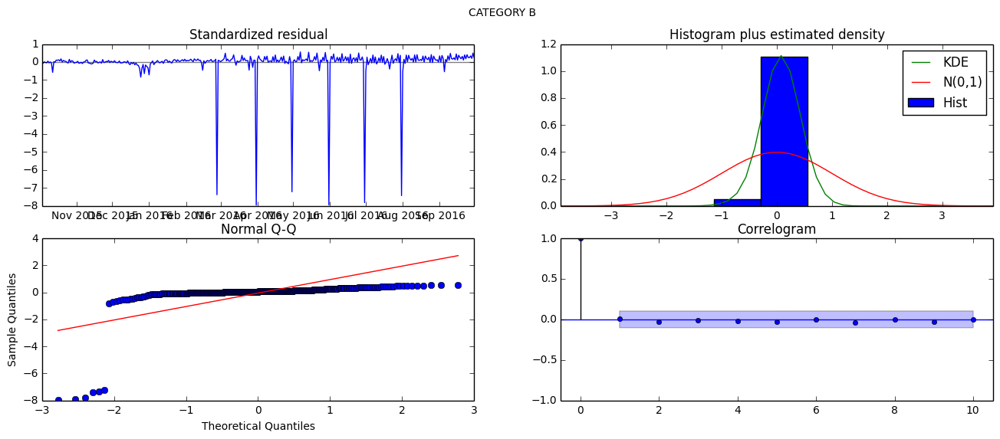

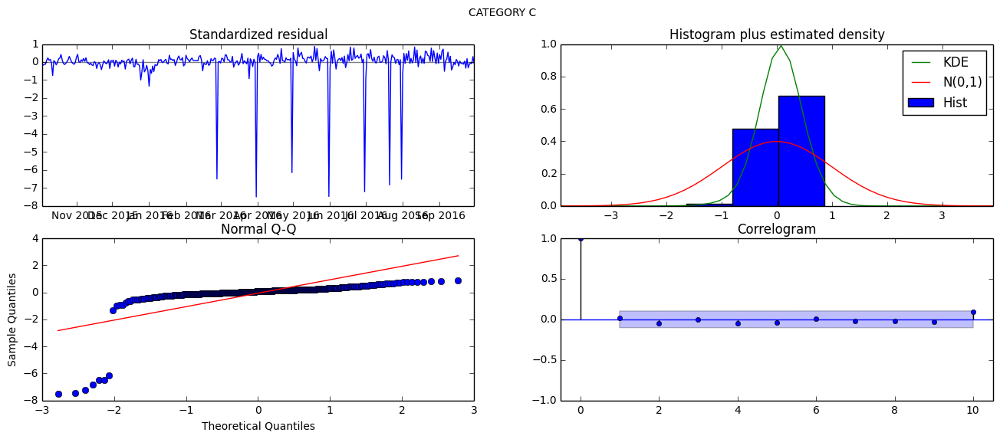

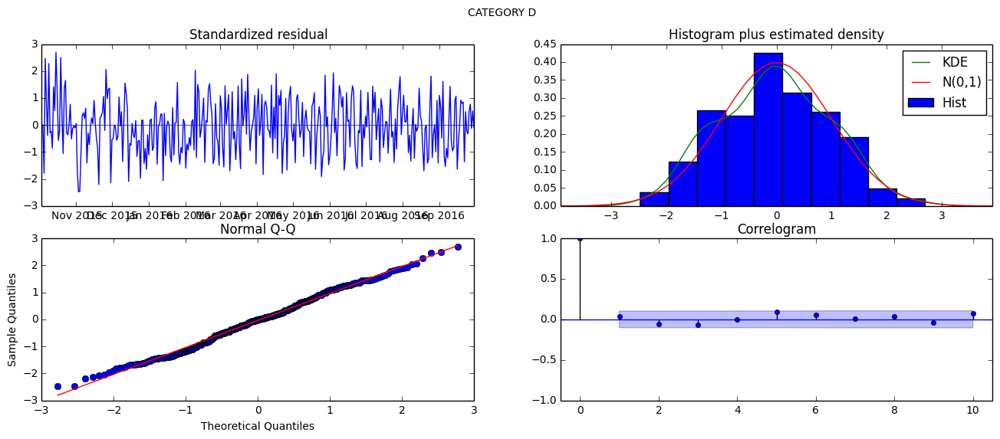

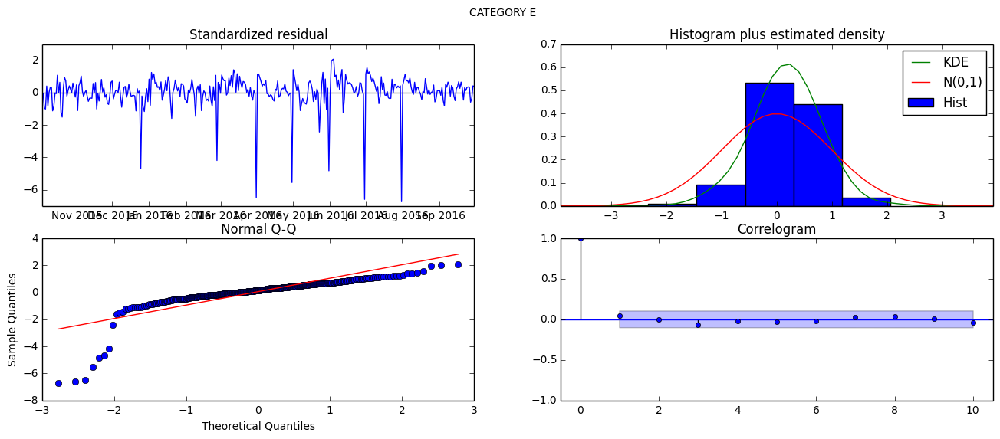

...

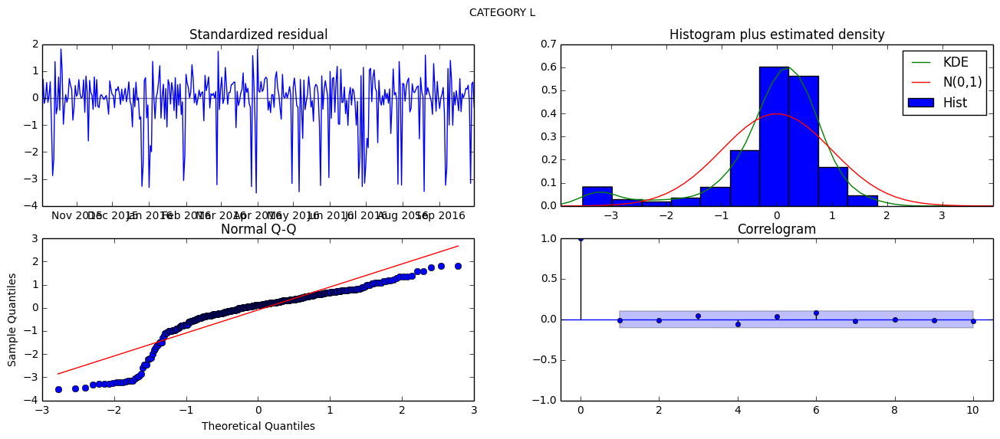

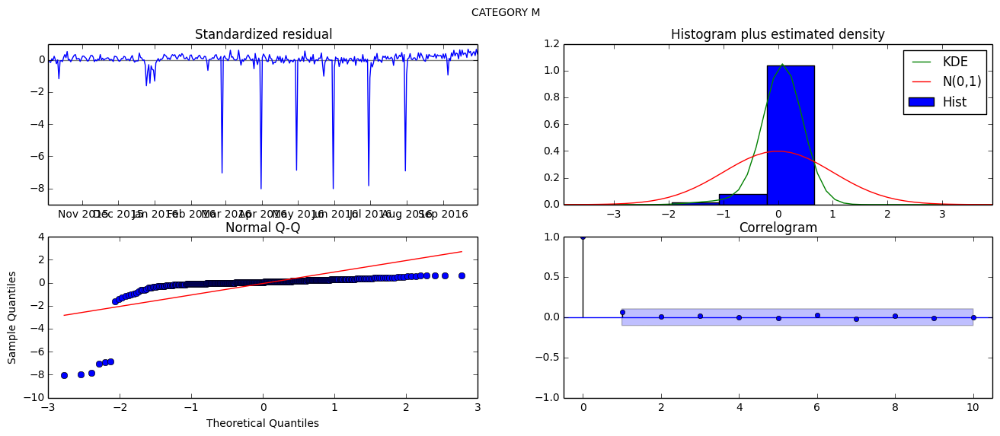

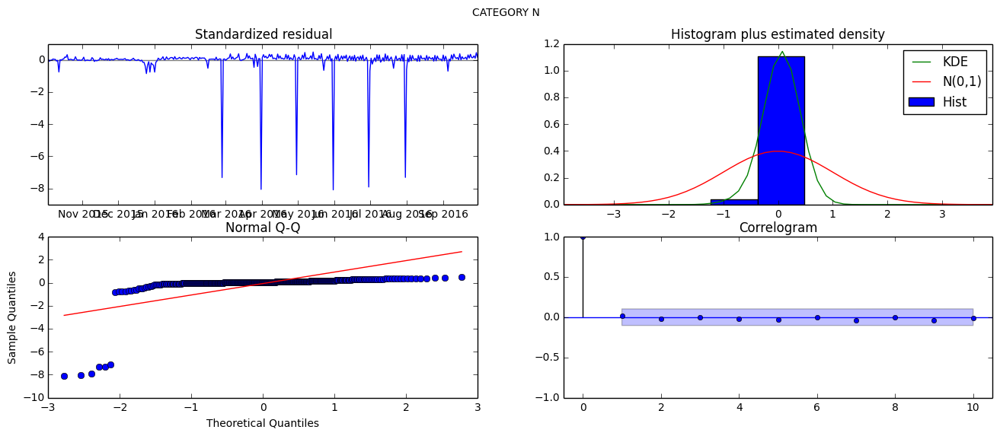

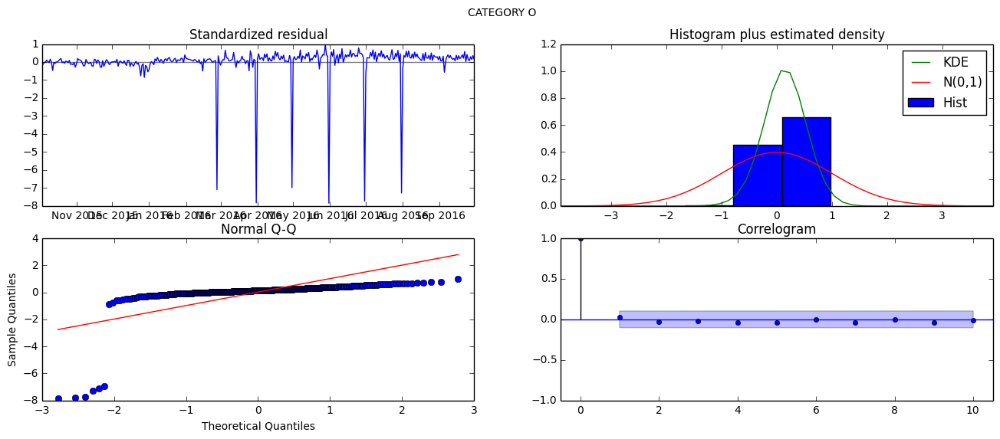

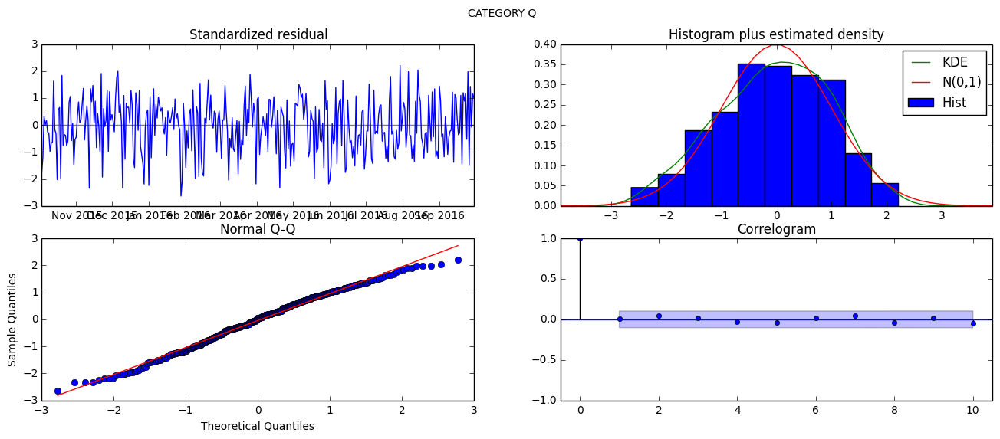

In [41]:
_ = map(diagnostic_plot, results_log, temp_list)

In [ ]:
_ = map(diagnostic_plot, results_obs_one, temp_list)

In [ ]:
_ = map(diagnostic_plot, results_log_one, temp_list)

### The residuals plots mostly look good. Let's move on to forecasting.

# Step 6) Prediction In Sample, and 90 Days Ahead
### - We will plot the forecast for each category
### - Plot the relative contribution from each category
### - Add them up and plot the total forecast
### - Measure the RMSE
### - We will also build a separate model and forecast using top-down approach for comparison (what we did so far is bottom up)

In [46]:
def plot_forecast(results, timeseries, item, inv=True):
    if inv:
        pred = np.sinh(results.predict())
        forecast_90 = np.sinh(results.forecast(steps=90))
    else:    
        pred = results.predict()
        forecast_90 = results.forecast(steps=90)


#     pred.plot(label='predict')
    forecast_90.plot(label='forecast')
    timeseries.plot(label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

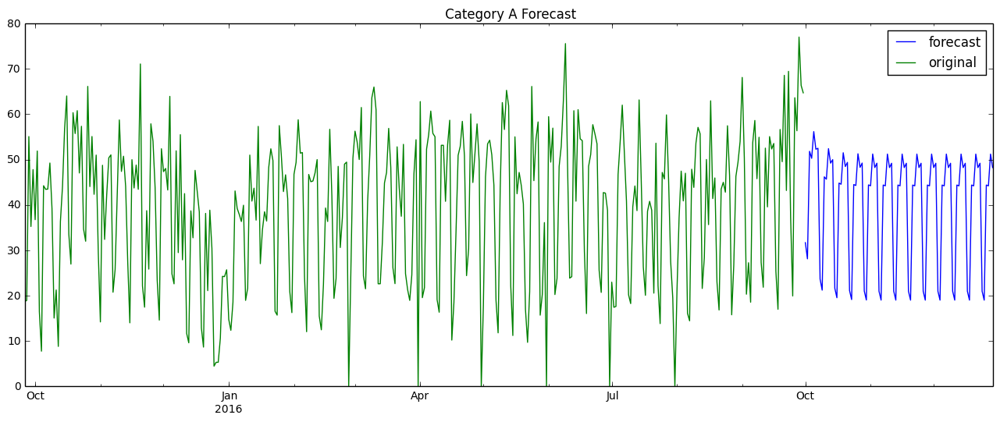

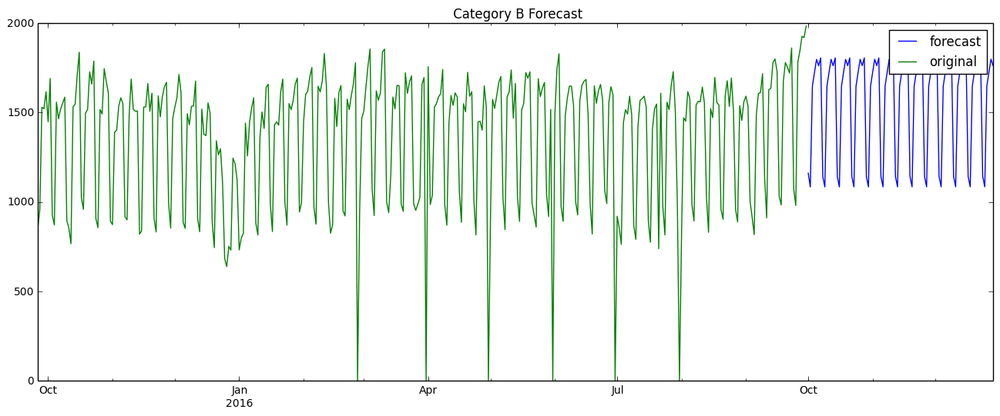

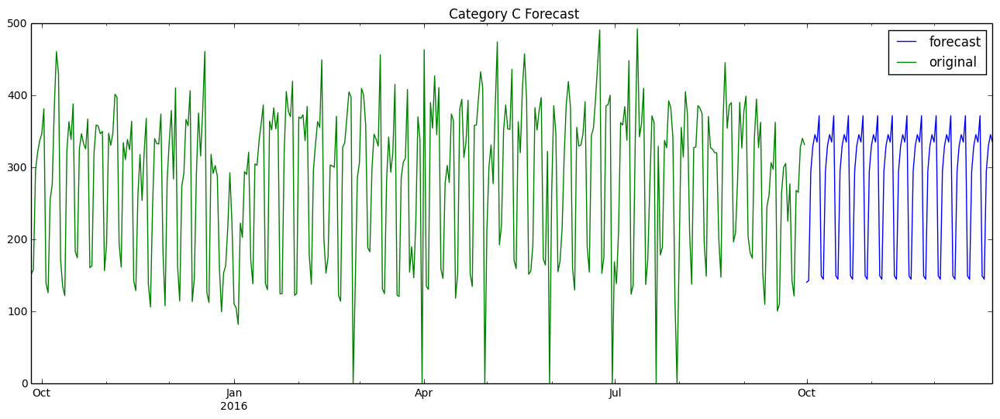

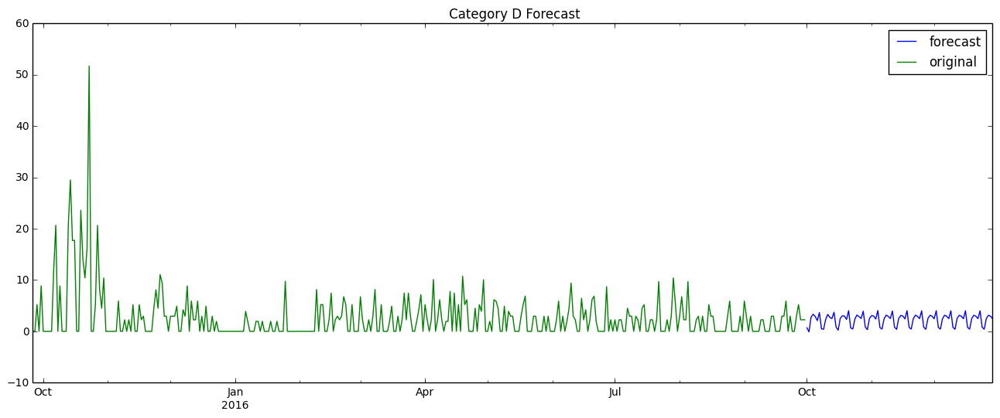

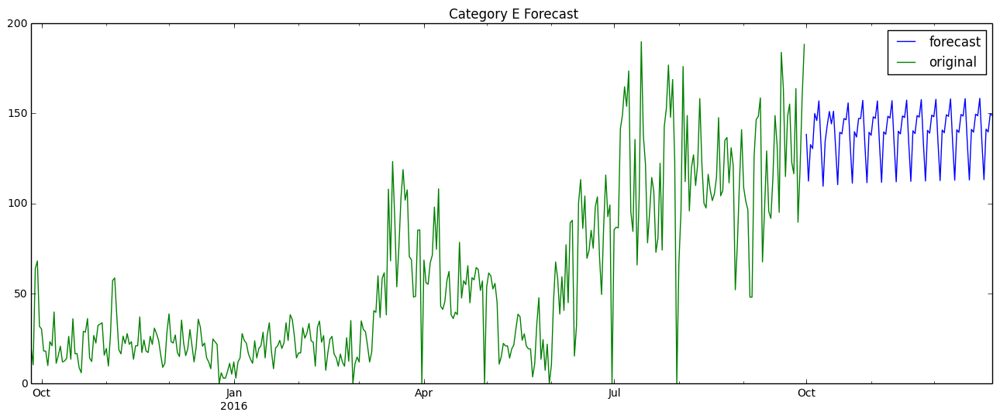

...

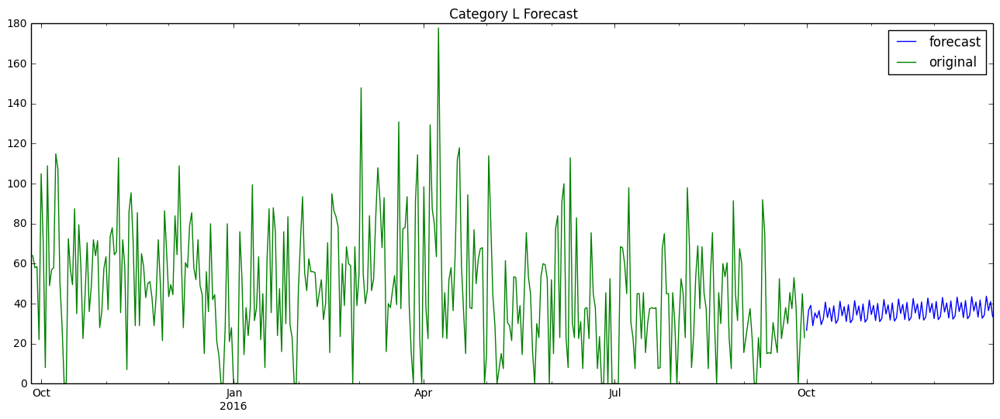

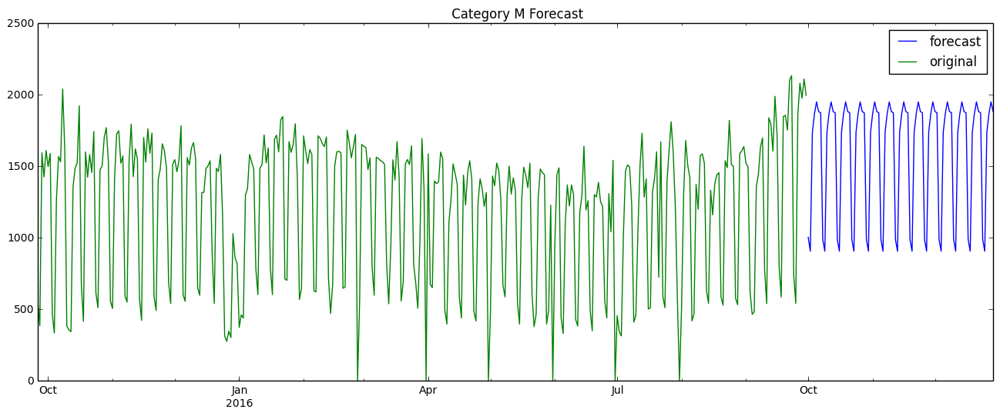

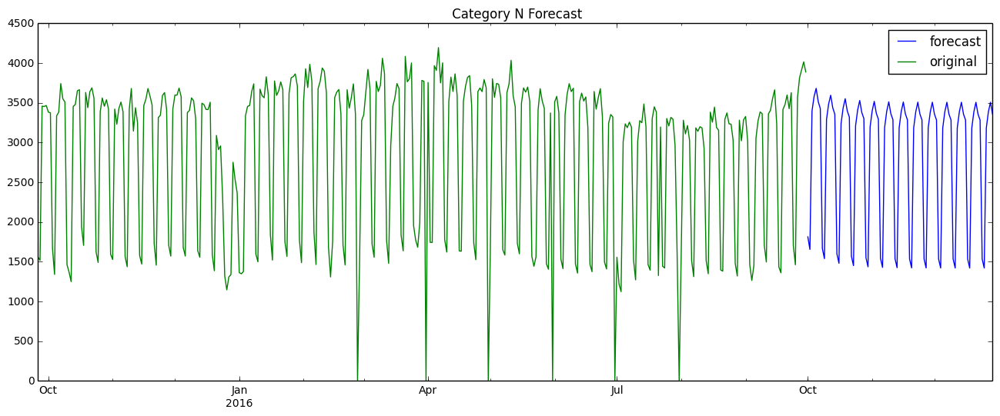

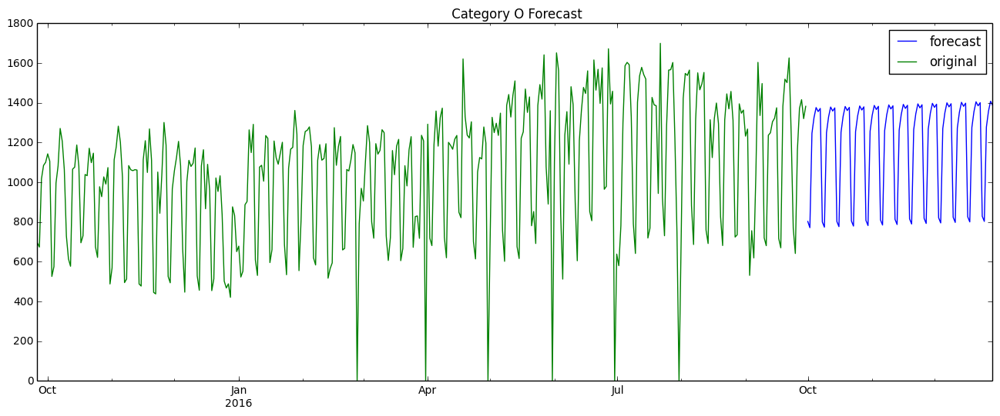

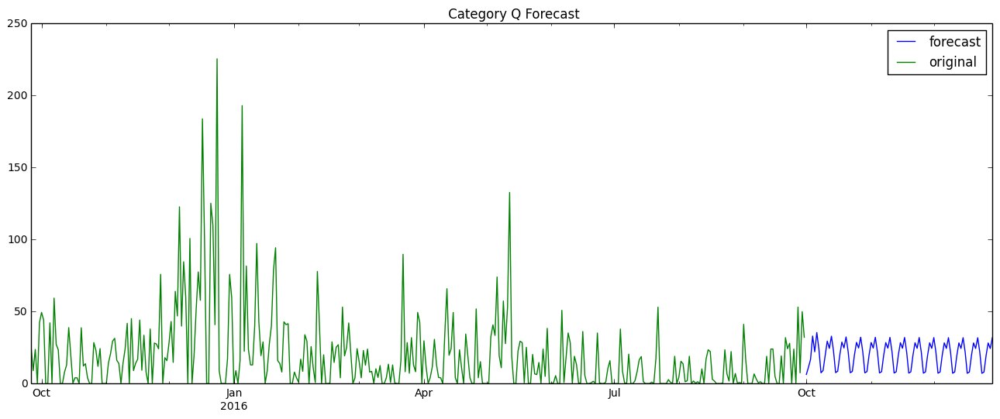

In [45]:
pred_obs = map(plot_forecast, results_obs, splitted_data, temp_list)

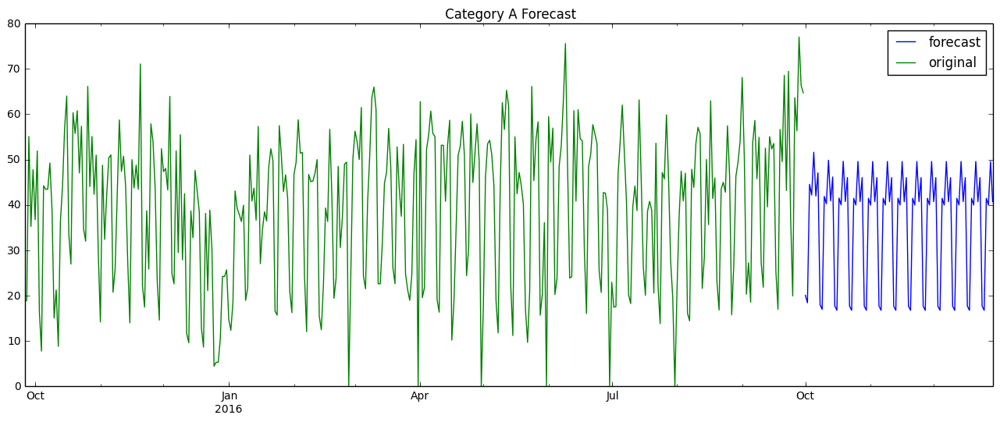

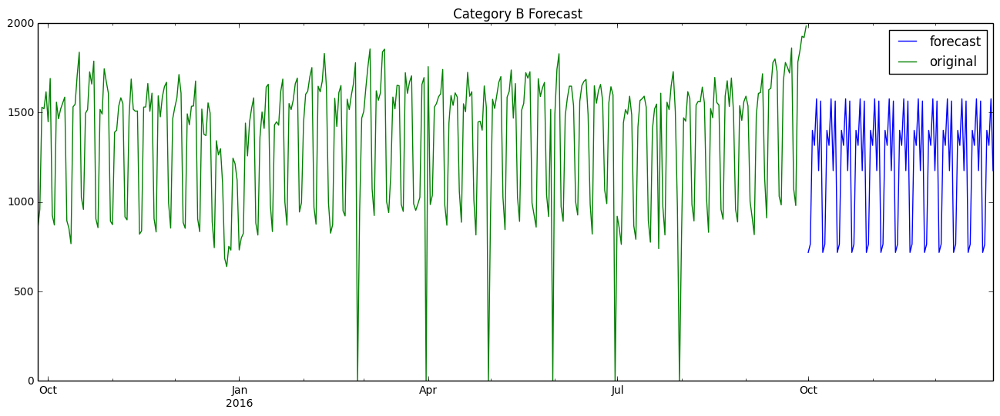

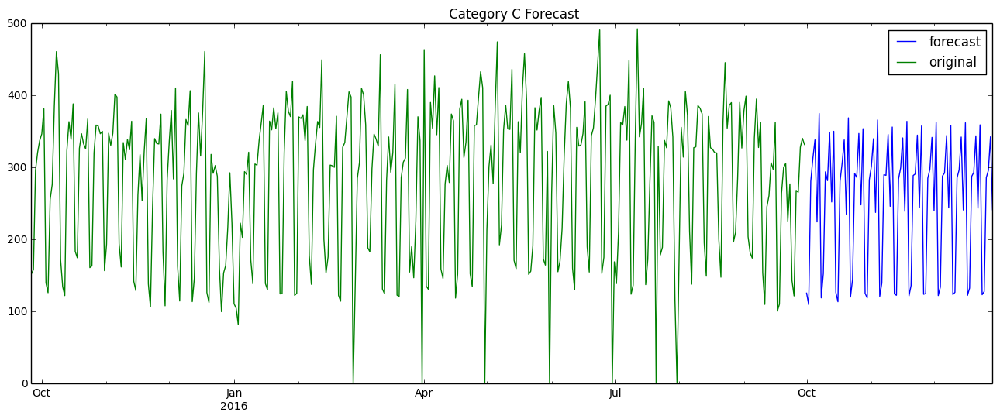

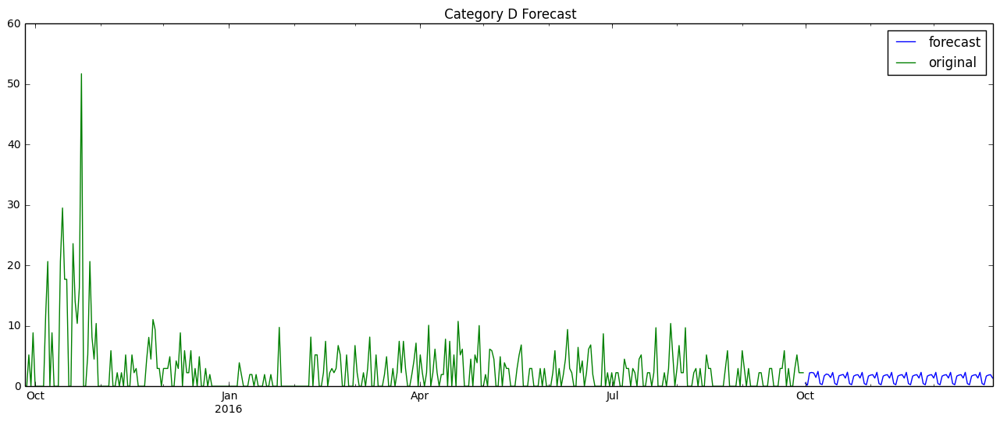

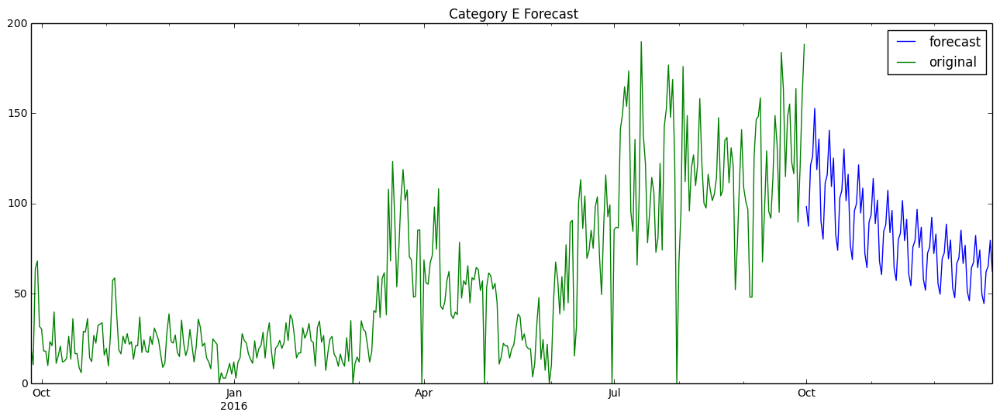

...

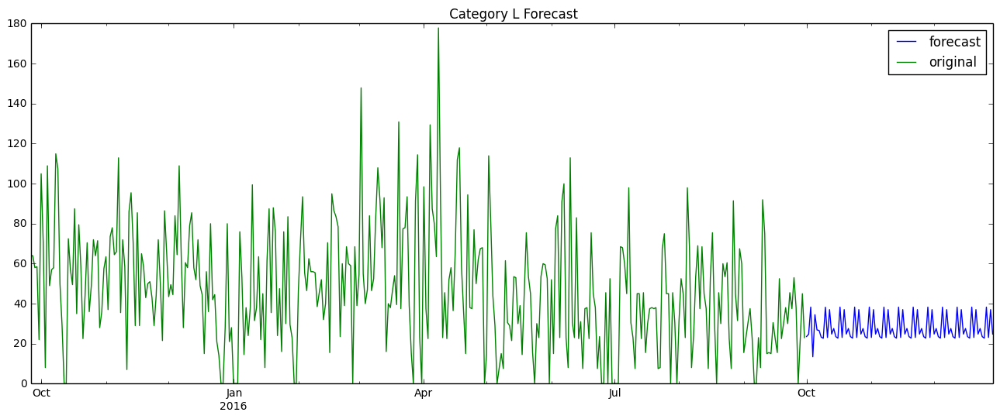

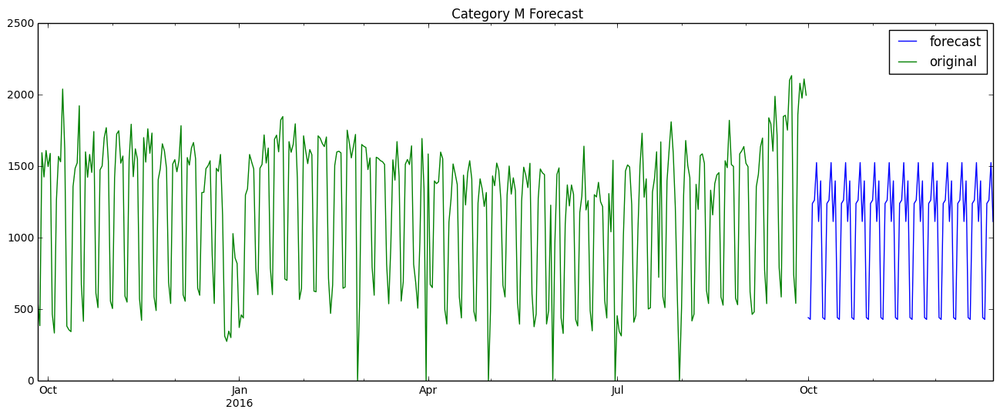

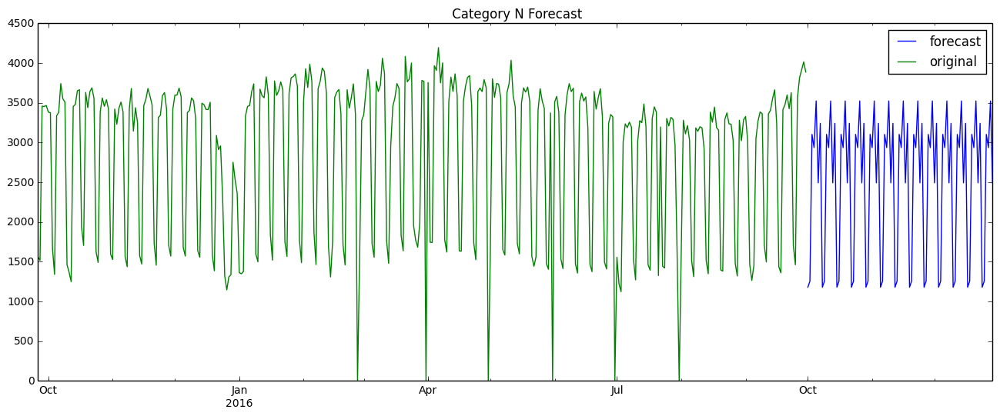

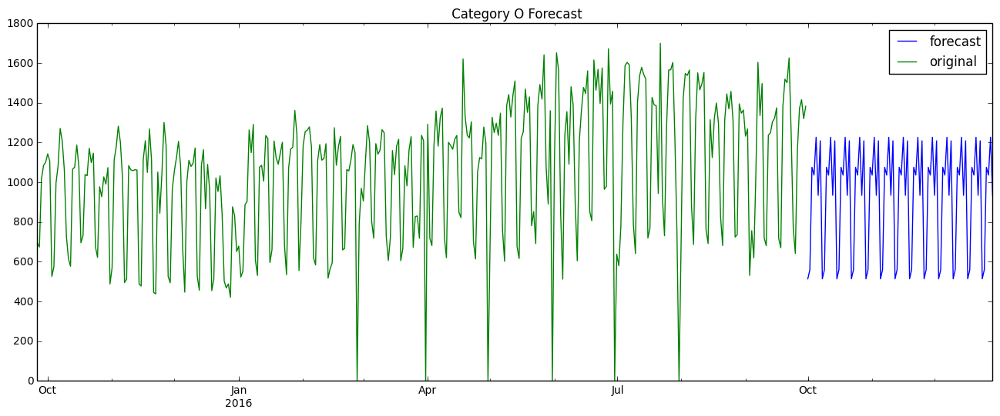

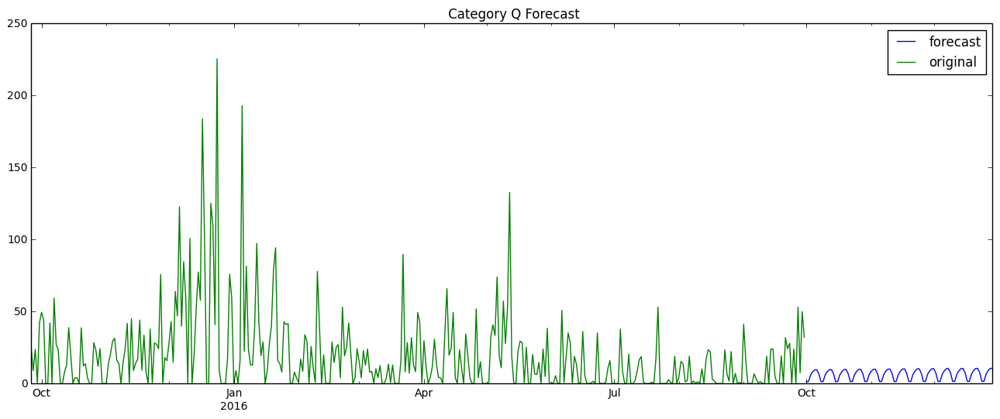

In [47]:
pred_log = map(plot_forecast, results_log, splitted_data, temp_list)

In [ ]:
pred_obs_one = map(plot_forecast, results_obs_one, splitted_data, temp_list)

In [ ]:
pred_log_one = map(plot_forecast, results_log_one, splitted_data, temp_list)

In [48]:
# Report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
#     print('Category {} - RMSE: %.3f'.format(item) % rmse)
    return rmse

In [49]:
rmse_total_obs = map(rmse_measurement, splitted_data, pred_obs, temp_list)
rmse_total_log = map(rmse_measurement, splitted_data, pred_log, temp_list)
# rmse_total_obs_one = map(rmse_measurement, splitted_data, pred_obs_one, temp_list)
# rmse_total_log_one = map(rmse_measurement, splitted_data, pred_log_one, temp_list)

In [50]:
print 'Total RMSE Obs: ', np.sum(rmse_total_obs)
print 'Total RMSE Log: ', np.sum(rmse_total_log)
# print 'Total RMSE Obs One: ', np.sum(rmse_total_obs_one)
# print 'Total RMSE Log One: ', np.sum(rmse_total_log_one)

Total RMSE Obs:  2514.16385611
Total RMSE Log:  2887.88589921


# Total Forecast

In [51]:
forecast_obs = map(lambda x: x.forecast(steps=90), results_obs)
forecast_log = map(lambda x: np.sinh(x.forecast(steps=90)), results_log)
# forecast_obs_one = map(lambda x: x.forecast(steps=90), results_obs_one)
# forecast_log_one = map(lambda x: np.sinh(x.forecast(steps=90)), results_log_one)

In [52]:
def sum_forecast(forecast_90, lab, original=True):
    total_forecast = pd.Series()
    original_sales = pd.Series()
    for i, df in enumerate(forecast_90):
        if i == 0:
            total_forecast = df
            original_sales = splitted_data[i]
        else:
            total_forecast = total_forecast + df
            original_sales = original_sales + splitted_data[i]
    
    if original:
        plt.plot(original_sales.index, original_sales, 'o-', label='Original')
    
    plt.plot(total_forecast.index, total_forecast, 'o-', label='{}'.format(lab))
    plt.legend(loc='lower left')
    return total_forecast

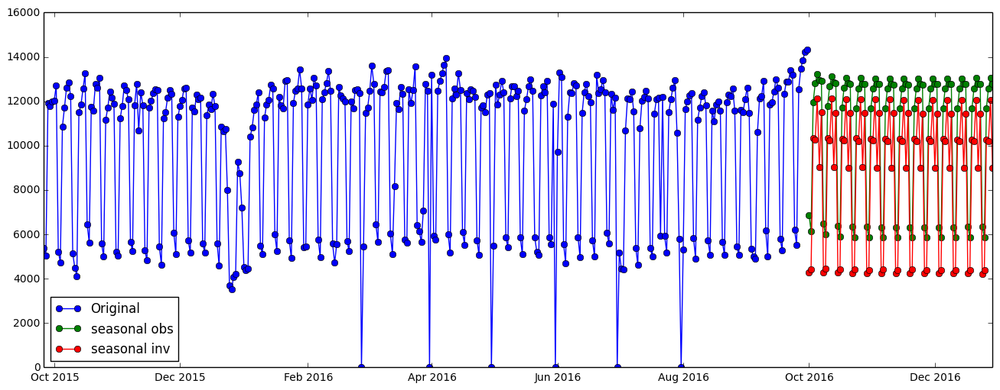

In [53]:
order_zero = sum_forecast(forecast_obs, 'seasonal obs')
_ = sum_forecast(forecast_log, 'seasonal inv', False)
# order_one = sum_forecast(forecast_obs_one, 'seasonal obs ONE', False)
# _ = sum_forecast(forecast_log_one, 'seasonal inv ONE', False)

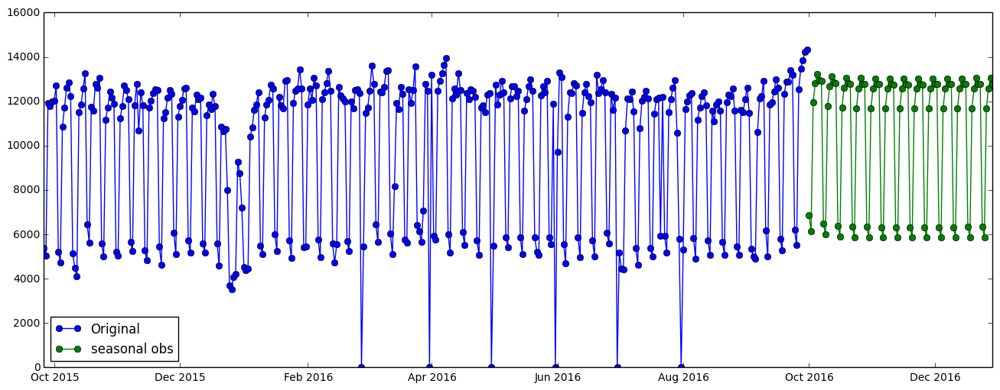

In [55]:
original_sales = pd.Series()
for i in range(15):
    if i == 0:
        original_sales = splitted_data[i]
    else:
        original_sales = original_sales + splitted_data[i]
plt.plot(original_sales.index, original_sales, 'o-', label='Original')   
plt.plot(order_zero.index, order_zero, 'o-', label='seasonal obs')
plt.legend(loc='lower left')

In [ ]:
def relative_cont_plot(forecast_90, item):
    category = forecast_90 / total_forecast
#     print 'Category {}: '.format(item), category.mean()
    if category.mean() >= 0.08:
        print 'Category {} Sales Contribution: '.format(item), category.mean()
    _ = plt.plot(category.index, category, '-o', label=item)
    _ = plt.legend(loc='right')
    _ = plt.title('Relative Contribution from Each Category')

print 'Top contributors are...'
_ = map(relative_cont_plot, forecast_90, temp_list)

# Top Down Approach - Build Model and Forecast on All Categories.

In [102]:
original_sales = pd.Series()
for i, df in enumerate(splitted_data):
    if i == 0:
        original_sales = splitted_data[i]
    else:
        original_sales = original_sales + splitted_data[i]

In [103]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=0)
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64


In [119]:
inversed_sales = np.arcsinh(original_sales)

# 1) Forecast on inversed sales, order 0

In [156]:
total_forecast_inversed = model_building(inversed_sales, 'Total')

# Plot.
total_pred_inversed = np.sinh(total_forecast_inversed.predict())
forecast_90_inversed = np.sinh(total_forecast_inversed.forecast(steps=90))

# total_pred_inversed.plot(label='pred')
original_sales.plot(label='original')
forecast_90_inversed.plot(label='forecast')
plt.legend()

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=904.619
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=898.663
SARIMA(0, 0, 0) (0, 1, 3, 7) AIC=891.310
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=910.275
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=881.862


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=883.234


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 3, 7) AIC=884.065
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=908.716
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=882.027


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=882.056


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 3, 7) AIC=883.738
SARIMA(0, 0, 0) (3, 1, 0, 7) AIC=905.744
SARIMA(0, 0, 0) (3, 1, 1, 7) AIC=883.639


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (3, 1, 2, 7) AIC=883.671


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (3, 1, 3, 7) AIC=884.549
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=814.994
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=760.583
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=750.012
SARIMA(0, 0, 1) (0, 1, 3, 7) AIC=748.525
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=782.678
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=742.665


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=743.931


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 3, 7) AIC=745.931
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=769.861
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=742.851


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=744.918


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 3, 7) AIC=745.329
SARIMA(0, 0, 1) (3, 1, 0, 7) AIC=765.602
SARIMA(0, 0, 1) (3, 1, 1, 7) AIC=743.939


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (3, 1, 2, 7) AIC=745.993


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (3, 1, 3, 7) AIC=746.988
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=777.618
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=696.931
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=692.867
SARIMA(0, 0, 2) (0, 1, 3, 7) AIC=691.999
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=728.561
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=688.875
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=689.666
SARIMA(0, 0, 2) (1, 1, 3, 7) AIC=690.926
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=712.367
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=686.191


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=688.208


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 3, 7) AIC=687.582
SARIMA(0, 0, 2) (3, 1, 0, 7) AIC=709.721
SARIMA(0, 0, 2) (3, 1, 1, 7) AIC=686.239
SARIMA(0, 0, 2) (3, 1, 2, 7) AIC=688.048


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (3, 1, 3, 7) AIC=689.602
SARIMA(0, 0, 3) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (0, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (1, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (2, 1, 3, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 0, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 1, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 2, 7) AIC=nan
SARIMA(0, 0, 3) (3, 1, 3, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=751.552
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=618.504
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=616.357
SARIMA(1, 0, 0) (0, 1, 3, 7) AIC=618.151
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=688.195
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=615.893


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=617.729


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 3, 7) AIC=619.707
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=651.321
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=617.238


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=619.173
SARIMA(1, 0, 0) (2, 1, 3, 7) AIC=614.599
SARIMA(1, 0, 0) (3, 1, 0, 7) AIC=639.624
SARIMA(1, 0, 0) (3, 1, 1, 7) AIC=614.257


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (3, 1, 2, 7) AIC=616.329


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (3, 1, 3, 7) AIC=615.740
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=749.136
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=606.832
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=605.755
SARIMA(1, 0, 1) (0, 1, 3, 7) AIC=607.242
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=678.919
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=605.243


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=606.991


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 3, 7) AIC=608.817
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=641.461
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=606.020


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=608.446


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 3, 7) AIC=603.820
SARIMA(1, 0, 1) (3, 1, 0, 7) AIC=629.753
SARIMA(1, 0, 1) (3, 1, 1, 7) AIC=603.173


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (3, 1, 2, 7) AIC=605.554


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (3, 1, 3, 7) AIC=605.050
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=750.171
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=606.898
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=605.846
SARIMA(1, 0, 2) (0, 1, 3, 7) AIC=607.516
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=680.442
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=605.492


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=607.430


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 3, 7) AIC=609.336
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=643.441
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=606.706


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=609.083


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 3, 7) AIC=604.871
SARIMA(1, 0, 2) (3, 1, 0, 7) AIC=631.394
SARIMA(1, 0, 2) (3, 1, 1, 7) AIC=604.384


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (3, 1, 2, 7) AIC=606.800


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (3, 1, 3, 7) AIC=606.145
SARIMA(1, 0, 3) (0, 1, 0, 7) AIC=751.701
SARIMA(1, 0, 3) (0, 1, 1, 7) AIC=607.648
SARIMA(1, 0, 3) (0, 1, 2, 7) AIC=606.784
SARIMA(1, 0, 3) (0, 1, 3, 7) AIC=608.381
SARIMA(1, 0, 3) (1, 1, 0, 7) AIC=682.211
SARIMA(1, 0, 3) (1, 1, 1, 7) AIC=606.435


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (1, 1, 2, 7) AIC=608.385


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (1, 1, 3, 7) AIC=610.256
SARIMA(1, 0, 3) (2, 1, 0, 7) AIC=645.041
SARIMA(1, 0, 3) (2, 1, 1, 7) AIC=607.555


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (2, 1, 2, 7) AIC=609.652


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (2, 1, 3, 7) AIC=605.962
SARIMA(1, 0, 3) (3, 1, 0, 7) AIC=633.110
SARIMA(1, 0, 3) (3, 1, 1, 7) AIC=605.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (3, 1, 2, 7) AIC=607.601


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 3) (3, 1, 3, 7) AIC=607.203
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=748.607
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=609.163
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=608.024
SARIMA(2, 0, 0) (0, 1, 3, 7) AIC=609.482
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=678.315
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=607.448


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=609.152


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 3, 7) AIC=610.952
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=641.689
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=608.051


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=609.925
SARIMA(2, 0, 0) (2, 1, 3, 7) AIC=605.628
SARIMA(2, 0, 0) (3, 1, 0, 7) AIC=631.052
SARIMA(2, 0, 0) (3, 1, 1, 7) AIC=604.835


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (3, 1, 2, 7) AIC=606.881
SARIMA(2, 0, 0) (3, 1, 3, 7) AIC=606.747
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=750.558
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=605.690
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=604.512


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 3, 7) AIC=606.207
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=680.315
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=604.179


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=606.146


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 3, 7) AIC=608.025
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=643.432


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=605.526


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=607.544


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 3, 7) AIC=604.020
SARIMA(2, 0, 1) (3, 1, 0, 7) AIC=631.262
SARIMA(2, 0, 1) (3, 1, 1, 7) AIC=603.600


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (3, 1, 2, 7) AIC=605.644


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (3, 1, 3, 7) AIC=605.975
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=748.557
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=607.626


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=606.331


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 3, 7) AIC=608.040
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=682.617


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=605.947


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=607.996


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 3, 7) AIC=609.831


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=645.434


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=607.213


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=609.288


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 3, 7) AIC=605.751
SARIMA(2, 0, 2) (3, 1, 0, 7) AIC=633.162
SARIMA(2, 0, 2) (3, 1, 1, 7) AIC=605.232


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (3, 1, 2, 7) AIC=607.396


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (3, 1, 3, 7) AIC=607.115
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` se

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (1, 1, 2, 7) AIC=609.081


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (1, 1, 3, 7) AIC=611.024
SARIMA(3, 0, 0) (2, 1, 0, 7) AIC=643.513
SARIMA(3, 0, 0) (2, 1, 1, 7) AIC=608.328


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (2, 1, 2, 7) AIC=610.311


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (2, 1, 3, 7) AIC=606.096
SARIMA(3, 0, 0) (3, 1, 0, 7) AIC=631.958
SARIMA(3, 0, 0) (3, 1, 1, 7) AIC=605.552


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (3, 1, 2, 7) AIC=607.736


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 0) (3, 1, 3, 7) AIC=607.352
SARIMA(3, 0, 1) (0, 1, 0, 7) AIC=745.849
SARIMA(3, 0, 1) (0, 1, 1, 7) AIC=607.612
SARIMA(3, 0, 1) (0, 1, 2, 7) AIC=606.315
SARIMA(3, 0, 1) (0, 1, 3, 7) AIC=607.955
SARIMA(3, 0, 1) (1, 1, 0, 7) AIC=682.312
SARIMA(3, 0, 1) (1, 1, 1, 7) AIC=605.927


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (1, 1, 2, 7) AIC=607.802


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (1, 1, 3, 7) AIC=609.718
SARIMA(3, 0, 1) (2, 1, 0, 7) AIC=645.180
SARIMA(3, 0, 1) (2, 1, 1, 7) AIC=607.169


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (2, 1, 2, 7) AIC=609.137


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (2, 1, 3, 7) AIC=607.979
SARIMA(3, 0, 1) (3, 1, 0, 7) AIC=633.130
SARIMA(3, 0, 1) (3, 1, 1, 7) AIC=605.237


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (3, 1, 2, 7) AIC=607.130


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 1) (3, 1, 3, 7) AIC=609.709
SARIMA(3, 0, 2) (0, 1, 0, 7) AIC=747.950
SARIMA(3, 0, 2) (0, 1, 1, 7) AIC=609.655
SARIMA(3, 0, 2) (0, 1, 2, 7) AIC=608.338
SARIMA(3, 0, 2) (0, 1, 3, 7) AIC=609.984


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 0, 7) AIC=680.087
SARIMA(3, 0, 2) (1, 1, 1, 7) AIC=607.950


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 2, 7) AIC=609.882


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (1, 1, 3, 7) AIC=612.080
SARIMA(3, 0, 2) (2, 1, 0, 7) AIC=644.335
SARIMA(3, 0, 2) (2, 1, 1, 7) AIC=609.208


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (2, 1, 2, 7) AIC=611.265


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (2, 1, 3, 7) AIC=608.062
SARIMA(3, 0, 2) (3, 1, 0, 7) AIC=635.215


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 1, 7) AIC=607.308


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 2, 7) AIC=609.518


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 0, 2) (3, 1, 3, 7) AIC=609.524
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` se

# Forecast on inversed sales, order 1

In [177]:
total_forecast_inversed_order_1 = model_building(inversed_sales, 'Total')

# Plot.
total_pred_inversed_order_1 = np.sinh(total_forecast_inversed_order_1.predict())
forecast_90_inversed_order_1 = np.sinh(total_forecast_inversed_order_1.forecast(steps=90))

# total_pred_inversed_order_1.plot(label='pred')
original_sales.plot(label='original')
forecast_90_inversed_order_1.plot(label='forecast')
plt.legend()

could not broadcast input array from shape (0,0) into shape (8,8)
SARIMA(0, 1, 0) (0, 1, 1, 7) AIC=653.005
SARIMA(0, 1, 0) (0, 1, 2, 7) AIC=652.355
SARIMA(0, 1, 0) (0, 1, 3, 7) AIC=654.354
SARIMA(0, 1, 0) (1, 1, 0, 7) AIC=744.899
SARIMA(0, 1, 0) (1, 1, 1, 7) AIC=652.301
SARIMA(0, 1, 0) (1, 1, 2, 7) AIC=653.797
SARIMA(0, 1, 0) (1, 1, 3, 7) AIC=655.622
SARIMA(0, 1, 0) (2, 1, 0, 7) AIC=695.065
SARIMA(0, 1, 0) (2, 1, 1, 7) AIC=654.219
SARIMA(0, 1, 0) (2, 1, 2, 7) AIC=655.553


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 3, 7) AIC=651.780
SARIMA(0, 1, 0) (3, 1, 0, 7) AIC=678.196
SARIMA(0, 1, 0) (3, 1, 1, 7) AIC=651.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 2, 7) AIC=653.108


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 3, 7) AIC=651.941
SARIMA(0, 1, 1) (0, 1, 0, 7) AIC=789.038
SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=621.691
SARIMA(0, 1, 1) (0, 1, 2, 7) AIC=621.381
SARIMA(0, 1, 1) (0, 1, 3, 7) AIC=622.933
SARIMA(0, 1, 1) (1, 1, 0, 7) AIC=704.314
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=621.072


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 2, 7) AIC=623.008


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 3, 7) AIC=624.793
SARIMA(0, 1, 1) (2, 1, 0, 7) AIC=661.838
SARIMA(0, 1, 1) (2, 1, 1, 7) AIC=622.068


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 2, 7) AIC=624.212


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 3, 7) AIC=620.255
SARIMA(0, 1, 1) (3, 1, 0, 7) AIC=647.720
SARIMA(0, 1, 1) (3, 1, 1, 7) AIC=619.527


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 2, 7) AIC=621.621


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 3, 7) AIC=621.441
SARIMA(0, 1, 2) (0, 1, 0, 7) AIC=789.451
SARIMA(0, 1, 2) (0, 1, 1, 7) AIC=615.984
SARIMA(0, 1, 2) (0, 1, 2, 7) AIC=615.562
SARIMA(0, 1, 2) (0, 1, 3, 7) AIC=617.406
SARIMA(0, 1, 2) (1, 1, 0, 7) AIC=704.830
SARIMA(0, 1, 2) (1, 1, 1, 7) AIC=615.402


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 2, 7) AIC=617.435
SARIMA(0, 1, 2) (1, 1, 3, 7) AIC=619.551
SARIMA(0, 1, 2) (2, 1, 0, 7) AIC=661.780
SARIMA(0, 1, 2) (2, 1, 1, 7) AIC=617.052
SARIMA(0, 1, 2) (2, 1, 2, 7) AIC=619.401


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (2, 1, 3, 7) AIC=616.205
SARIMA(0, 1, 2) (3, 1, 0, 7) AIC=645.747
SARIMA(0, 1, 2) (3, 1, 1, 7) AIC=615.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 2, 7) AIC=617.952


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 3, 7) AIC=617.648
SARIMA(0, 1, 3) (0, 1, 0, 7) AIC=786.091
SARIMA(0, 1, 3) (0, 1, 1, 7) AIC=614.938
SARIMA(0, 1, 3) (0, 1, 2, 7) AIC=614.306
SARIMA(0, 1, 3) (0, 1, 3, 7) AIC=616.044
SARIMA(0, 1, 3) (1, 1, 0, 7) AIC=701.874
SARIMA(0, 1, 3) (1, 1, 1, 7) AIC=614.084


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 2, 7) AIC=616.146
SARIMA(0, 1, 3) (1, 1, 3, 7) AIC=618.306
SARIMA(0, 1, 3) (2, 1, 0, 7) AIC=660.046
SARIMA(0, 1, 3) (2, 1, 1, 7) AIC=615.572


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 2, 7) AIC=617.731


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 3, 7) AIC=614.902
SARIMA(0, 1, 3) (3, 1, 0, 7) AIC=645.604
SARIMA(0, 1, 3) (3, 1, 1, 7) AIC=614.444


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 2, 7) AIC=616.607


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 3, 7) AIC=616.388
SARIMA(1, 1, 0) (0, 1, 0, 7) AIC=795.423
SARIMA(1, 1, 0) (0, 1, 1, 7) AIC=630.880
SARIMA(1, 1, 0) (0, 1, 2, 7) AIC=630.604
SARIMA(1, 1, 0) (0, 1, 3, 7) AIC=632.226
SARIMA(1, 1, 0) (1, 1, 0, 7) AIC=711.007
SARIMA(1, 1, 0) (1, 1, 1, 7) AIC=630.292
SARIMA(1, 1, 0) (1, 1, 2, 7) AIC=632.889
SARIMA(1, 1, 0) (1, 1, 3, 7) AIC=634.465
SARIMA(1, 1, 0) (2, 1, 0, 7) AIC=667.830
SARIMA(1, 1, 0) (2, 1, 1, 7) AIC=631.244


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 2, 7) AIC=633.288


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 3, 7) AIC=628.754
SARIMA(1, 1, 0) (3, 1, 0, 7) AIC=655.115
SARIMA(1, 1, 0) (3, 1, 1, 7) AIC=627.638


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 2, 7) AIC=629.700


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 3, 7) AIC=629.447
SARIMA(1, 1, 1) (0, 1, 0, 7) AIC=756.443
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=612.430
SARIMA(1, 1, 1) (0, 1, 2, 7) AIC=610.888
SARIMA(1, 1, 1) (0, 1, 3, 7) AIC=612.727
SARIMA(1, 1, 1) (1, 1, 0, 7) AIC=702.057
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=610.643


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 2, 7) AIC=612.758
SARIMA(1, 1, 1) (1, 1, 3, 7) AIC=614.844
SARIMA(1, 1, 1) (2, 1, 0, 7) AIC=659.243
SARIMA(1, 1, 1) (2, 1, 1, 7) AIC=612.356
SARIMA(1, 1, 1) (2, 1, 2, 7) AIC=614.588


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 3, 7) AIC=611.968
SARIMA(1, 1, 1) (3, 1, 0, 7) AIC=643.488
SARIMA(1, 1, 1) (3, 1, 1, 7) AIC=611.606


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 2, 7) AIC=614.045


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 3, 7) AIC=616.103
SARIMA(1, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(1, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 2, 7) AIC=626.743
SARIMA(2, 1, 0) (1, 1, 3, 7) AIC=628.868
SARIMA(2, 1, 0) (2, 1, 0, 7) AIC=666.443
SARIMA(2, 1, 0) (2, 1, 1, 7) AIC=626.268
SARIMA(2, 1, 0) (2, 1, 2, 7) AIC=628.670


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (2, 1, 3, 7) AIC=624.322
SARIMA(2, 1, 0) (3, 1, 0, 7) AIC=651.525
SARIMA(2, 1, 0) (3, 1, 1, 7) AIC=623.802


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 2, 7) AIC=626.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 3, 7) AIC=625.536
SARIMA(2, 1, 1) (0, 1, 0, 7) AIC=753.266
SARIMA(2, 1, 1) (0, 1, 1, 7) AIC=614.215
SARIMA(2, 1, 1) (0, 1, 2, 7) AIC=612.126
SARIMA(2, 1, 1) (0, 1, 3, 7) AIC=613.788
SARIMA(2, 1, 1) (1, 1, 0, 7) AIC=683.311
SARIMA(2, 1, 1) (1, 1, 1, 7) AIC=611.677


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 2, 7) AIC=613.768
SARIMA(2, 1, 1) (1, 1, 3, 7) AIC=616.125
SARIMA(2, 1, 1) (2, 1, 0, 7) AIC=646.938
SARIMA(2, 1, 1) (2, 1, 1, 7) AIC=613.044
SARIMA(2, 1, 1) (2, 1, 2, 7) AIC=615.677


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 3, 7) AIC=612.348


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 0, 7) AIC=636.515
SARIMA(2, 1, 1) (3, 1, 1, 7) AIC=611.410


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 2, 7) AIC=613.810


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 3, 7) AIC=613.816
SARIMA(2, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 2, 7) AIC=624.464
SARIMA(3, 1, 0) (1, 1, 3, 7) AIC=626.701
SARIMA(3, 1, 0) (2, 1, 0, 7) AIC=665.189
SARIMA(3, 1, 0) (2, 1, 1, 7) AIC=623.853


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (2, 1, 2, 7) AIC=625.971
SARIMA(3, 1, 0) (2, 1, 3, 7) AIC=622.318
SARIMA(3, 1, 0) (3, 1, 0, 7) AIC=650.269
SARIMA(3, 1, 0) (3, 1, 1, 7) AIC=621.772


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 2, 7) AIC=623.836


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 3, 7) AIC=623.789
SARIMA(3, 1, 1) (0, 1, 0, 7) AIC=755.196
SARIMA(3, 1, 1) (0, 1, 1, 7) AIC=616.125
SARIMA(3, 1, 1) (0, 1, 2, 7) AIC=613.891
SARIMA(3, 1, 1) (0, 1, 3, 7) AIC=615.469


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 0, 7) AIC=685.307
SARIMA(3, 1, 1) (1, 1, 1, 7) AIC=613.340


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 2, 7) AIC=615.488


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 3, 7) AIC=617.641


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 0, 7) AIC=648.716
SARIMA(3, 1, 1) (2, 1, 1, 7) AIC=614.555


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 2, 7) AIC=617.165


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 3, 7) AIC=613.305
SARIMA(3, 1, 1) (3, 1, 0, 7) AIC=637.316


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 1, 7) AIC=612.517


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 2, 7) AIC=614.647


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 3, 7) AIC=614.742
SARIMA(3, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(3, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_statio

# Forecast on original sales. Order 1

could not broadcast input array from shape (0,0) into shape (8,8)
SARIMA(0, 1, 0) (0, 1, 1, 7) AIC=8018.076
SARIMA(0, 1, 0) (0, 1, 2, 7) AIC=8000.468
SARIMA(0, 1, 0) (0, 1, 3, 7) AIC=7995.907
SARIMA(0, 1, 0) (1, 1, 0, 7) AIC=8037.734
SARIMA(0, 1, 0) (1, 1, 1, 7) AIC=7989.133
SARIMA(0, 1, 0) (1, 1, 2, 7) AIC=7990.548


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (1, 1, 3, 7) AIC=7993.106
SARIMA(0, 1, 0) (2, 1, 0, 7) AIC=8024.672
SARIMA(0, 1, 0) (2, 1, 1, 7) AIC=7988.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 2, 7) AIC=7990.942


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (2, 1, 3, 7) AIC=7992.985
SARIMA(0, 1, 0) (3, 1, 0, 7) AIC=8025.144
SARIMA(0, 1, 0) (3, 1, 1, 7) AIC=7990.249
SARIMA(0, 1, 0) (3, 1, 2, 7) AIC=7991.616


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 0) (3, 1, 3, 7) AIC=7993.315
SARIMA(0, 1, 1) (0, 1, 0, 7) AIC=8059.054
SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=8010.882
SARIMA(0, 1, 1) (0, 1, 2, 7) AIC=8001.758
SARIMA(0, 1, 1) (0, 1, 3, 7) AIC=7997.761
SARIMA(0, 1, 1) (1, 1, 0, 7) AIC=8026.036
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=7991.833


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 2, 7) AIC=7982.196


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (1, 1, 3, 7) AIC=7995.142
SARIMA(0, 1, 1) (2, 1, 0, 7) AIC=8017.027
SARIMA(0, 1, 1) (2, 1, 1, 7) AIC=7992.247


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 2, 7) AIC=7994.263


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (2, 1, 3, 7) AIC=7996.055
SARIMA(0, 1, 1) (3, 1, 0, 7) AIC=8016.041
SARIMA(0, 1, 1) (3, 1, 1, 7) AIC=7994.138
SARIMA(0, 1, 1) (3, 1, 2, 7) AIC=7995.817


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 1) (3, 1, 3, 7) AIC=7996.697
SARIMA(0, 1, 2) (0, 1, 0, 7) AIC=8059.327
SARIMA(0, 1, 2) (0, 1, 1, 7) AIC=8000.072
SARIMA(0, 1, 2) (0, 1, 2, 7) AIC=7990.387
SARIMA(0, 1, 2) (0, 1, 3, 7) AIC=7988.955
SARIMA(0, 1, 2) (1, 1, 0, 7) AIC=8022.064
SARIMA(0, 1, 2) (1, 1, 1, 7) AIC=7984.647


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 2, 7) AIC=7972.046


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (1, 1, 3, 7) AIC=7988.049
SARIMA(0, 1, 2) (2, 1, 0, 7) AIC=8009.506
SARIMA(0, 1, 2) (2, 1, 1, 7) AIC=7985.213


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (2, 1, 2, 7) AIC=7987.213
SARIMA(0, 1, 2) (2, 1, 3, 7) AIC=7988.692
SARIMA(0, 1, 2) (3, 1, 0, 7) AIC=8008.087
SARIMA(0, 1, 2) (3, 1, 1, 7) AIC=7986.726
SARIMA(0, 1, 2) (3, 1, 2, 7) AIC=7988.418


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 2) (3, 1, 3, 7) AIC=7989.751
SARIMA(0, 1, 3) (0, 1, 0, 7) AIC=8061.443
SARIMA(0, 1, 3) (0, 1, 1, 7) AIC=7993.430
SARIMA(0, 1, 3) (0, 1, 2, 7) AIC=7981.611
SARIMA(0, 1, 3) (0, 1, 3, 7) AIC=7979.971
SARIMA(0, 1, 3) (1, 1, 0, 7) AIC=8018.551
SARIMA(0, 1, 3) (1, 1, 1, 7) AIC=7975.928


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 2, 7) AIC=7977.338


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (1, 1, 3, 7) AIC=7979.319
SARIMA(0, 1, 3) (2, 1, 0, 7) AIC=8004.658
SARIMA(0, 1, 3) (2, 1, 1, 7) AIC=7976.594


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 2, 7) AIC=7978.596


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (2, 1, 3, 7) AIC=7980.131
SARIMA(0, 1, 3) (3, 1, 0, 7) AIC=8002.998
SARIMA(0, 1, 3) (3, 1, 1, 7) AIC=7978.214
SARIMA(0, 1, 3) (3, 1, 2, 7) AIC=7979.785


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 1, 3) (3, 1, 3, 7) AIC=7980.398
SARIMA(1, 1, 0) (0, 1, 0, 7) AIC=8061.906
SARIMA(1, 1, 0) (0, 1, 1, 7) AIC=8013.645
SARIMA(1, 1, 0) (0, 1, 2, 7) AIC=8003.789
SARIMA(1, 1, 0) (0, 1, 3, 7) AIC=7999.889
SARIMA(1, 1, 0) (1, 1, 0, 7) AIC=8029.266
SARIMA(1, 1, 0) (1, 1, 1, 7) AIC=7994.035
SARIMA(1, 1, 0) (1, 1, 2, 7) AIC=7985.060


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (1, 1, 3, 7) AIC=7997.399
SARIMA(1, 1, 0) (2, 1, 0, 7) AIC=8019.885
SARIMA(1, 1, 0) (2, 1, 1, 7) AIC=7994.565


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 2, 7) AIC=7996.586


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (2, 1, 3, 7) AIC=7998.304
SARIMA(1, 1, 0) (3, 1, 0, 7) AIC=8018.896
SARIMA(1, 1, 0) (3, 1, 1, 7) AIC=7996.440
SARIMA(1, 1, 0) (3, 1, 2, 7) AIC=7998.047


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 0) (3, 1, 3, 7) AIC=7998.715
SARIMA(1, 1, 1) (0, 1, 0, 7) AIC=8027.573
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=7988.577
SARIMA(1, 1, 1) (0, 1, 2, 7) AIC=7979.969
SARIMA(1, 1, 1) (0, 1, 3, 7) AIC=7977.463
SARIMA(1, 1, 1) (1, 1, 0, 7) AIC=8001.454
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=7972.172


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 2, 7) AIC=7966.040


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 3, 7) AIC=7975.781
SARIMA(1, 1, 1) (2, 1, 0, 7) AIC=7992.989
SARIMA(1, 1, 1) (2, 1, 1, 7) AIC=7973.325


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 2, 7) AIC=7975.344


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (2, 1, 3, 7) AIC=7977.003
SARIMA(1, 1, 1) (3, 1, 0, 7) AIC=7992.996
SARIMA(1, 1, 1) (3, 1, 1, 7) AIC=7975.192
SARIMA(1, 1, 1) (3, 1, 2, 7) AIC=7976.726


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (3, 1, 3, 7) AIC=7977.346


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (0, 1, 0, 7) AIC=8029.622


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (0, 1, 1, 7) AIC=7990.259
SARIMA(1, 1, 2) (0, 1, 2, 7) AIC=7981.853
SARIMA(1, 1, 2) (0, 1, 3, 7) AIC=7979.590


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 0, 7) AIC=8003.538
SARIMA(1, 1, 2) (1, 1, 1, 7) AIC=7974.363


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 2, 7) AIC=7976.044


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (1, 1, 3, 7) AIC=7977.990


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 0, 7) AIC=7995.101


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 1, 7) AIC=7975.489


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 2, 7) AIC=7977.543


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (2, 1, 3, 7) AIC=7979.187


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 0, 7) AIC=7994.986


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 1, 7) AIC=7977.363
SARIMA(1, 1, 2) (3, 1, 2, 7) AIC=7978.913


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 2) (3, 1, 3, 7) AIC=7979.603
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` s

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 2, 7) AIC=7980.584


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (1, 1, 3, 7) AIC=7993.572
SARIMA(2, 1, 0) (2, 1, 0, 7) AIC=8015.105
SARIMA(2, 1, 0) (2, 1, 1, 7) AIC=7990.690


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (2, 1, 2, 7) AIC=7992.698
SARIMA(2, 1, 0) (2, 1, 3, 7) AIC=7994.260
SARIMA(2, 1, 0) (3, 1, 0, 7) AIC=8013.770
SARIMA(2, 1, 0) (3, 1, 1, 7) AIC=7992.342
SARIMA(2, 1, 0) (3, 1, 2, 7) AIC=7994.022


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 0) (3, 1, 3, 7) AIC=7995.302
SARIMA(2, 1, 1) (0, 1, 0, 7) AIC=8027.817
SARIMA(2, 1, 1) (0, 1, 1, 7) AIC=7990.044
SARIMA(2, 1, 1) (0, 1, 2, 7) AIC=7981.525
SARIMA(2, 1, 1) (0, 1, 3, 7) AIC=7979.212
SARIMA(2, 1, 1) (1, 1, 0, 7) AIC=8002.155
SARIMA(2, 1, 1) (1, 1, 1, 7) AIC=7973.962


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 2, 7) AIC=7965.989


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (1, 1, 3, 7) AIC=7977.548
SARIMA(2, 1, 1) (2, 1, 0, 7) AIC=7994.403
SARIMA(2, 1, 1) (2, 1, 1, 7) AIC=7975.084


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 2, 7) AIC=7977.125


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (2, 1, 3, 7) AIC=7978.798
SARIMA(2, 1, 1) (3, 1, 0, 7) AIC=7994.399
SARIMA(2, 1, 1) (3, 1, 1, 7) AIC=7976.957
SARIMA(2, 1, 1) (3, 1, 2, 7) AIC=7978.499


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 1, 1) (3, 1, 3, 7) AIC=7979.339
SARIMA(2, 1, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (0, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (1, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (2, 1, 3, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 0, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 1, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 2, 7) AIC=nan
SARIMA(2, 1, 2) (3, 1, 3, 7) AIC=nan
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stati

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 2, 7) AIC=7986.498


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (1, 1, 3, 7) AIC=7994.202
SARIMA(3, 1, 0) (2, 1, 0, 7) AIC=8016.132
SARIMA(3, 1, 0) (2, 1, 1, 7) AIC=7991.291


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (2, 1, 2, 7) AIC=7993.300
SARIMA(3, 1, 0) (2, 1, 3, 7) AIC=7994.904
SARIMA(3, 1, 0) (3, 1, 0, 7) AIC=8014.844
SARIMA(3, 1, 0) (3, 1, 1, 7) AIC=7992.987
SARIMA(3, 1, 0) (3, 1, 2, 7) AIC=7994.653


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 0) (3, 1, 3, 7) AIC=7995.795
SARIMA(3, 1, 1) (0, 1, 0, 7) AIC=8029.790
SARIMA(3, 1, 1) (0, 1, 1, 7) AIC=7991.280
SARIMA(3, 1, 1) (0, 1, 2, 7) AIC=7983.390
SARIMA(3, 1, 1) (0, 1, 3, 7) AIC=7981.170
SARIMA(3, 1, 1) (1, 1, 0, 7) AIC=8004.035
SARIMA(3, 1, 1) (1, 1, 1, 7) AIC=7975.889


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 2, 7) AIC=7976.469


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (1, 1, 3, 7) AIC=7979.502
SARIMA(3, 1, 1) (2, 1, 0, 7) AIC=7995.873
SARIMA(3, 1, 1) (2, 1, 1, 7) AIC=7976.967


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 2, 7) AIC=7979.011


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (2, 1, 3, 7) AIC=7980.676
SARIMA(3, 1, 1) (3, 1, 0, 7) AIC=7995.739
SARIMA(3, 1, 1) (3, 1, 1, 7) AIC=7978.799
SARIMA(3, 1, 1) (3, 1, 2, 7) AIC=7980.352


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(3, 1, 1) (3, 1, 3, 7) AIC=7981.139
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` s

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 1, 1)x(1, 1, 2, 7)   Log Likelihood               -3975.995
Date:                           Mon, 27 Feb 2017   AIC                           7965.989
Time:                                   01:13:14   BIC                           7993.402
Sample:                               09-26-2015   HQIC                          7976.877
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6863      0.049     13.928      0.000       0.590       0.783
ar.L2          0.0507     

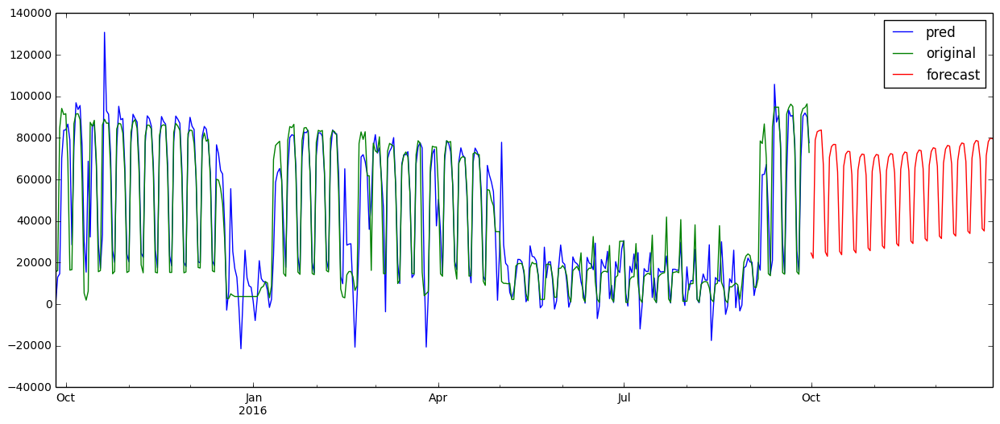

In [190]:
total_forecast = model_building(original_sales, 'Total')

# Plot.
total_pred = total_forecast.predict()
forecast_90 = total_forecast.forecast(steps=90)

total_pred.plot(label='pred')
original_sales.plot(label='original')
forecast_90.plot(label='forecast')
plt.legend()

# Plots to compare diff models.

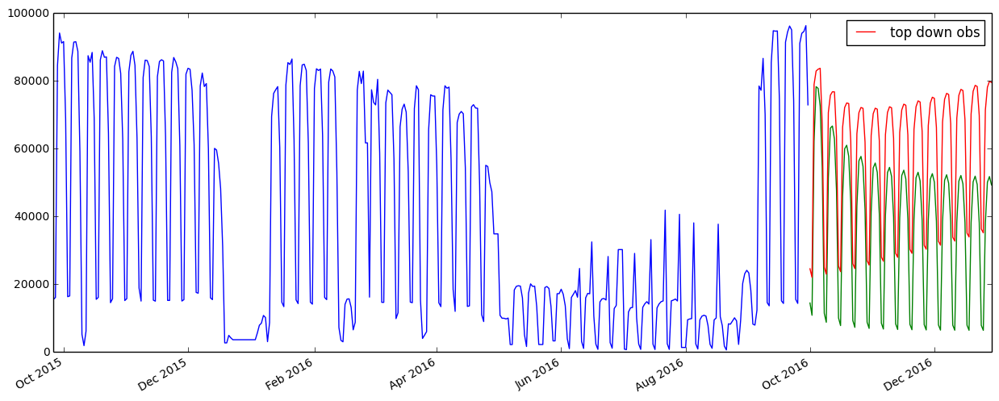

In [194]:
sum_forecast_inv = sum_forecast(forecast_inv) # Bottom up approach, order 0.
# forecast_90_inversed.plot(label='top down inverse') # Top down, order 0.
forecast_90.plot(label='top down obs') # Top down, order 1.
# forecast_90_inversed_order_1.plot(label='order 1')
plt.legend()

# Averaging models.

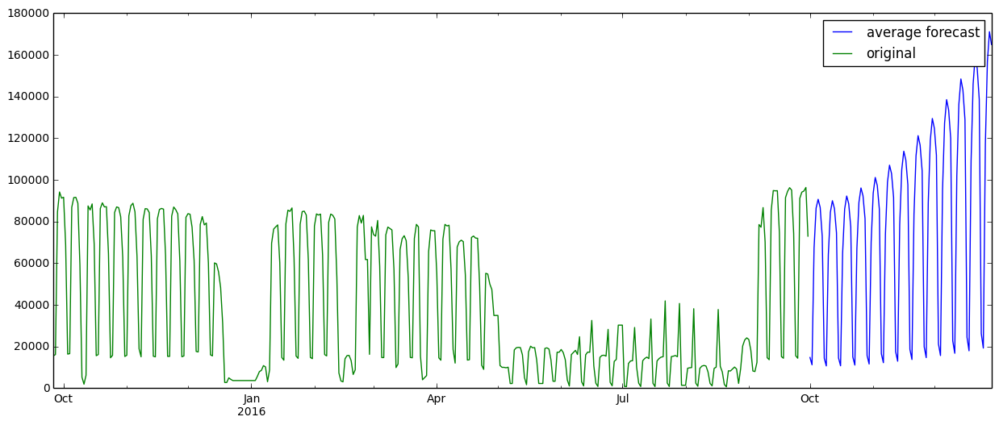

In [189]:
avg_forecast = (sum_forecast_inv + forecast_90_inversed_order_1) / 2
avg_forecast.plot(label='average forecast')
original_sales.plot(label='original')
plt.legend()

In [127]:
print 'Observed: ', rmse_measurement(original_sales, total_pred, 'Total')
print 'Inversed: ', rmse_measurement(original_sales, total_pred_inversed, 'Total')

Observed:  14352.9738171
Inversed:  17804.5435246


# Summary
## 1) Statistical tests suggest
### - We have lags and seasonal effects in the data
### - So we need to use seasonal ARIMA model as opposed to regular ARIMA model
### - The SARIMA models for each category will be slightly different, but shouldn't deviate too much from order 1
## 2) SARIMA models were used for forecasting each category
### - Category E: (1, 1, 1)x(0, 1, 1, 7)
### - Category M: (0, 1, 1)x(1, 1, 1, 7)
### - All other categories: (1, 1, 1)x(1, 1, 1, 7)
## 3) We also used a top down approach (directly forecast without breaking down the categories)
### - Top down approach (RMSE=14,958)
### - Bottom up approach (RMSE=17,118)
### - Seems like top down was able to generalize the time series better, it's interesting because one would expect the opposite
### - But it could be the top down method is overfitting, so further validation is needed.
## 4) What could be improved?
### - More data: if we have 5 years of data, we can definitely build more accurate models.
### - More features: we could use weather data to see how climate affects sales in diff categories
### - More features: also features like promotion or not, number of competitors nearby would also help
### - Diff models: we could try xgboost